### Shapes

In [1]:
from atlite.gis import ExclusionContainer
from atlite.gis import shape_availability
import atlite
import rasterio as rio
from rasterio.plot import show
import geopandas as gpd
import pandas as pd
import numpy as np
import xarray as xr
import os
import matplotlib.pyplot as plt
import country_converter as coco
import pypsa
import rasterio.crs as crs
import cartopy
import cartopy.crs as ccrs

In [2]:
# Projection to use for all calculations
# ESRI:102033: South_America_Albers_Equal_Area_Conic
#c = "ESRI:102033"
c = "EPSG:32719"
#c = "EPSG:8951"


#### Splitting Chile into regions

In [3]:
chile_regions = gpd.read_file("./data/chile_regions.gpkg")
chile_regions

,GID_0,GID_1,COUNTRY,NAME_1,geometry
0,CHL,CHL.2_1,Chile,Antofagasta,"MULTIPOLYGON (((-70.69986 -25.89208, -70.69984..."
1,CHL,CHL.3_1,Chile,Araucanía,"MULTIPOLYGON (((-71.43538 -38.98652, -71.43437..."
2,CHL,CHL.4_1,Chile,Arica y Parinacota,"MULTIPOLYGON (((-69.28189 -17.96854, -69.28175..."
3,CHL,CHL.5_1,Chile,Atacama,"MULTIPOLYGON (((-71.26113 -28.49285, -71.26112..."
4,CHL,CHL.1_1,Chile,Aysén del General Ibañez del Cam,"MULTIPOLYGON (((-75.57556 -48.75867, -75.57551..."
5,CHL,CHL.6_1,Chile,Bío-Bío,"MULTIPOLYGON (((-73.94790 -38.31745, -73.94726..."
6,CHL,CHL.7_1,Chile,Coquimbo,"MULTIPOLYGON (((-70.54495 -31.31045, -70.54525..."
7,CHL,CHL.8_1,Chile,Libertador General Bernardo O'Hi,"MULTIPOLYGON (((-71.54829 -34.87441, -71.54867..."
8,CHL,CHL.9_1,Chile,Los Lagos,"MULTIPOLYGON (((-74.73979 -43.51976, -74.73973..."
9,CHL,CHL.10_1,Chile,Los Ríos,"MULTIPOLYGON (((-71.88819 -40.55778, -71.88676..."


In [4]:
# chile_regions.explore()

#### Aggregate land regions and add EEZ regions

In [4]:
from sklearn.cluster import AgglomerativeClustering 

In [6]:
def aggregate_regions(geodataframe, num_regions):
    # use clustering algorithms K-means to create clusters
    ## extract coordinates for KMeans clustering
    coords = np.array(list(geodataframe.geometry.centroid.apply(lambda point: [point.x, point.y])))
    ## create clusters of regions
    # Create clusters of regions using Agglomerative Clustering
    agglomerative = AgglomerativeClustering(n_clusters=num_regions)
    geodataframe["cluster"] = agglomerative.fit_predict(coords)

    # aggregate regions by clusters
    geodataframe = geodataframe.dissolve(by="cluster")
    #geodataframe.NAME_1 = ["Southern","Atacama","Central Chile","Central Northern Chile inkl Santiago","Central Southern Chile"]
    geodataframe.NAME_1 = ["CHL1","CHL2","CHL3","CHL4","CHL5"]
    geodataframe = geodataframe.loc[:, ["NAME_1", "geometry"]].set_index('NAME_1')
    
    return geodataframe

In [7]:
aggregated_regions = aggregate_regions(chile_regions.to_crs(c), 5)
print(aggregated_regions)

                                                 geometry
NAME_1                                                   
CHL1    MULTIPOLYGON (((15477.452 4511870.586, 15492.5...
CHL2    MULTIPOLYGON (((329702.079 7135015.834, 329679...
CHL3    MULTIPOLYGON (((-3699609.917 6228987.474, -369...
CHL4    MULTIPOLYGON (((260883.804 6438511.742, 260877...
CHL5    MULTIPOLYGON (((28029.377 5156023.864, 28051.7...


In [8]:
def get_country_economic_zone(EEZ, country):
    """extract the Exclusive Economic Zone (EEZ) for a chosen country
    INPUT:  EEZ                 - GeoDataFrame of EEZ
            country             - Name of the country in string
    OUTPUT: gpd.GeoDataFrame    - GeoDataFrame of the country's EEZ
    """
    return EEZ.query(f"SOVEREIGN1 == '{country}'")

In [9]:
# load Exclusive economic zones
EEZ_boundaries = gpd.read_file("./data/EEZ_boundaries.gpkg")
EEZ = gpd.read_file("./data/EEZ.gpkg")

In [10]:
# Exclusive economic zone of Chile
## extract Chile's EEZ
chile_EEZ = get_country_economic_zone(EEZ, "Chile").to_crs(c)
chile_EEZ = chile_EEZ.rename(columns = {"GEONAME":"NAME_1"}).loc[:, ["NAME_1", "geometry"]].set_index("NAME_1")

In [11]:
## combine Chile aggregated regions and EEZ
aggregated_regions = pd.concat([aggregated_regions.to_crs(c), chile_EEZ.to_crs(c)])
# drop Easter island of EEZ
aggregated_regions.drop(aggregated_regions.tail(1).index,inplace=True) 

aggregated_regions

,geometry
NAME_1,
CHL1,"MULTIPOLYGON (((15477.452 4511870.586, 15492.5..."
CHL2,"MULTIPOLYGON (((329702.079 7135015.834, 329679..."
CHL3,"MULTIPOLYGON (((-3699609.917 6228987.474, -369..."
CHL4,"MULTIPOLYGON (((260883.804 6438511.742, 260877..."
CHL5,"MULTIPOLYGON (((28029.377 5156023.864, 28051.7..."
Chilean Exclusive Economic Zone,"MULTIPOLYGON (((375671.840 3930670.030, 376164..."
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),"MULTIPOLYGON (((-215484.904 7073177.261, -2153..."


#### Determine the centroids per region

In [12]:
aggregated_centroids = aggregated_regions.copy()
aggregated_centroids["geometry"] = aggregated_centroids["geometry"].centroid
aggregated_centroids

,geometry
NAME_1,
CHL1,POINT (240153.188 4486617.457)
CHL2,POINT (477622.906 7530458.067)
CHL3,POINT (267259.539 6091397.874)
CHL4,POINT (379728.812 6845085.520)
CHL5,POINT (192789.238 5503571.543)
Chilean Exclusive Economic Zone,POINT (-77845.804 5645195.997)
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),POINT (-603196.597 7041706.658)


### Renewable Potentials

#### Land Eligibility Analysis

In [13]:
country_shapes = "./data/country_shapes.geojson"
roads = "./data/roads.gpkg"
airports = "./data/airports.gpkg"
natural_protection_areas = "./data/natural_protection_areas.tif"
elevation = "./data/elevation.nc"
land_cover = "./data/land_cover.tif"

In [14]:
def plot_area(masked, transform, shape, x, y, subplots=0):
    fig, ax = plt.subplots(figsize=(x,y))
    ax = show(masked, transform=transform, cmap='Greens', vmin=0, ax=ax)
    shape.plot(ax=ax, edgecolor='k', color='None', linewidth=1)

In [15]:
def area(masked, excluder, shape):
    excluder_float = float(excluder.res**2)
    return masked.sum() * excluder_float / shape.geometry.area * 100

In [212]:
# Shape of Chile
CHL = gpd.read_file(country_shapes).set_index('name').query("name == 'CL'").to_crs(c).geometry

# Shapes for onshore, offshore and solar
shape_onshore = CHL.geometry 

shape_solar = CHL.geometry

shape_offshore = chile_EEZ.geometry # within EEZ


In [213]:
shape_CL1 = aggregated_regions.query("NAME_1 == 'CHL1'").to_crs(c).geometry
shape_CL2 = aggregated_regions.query("NAME_1 == 'CHL2'").to_crs(c).geometry
shape_CL3 = aggregated_regions.query("NAME_1 == 'CHL3'").to_crs(c).geometry
shape_CL4 = aggregated_regions.query("NAME_1 == 'CHL4'").to_crs(c).geometry
shape_CL5 = aggregated_regions.query("NAME_1 == 'CHL5'").to_crs(c).geometry

In [214]:
shape_offshore1 = aggregated_regions.query("NAME_1 == 'Chilean Exclusive Economic Zone'").to_crs(c).geometry
shape_offshore2 = aggregated_regions.query("NAME_1 == 'Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)'").to_crs(c).geometry
#shape_offshore3 = aggregated_regions.query("NAME_1 == 'Chilean Exclusive Economic Zone (Easter Island)'").to_crs(c).geometry

#### Onshore

In [215]:
excluder_onshore = ExclusionContainer(crs=c)
# 300m distance to major roads
excluder_onshore.add_geometry(roads, buffer=300)
# 10km distance to airports
excluder_onshore.add_geometry(airports, buffer=10000)
# No natural protection areas
excluder_onshore.add_raster(natural_protection_areas, crs=4326)
# Maximum elevation of 2000m
excluder_onshore.add_raster(elevation, codes=lambda x: x>2000, crs=4326)

# 1000m distance to built up areas (i.e. urban land cover class code 50)
excluder_onshore.add_raster(land_cover, codes=[50], buffer=1000, crs=4326)

# Analysis on suitable land cover classes (based on Copernicus document)
## The land cover classes suitable for onshore wind would generally exclude 
## urban, forested (closed forest), agricultural areas with dense canopy, and wetlands, 
## favoring open, non-protected areas.
## Therefore, exclude these code classes 111, 113, 112, 114, 115, 116, 20, 90, 50, 70, 80, 200
excluder_onshore.add_raster(land_cover, codes=[111, 113, 112, 114, 115, 116, 20, 90, 50, 70, 80, 200], buffer=100, crs=c) 


In [33]:
# calculate available area for onshore wind
masked_onshore, transform_onshore = shape_availability(shape_onshore, excluder_onshore)

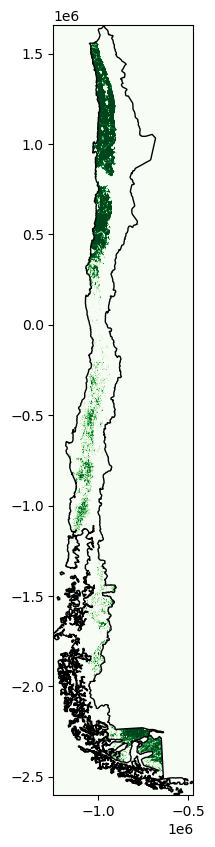

In [34]:
# plot available area for onshore wind
plot_area(masked_onshore, transform_onshore, shape_onshore, 10,10)

In [216]:
masked_onshore_CL1, transform_onshore_CL1 = shape_availability(shape_CL1, excluder_onshore)
masked_onshore_CL2, transform_onshore_CL2 = shape_availability(shape_CL2, excluder_onshore)
masked_onshore_CL3, transform_onshore_CL3 = shape_availability(shape_CL3, excluder_onshore)
masked_onshore_CL4, transform_onshore_CL4 = shape_availability(shape_CL4, excluder_onshore)
masked_onshore_CL5, transform_onshore_CL5 = shape_availability(shape_CL5, excluder_onshore)

In [217]:
area_onshore_chile = []
area_onshore_chile.append(area(masked_onshore_CL1, excluder_onshore, shape_CL1))
area_onshore_chile.append(area(masked_onshore_CL2, excluder_onshore, shape_CL2))
area_onshore_chile.append(area(masked_onshore_CL3, excluder_onshore, shape_CL3))
area_onshore_chile.append(area(masked_onshore_CL4, excluder_onshore, shape_CL4))
area_onshore_chile.append(area(masked_onshore_CL5, excluder_onshore, shape_CL5))


In [218]:

area_onshore_chile = [float(x) for x in area_onshore_chile]
area_onshore_chile

C:\Users\phamt\AppData\Local\Temp\ipykernel_4812\3016651661.py:1: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead



[15.124581756494262,
 37.552793865746956,
 11.873802352267754,
 27.446657794372086,
 13.478618135970674]

In [219]:
while len(area_onshore_chile) < 7:
    area_onshore_chile.append(0.0)


In [220]:
# Area of regions
area_default=(aggregated_regions.to_crs(c).area)/10**6    # km^2
area_default

NAME_1
CHL1                                                                    2.396829e+05
CHL2                                                                    1.829482e+05
CHL3                                                                    1.153623e+05
CHL4                                                                    1.162746e+05
CHL5                                                                    9.832484e+04
Chilean Exclusive Economic Zone                                         2.488190e+06
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)    4.510036e+05
dtype: float64

In [199]:
aggregated_renewables = aggregated_regions.copy()

In [221]:
# Power capacity of onshore wind based on deployment density of 3 MW/km^2

aggregated_renewables['onshore [MW]'] = area_onshore_chile*(area_default/100) * 3   # MW
aggregated_renewables

,geometry,onshore [MW]
NAME_1,,
CHL1,"MULTIPOLYGON (((-1214328.023 -1995026.437, -12...",108753.12
CHL2,"MULTIPOLYGON (((-1016371.146 675402.505, -1016...",206106.48
CHL3,"MULTIPOLYGON (((-4569434.628 -194281.234, -456...",41093.67
CHL4,"MULTIPOLYGON (((-1062555.119 240263.988, -1062...",95740.50
CHL5,"MULTIPOLYGON (((-1210781.717 -1375061.334, -12...",39758.49
Chilean Exclusive Economic Zone,"MULTIPOLYGON (((-808425.879 -2504985.792, -807...",0.00
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),"MULTIPOLYGON (((-1528105.804 584286.120, -1527...",0.00


#### Offshore

In [225]:
excluder_offshore = ExclusionContainer(crs=c)

# No natural protection areas
excluder_offshore.add_raster(natural_protection_areas, crs=4326)

# 10 km minimum distance to shore
excluder_offshore.add_geometry(CHL, buffer=10000)

# Up to water depth of 50m
excluder_offshore.add_raster(elevation, codes=lambda x: x<-50, crs=4326)


In [226]:
masked_offshore_CL1, transform_offshore_CL1 = shape_availability(shape_offshore1, excluder_offshore)

In [227]:
masked_offshore_CL2, transform_offshore_CL2 = shape_availability(shape_offshore2, excluder_offshore)

<Axes: >

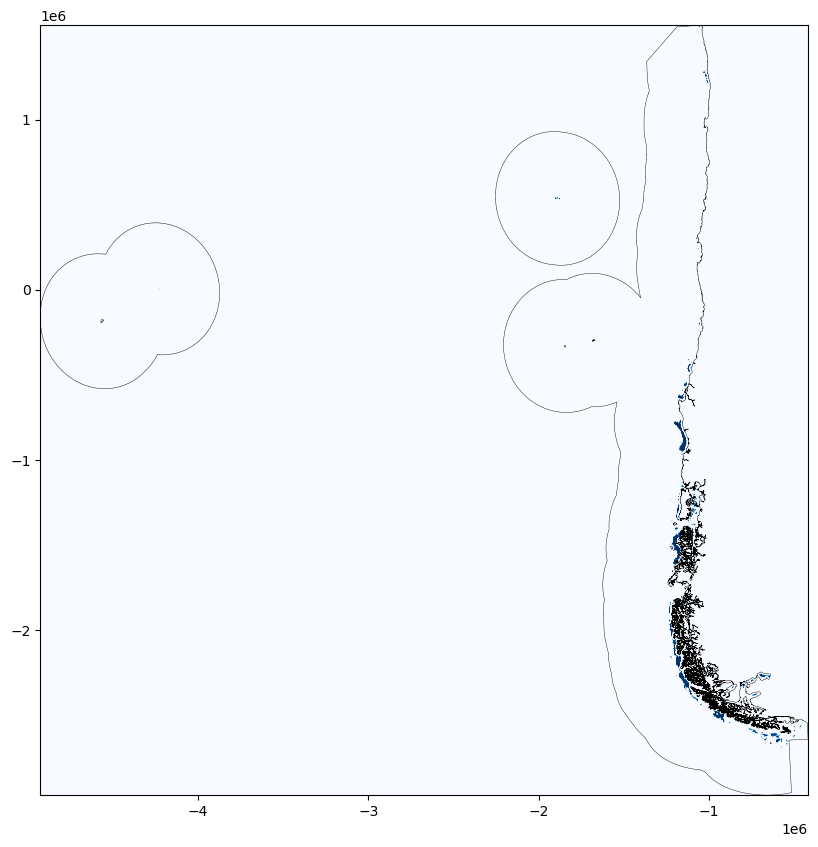

In [25]:

fig, ax = plt.subplots(figsize=(10,10))
ax = show(masked_offshore, transform=transform_offshore, cmap = 'Blues', vmin=0, ax=ax)
shape_offshore.plot(ax=ax, edgecolor='k', color='None', linewidth=0.3)


In [249]:
area_offshore_chile = []
area_offshore_chile.append(area(masked_offshore_CL1, excluder_offshore, shape_offshore1))
area_offshore_chile.append(area(masked_offshore_CL1, excluder_offshore, shape_offshore2))


In [255]:
 
for i in area_offshore_chile:
    area_offshore_chile = float(i)
area_offshore_chile

C:\Users\phamt\AppData\Local\Temp\ipykernel_4812\1532992126.py:2: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead



2.2340931347571718

In [237]:
while len(area_offshore_chile) < 7:
    area_offshore_chile.append(0.0)

In [236]:
# Area of EEZ [km^2]
area_eez=(shape_offshore.area)/10**6    # km^2
area_eez


NAME_1
Chilean Exclusive Economic Zone                                         2.488190e+06
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)    4.510036e+05
Chilean Exclusive Economic Zone (Easter Island)                         7.297685e+05
dtype: float64

In [256]:
# Power capacity of offshore wind based on deployment density of 3 MW/km^2
aggregated_renewables['offshore [MW]']= (area_offshore_chile/100) * area_eez * 3  # MW

aggregated_renewables['offshore [MW]'] = aggregated_renewables['offshore [MW]'].fillna(0)
aggregated_renewables

,geometry,onshore [MW],offshore [MW]
NAME_1,,,
CHL1,"MULTIPOLYGON (((-1214328.023 -1995026.437, -12...",108753.12,0.000000
CHL2,"MULTIPOLYGON (((-1016371.146 675402.505, -1016...",206106.48,0.000000
CHL3,"MULTIPOLYGON (((-4569434.628 -194281.234, -456...",41093.67,0.000000
CHL4,"MULTIPOLYGON (((-1062555.119 240263.988, -1062...",95740.50,0.000000
CHL5,"MULTIPOLYGON (((-1210781.717 -1375061.334, -12...",39758.49,0.000000
Chilean Exclusive Economic Zone,"MULTIPOLYGON (((-808425.879 -2504985.792, -807...",0.00,166765.470807
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),"MULTIPOLYGON (((-1528105.804 584286.120, -1527...",0.00,30227.520000


#### Solar

In [257]:
excluder_solar = ExclusionContainer(crs=c)

# Natural protection areas
excluder_solar.add_raster(natural_protection_areas, crs=4326)

# Analysis on suitable land cover classes
## The land cover classes suitable for solar (rooftop and utility) would generally exclude 
## forested, agricultural areas with dense canopy, and wetlands, 
## favoring open, non-protected areas.
## Therefore, exclude these code classes 111, 113, 112, 114, 115, 116, 121, 123, 122, 124, 125, 126, 20, 90, 70, 80, 200

excluder_solar.add_raster(land_cover, codes=[111, 113, 112, 114, 115, 116, 121, 123, 122, 124, 125, 126, 20, 90, 70, 80, 200], buffer=100, crs=c)



In [258]:
masked_solar, transform_solar = shape_availability(shape_solar, excluder_solar)


<Axes: >

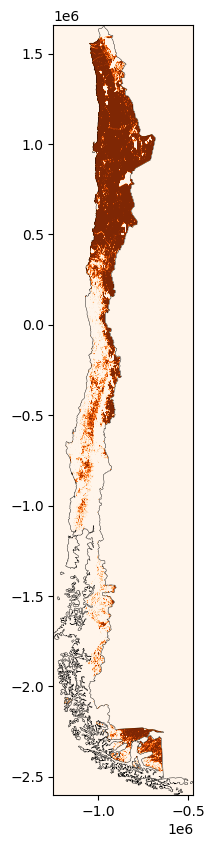

In [55]:
fig, ax = plt.subplots(figsize=(10,10))
ax = show(masked_solar, transform=transform_solar, cmap = 'Oranges', vmin=0, ax=ax)
shape_solar.plot(ax=ax, edgecolor='k', color='None', linewidth=0.3)

In [259]:
# Single regions for solar availability
masked_solar_CL1, transform_solar_CL1 = shape_availability(shape_CL1, excluder_solar)
masked_solar_CL2, transform_solar_CL2 = shape_availability(shape_CL2, excluder_solar)
masked_solar_CL3, transform_solar_CL3 = shape_availability(shape_CL3, excluder_solar)
masked_solar_CL4, transform_solar_CL4 = shape_availability(shape_CL4, excluder_solar)
masked_solar_CL5, transform_solar_CL5 = shape_availability(shape_CL5, excluder_solar)

In [260]:
area_solar_chile = []
area_solar_chile.append(area(masked_solar_CL1, excluder_solar, shape_CL1))
area_solar_chile.append(area(masked_solar_CL2, excluder_solar, shape_CL2))
area_solar_chile.append(area(masked_solar_CL3, excluder_solar, shape_CL3))
area_solar_chile.append(area(masked_solar_CL4, excluder_solar, shape_CL4))
area_solar_chile.append(area(masked_solar_CL5, excluder_solar, shape_CL5))


In [261]:
area_solar_chile = [float(x) for x in area_solar_chile]
area_solar_chile

C:\Users\phamt\AppData\Local\Temp\ipykernel_4812\57493657.py:1: FutureWarning:

Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead



[15.067906880799603,
 87.13160391354653,
 28.808435353286615,
 71.18742882732816,
 9.617193170769635]

In [262]:
while len(area_solar_chile) < 7:
    area_solar_chile.append(0.0)

In [264]:
# Power capacity of solar based on deployment density of 3 MW/km^2
aggregated_renewables['solar [MW]'] = area_solar_chile*(area_default/100) * 3   # MW
aggregated_renewables

,geometry,onshore [MW],offshore [MW],solar [MW]
NAME_1,,,,
CHL1,"MULTIPOLYGON (((-1214328.023 -1995026.437, -12...",108753.12,0.000000,108345.60
CHL2,"MULTIPOLYGON (((-1016371.146 675402.505, -1016...",206106.48,0.000000,478217.10
CHL3,"MULTIPOLYGON (((-4569434.628 -194281.234, -456...",41093.67,0.000000,99702.21
CHL4,"MULTIPOLYGON (((-1062555.119 240263.988, -1062...",95740.50,0.000000,248318.76
CHL5,"MULTIPOLYGON (((-1210781.717 -1375061.334, -12...",39758.49,0.000000,28368.27
Chilean Exclusive Economic Zone,"MULTIPOLYGON (((-808425.879 -2504985.792, -807...",0.00,166765.470807,0.00
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),"MULTIPOLYGON (((-1528105.804 584286.120, -1527...",0.00,30227.520000,0.00


In [266]:


aggregated_regions = aggregated_regions.drop(columns="solar [MW]")

### Weather Data

In [40]:
minx, miny, maxx, maxy = chile_regions.total_bounds
buffer = 0.25

In [46]:
cutout = atlite.Cutout(
   path=".\data\era5-2020-CL.nc",
   module="era5",
   x=slice(minx-buffer, maxx+buffer),
   y=slice(miny-buffer, maxy+buffer),
   time="2020",
)

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\atlite\cutout.py:190: UserWarning:

Arguments module, x, y, time are ignored, since cutout is already built.



In [47]:
cutout.data

<xarray.Dataset>
Dimensions:           (x: 174, y: 156, time: 8784)
Coordinates:
  * x                 (x) float64 -109.5 -109.2 -109.0 ... -66.75 -66.5 -66.25
  * y                 (y) float64 -56.0 -55.75 -55.5 ... -17.75 -17.5 -17.25
  * time              (time) datetime64[ns] 2020-01-01 ... 2020-12-31T23:00:00
    lon               (x) float64 dask.array<chunksize=(174,), meta=np.ndarray>
    lat               (y) float64 dask.array<chunksize=(156,), meta=np.ndarray>
Data variables: (12/13)
    height            (y, x) float32 dask.array<chunksize=(156, 174), meta=np.ndarray>
    wnd100m           (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    wnd_azimuth       (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    roughness         (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    influx_toa        (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    influx_direct     (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    ...                ...
    albedo            (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    solar_altitude    (time, y, x) float64 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    solar_azimuth     (time, y, x) float64 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    temperature       (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    soil temperature  (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
    runoff            (time, y, x) float32 dask.array<chunksize=(100, 156, 174), meta=np.ndarray>
Attributes:
    module:             era5
    prepared_features:  ['height', 'temperature', 'influx', 'runoff', 'wind']
    chunksize_time:     100
    Conventions:        CF-1.6
    history:            2024-01-23 10:12:34 GMT by grib_to_netcdf-2.25.1: /op...

In [48]:
cutout.prepared_features

module  feature    
era5    height                   height
        wind                    wnd100m
        wind                wnd_azimuth
        wind                  roughness
        influx               influx_toa
        influx            influx_direct
        influx           influx_diffuse
        influx                   albedo
        influx           solar_altitude
        influx            solar_azimuth
        temperature         temperature
        temperature    soil temperature
        runoff                   runoff
dtype: object

In [49]:
# For both wind and solar, assume a deployment density of 3 MW/km2
cap_per_sqkm = 3 # MW/km2
area = cutout.grid.set_index(['y', 'x']).to_crs(c).area / 1e6
area = xr.DataArray(area, dims=('spatial'))
area

<xarray.DataArray (spatial: 27144)>
array([434.18542863, 434.18542863, 434.18542863, ..., 735.57923544,
       735.57917734, 735.57911937])
Coordinates:
  * spatial  (spatial) object MultiIndex
  * y        (spatial) float64 -56.0 -56.0 -56.0 -56.0 ... -17.25 -17.25 -17.25
  * x        (spatial) float64 -109.5 -109.2 -109.0 ... -66.75 -66.5 -66.25

#### Onshore wind - Vestast V112 3MW

In [50]:
regions = aggregate_regions(chile_regions.to_crs(c), 5)
regions

,geometry
NAME_1,
CHL1,"MULTIPOLYGON (((-1214328.023 -1995026.437, -12..."
CHL2,"MULTIPOLYGON (((-1016371.146 675402.505, -1016..."
CHL3,"MULTIPOLYGON (((-4569434.628 -194281.234, -456..."
CHL4,"MULTIPOLYGON (((-1062555.119 240263.988, -1062..."
CHL5,"MULTIPOLYGON (((-1210781.717 -1375061.334, -12..."


In [70]:
A_onshore = cutout.availabilitymatrix(regions, excluder_onshore)

Compute availability matrix:   0%|          | 0/5 [00:00<?, ? gridcells/s]

Compute availability matrix: 100%|██████████| 5/5 [04:34<00:00, 54.96s/ gridcells]


In [71]:
capacity_matrix_onshore = A_onshore.stack(spatial=['y', 'x']) * area * cap_per_sqkm
capacity_matrix_onshore

<xarray.DataArray (NAME_1: 5, spatial: 27144)>
array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])
Coordinates:
  * NAME_1   (NAME_1) object 'CHL1' 'CHL2' 'CHL3' 'CHL4' 'CHL5'
  * spatial  (spatial) object MultiIndex
  * y        (spatial) float64 -56.0 -56.0 -56.0 -56.0 ... -17.25 -17.25 -17.25
  * x        (spatial) float64 -109.5 -109.2 -109.0 ... -66.75 -66.5 -66.25

In [82]:
wind = cutout.wind(
    atlite.windturbines.Vestas_V112_3MW,
    matrix=capacity_matrix_onshore,
    index=regions.index,
    per_unit=True,
)

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\atlite\resource.py:72: FutureWarning:

'add_cutout_windspeed' for wind turbine
power curves will default to True in atlite relase v0.2.13.



[########################################] | 100% Completed | 106.94 s


#### Solar panel - CdTe

In [51]:
A_solar = cutout.availabilitymatrix(regions, excluder_solar)

Compute availability matrix: 100%|██████████| 5/5 [02:37<00:00, 31.44s/ gridcells]


In [52]:
capacity_matrix_solar = A_solar.stack(spatial=['y', 'x']) * area * cap_per_sqkm

In [53]:
pv = cutout.pv(
    panel=atlite.solarpanels.CdTe,
    matrix=capacity_matrix_solar,
    orientation='latitude_optimal',
    index=regions.index,
    per_unit=True,
)

[########################################] | 100% Completed | 511.01 s


##### Offshore wind - NREL ReferenceTurbine 5MW offshore


In [143]:
chile_EEZ1 = chile_EEZ.query("NAME_1 == 'Chilean Exclusive Economic Zone'").to_crs(c)
chile_EEZ1

,geometry
NAME_1,
Chilean Exclusive Economic Zone,"MULTIPOLYGON (((-808425.879 -2504985.792, -807..."


In [145]:
chile_EEZ2 = chile_EEZ.query("NAME_1 == 'Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)'").to_crs(c)
chile_EEZ3 = chile_EEZ.query("NAME_1 == 'Chilean Exclusive Economic Zone (Easter Island)'").to_crs(c)

In [151]:

A_offshore1 = cutout.availabilitymatrix(chile_EEZ1, excluder_offshore)

Compute availability matrix: 100%|██████████| 1/1 [02:49<00:00, 169.91s/ gridcells]


In [152]:
capacity_matrix_offshore1 = A_offshore1.stack(spatial=['y', 'x']) * area * cap_per_sqkm

In [153]:
offshore1 = cutout.wind(
    atlite.windturbines.NREL_ReferenceTurbine_5MW_offshore,
    matrix=capacity_matrix_offshore1,
    index=chile_EEZ1.index,
    per_unit=True,
)

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\atlite\resource.py:72: FutureWarning:

'add_cutout_windspeed' for wind turbine
power curves will default to True in atlite relase v0.2.13.

INFO:atlite.convert:Convert and aggregate 'wind'.


[########################################] | 100% Completed | 106.44 s


In [154]:
# capacity factor time series of offshore wind
df_offshore1 = offshore1.to_pandas()
df_offshore1

NAME_1,Chilean Exclusive Economic Zone
time,
2020-01-01 00:00:00,0.579287
2020-01-01 01:00:00,0.558121
2020-01-01 02:00:00,0.543530
2020-01-01 03:00:00,0.544741
2020-01-01 04:00:00,0.551598
...,...
2020-12-31 19:00:00,0.523647
2020-12-31 20:00:00,0.522905
2020-12-31 21:00:00,0.502467


In [99]:
df_offshore1.to_csv(r".\data\df_offshore1.csv")

In [146]:
A_offshore2 = cutout.availabilitymatrix(chile_EEZ2, excluder_offshore)

Compute availability matrix: 100%|██████████| 1/1 [00:05<00:00,  5.65s/ gridcells]


In [147]:
capacity_matrix_offshore2 = A_offshore2.stack(spatial=['y', 'x']) * area * cap_per_sqkm

In [148]:
offshore2 = cutout.wind(
    atlite.windturbines.NREL_ReferenceTurbine_5MW_offshore,
    matrix=capacity_matrix_offshore2,
    index=chile_EEZ2.index,
    per_unit=True,
)

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\atlite\resource.py:72: FutureWarning:

'add_cutout_windspeed' for wind turbine
power curves will default to True in atlite relase v0.2.13.

INFO:atlite.convert:Convert and aggregate 'wind'.


[########################################] | 100% Completed | 108.21 s


In [149]:
# capacity factor time series of offshore wind
df_offshore2 = offshore2.to_pandas()
df_offshore2

NAME_1,Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)
time,
2020-01-01 00:00:00,0.372020
2020-01-01 01:00:00,0.390848
2020-01-01 02:00:00,0.403911
2020-01-01 03:00:00,0.396479
2020-01-01 04:00:00,0.368499
...,...
2020-12-31 19:00:00,0.355648
2020-12-31 20:00:00,0.391265
2020-12-31 21:00:00,0.403661


## Model Initialisation

In [13]:
aggregated_points = aggregated_regions.copy()
aggregated_points = aggregated_points.representative_point()
aggregated_points = aggregated_points.to_crs(c).reset_index()
aggregated_points.columns.values[1] = "geometry"
aggregated_points["longitude"] = aggregated_points["geometry"].x
aggregated_points["latitude"] = aggregated_points["geometry"].y
aggregated_points


,NAME_1,geometry,longitude,latitude
0,CHL1,POINT (186704.672 4593435.451),186704.671870,4.593435e+06
1,CHL2,POINT (489140.736 7590837.330),489140.736379,7.590837e+06
2,CHL3,POINT (273793.679 6093347.500),273793.678508,6.093348e+06
3,CHL4,POINT (349582.026 6815375.300),349582.026250,6.815375e+06
4,CHL5,POINT (172218.471 5475460.654),172218.470535,5.475461e+06
5,Chilean Exclusive Economic Zone,POINT (-84508.931 5667718.688),-84508.931124,5.667719e+06
6,Chilean Exclusive Economic Zone (San Felix and...,POINT (-412165.382 7041768.524),-412165.381967,7.041769e+06


In [14]:
# technology
year = 2050
url = f"https://raw.githubusercontent.com/PyPSA/technology-data/master/outputs/costs_{year}.csv"
costs = pd.read_csv(url, index_col=[0, 1])
costs

value  \
technology                        parameter                      
Ammonia cracker                   FOM                   4.3000   
                                  ammonia-input         1.4600   
                                  investment       527592.2200   
                                  lifetime             25.0000   
Battery electric (passenger cars) FOM                   0.9000   
...                                                        ...   
waste CHP CC                      efficiency-heat       0.7625   
                                  investment         7068.8867   
                                  lifetime             25.0000   
water tank charger                efficiency            0.8367   
water tank discharger             efficiency            0.8367   

                                                             unit  \
technology                        parameter                         
Ammonia cracker                   FOM                      %/year   
                                  ammonia-input    MWh_NH3/MWh_H2   
                                  investment            EUR/MW_H2   
                                  lifetime                  years   
Battery electric (passenger cars) FOM                           %   
...                                                           ...   
waste CHP CC                      efficiency-heat        per unit   
                                  investment             EUR/kW_e   
                                  lifetime                  years   
water tank charger                efficiency             per unit   
water tank discharger             efficiency             per unit   

                                                                                              source  \
technology                        parameter                                                            
Ammonia cracker                   FOM              Ishimoto et al. (2020): 10.1016/j.ijhydene.202...   
                                  ammonia-input    ENGIE et al (2020): Ammonia to Green Hydrogen ...   
                                  investment       Ishimoto et al. (2020): 10.1016/j.ijhydene.202...   
                                  lifetime         Ishimoto et al. (2020): 10.1016/j.ijhydene.202...   
Battery electric (passenger cars) FOM              PATHS TO A CLIMATE-NEUTRAL ENERGY SYSTEM The G...   
...                                                                                              ...   
waste CHP CC                      efficiency-heat  Danish Energy Agency, technology_data_for_el_a...   
                                  investment       Danish Energy Agency, technology_data_for_el_a...   
                                  lifetime         Danish Energy Agency, technology_data_for_el_a...   
water tank charger                efficiency       Danish Energy Agency, technology_data_catalogu...   
water tank discharger             efficiency       Danish Energy Agency, technology_data_catalogu...   

                                                                                 further description  
technology                        parameter                                                           
Ammonia cracker                   FOM              Estimated based on Labour cost rate, Maintenan...  
                                  ammonia-input    Assuming a integrated 200t/d cracking and puri...  
                                  investment       Calculated. For a small (200 t_NH3/d input) fa...  
                                  lifetime                                                       NaN  
Battery electric (passenger cars) FOM                              Battery electric (passenger cars)  
...                                                                                              ...  
waste CHP CC                      efficiency-heat  08 WtE CHP, Large, 50 degree:  Heat efficiency...  
                    

In [15]:
costs.loc[costs.unit.str.contains("/kW"), "value"] *= 1e3
costs.unit = costs.unit.str.replace("/kW", "/MW")

defaults = {
    "FOM": 0,
    "VOM": 0,
    "efficiency": 1,
    "fuel": 0,
    "investment": 0,
    "lifetime": 25,
    "discount rate": 0.07,
}
costs = costs.value.unstack().fillna(defaults)


In [16]:
costs.at["petcoke", "fuel"] = costs.at["oil", "fuel"]
costs.at["petcoke", "fuel"] = costs.at["oil", "fuel"]
costs.at["petcoke", "CO2 intensity"] = costs.at["oil", "CO2 intensity"]
costs.at["petcoke", "CO2 intensity"] = costs.at["oil", "CO2 intensity"]

In [17]:
# Annuity
def annuity(r, n):
    return r / (1.0 - 1.0 / (1.0 + r) ** n)

In [18]:
# Marginal cost,  €/MWh
costs["marginal_cost"] = costs["VOM"] + costs["fuel"] / costs["efficiency"] 

In [19]:
# Capital cost, €/MW/a
annuity = costs.apply(lambda x: annuity(x["discount rate"], x["lifetime"]), axis=1)
costs["capital_cost"] = (annuity + costs["FOM"] / 100) * costs["investment"]

In [20]:
# Data of the fleet of existing power plants
pwp = pd.read_csv(".\data\global_power_plant_database.csv", index_col=0, parse_dates=True)
pwp

C:\Users\phamt\AppData\Local\Temp\ipykernel_24520\861857469.py:2: DtypeWarning:

Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.

C:\Users\phamt\AppData\Local\Temp\ipykernel_24520\861857469.py:2: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,other_fuel3,...,estimated_generation_gwh_2013,estimated_generation_gwh_2014,estimated_generation_gwh_2015,estimated_generation_gwh_2016,estimated_generation_gwh_2017,estimated_generation_note_2013,estimated_generation_note_2014,estimated_generation_note_2015,estimated_generation_note_2016,estimated_generation_note_2017
country,,,,,,,,,,,,,,,,,,,,,
AFG,Afghanistan,Kajaki Hydroelectric Power Plant Afghanistan,GEODB0040538,33.0,32.3220,65.1190,Hydro,NaN,NaN,NaN,...,123.77,162.90,97.39,137.76,119.50,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1
AFG,Afghanistan,Kandahar DOG,WKS0070144,10.0,31.6700,65.7950,Solar,NaN,NaN,NaN,...,18.43,17.48,18.25,17.70,18.29,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE
AFG,Afghanistan,Kandahar JOL,WKS0071196,10.0,31.6230,65.7920,Solar,NaN,NaN,NaN,...,18.64,17.58,19.10,17.62,18.72,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE
AFG,Afghanistan,Mahipar Hydroelectric Power Plant Afghanistan,GEODB0040541,66.0,34.5560,69.4787,Hydro,NaN,NaN,NaN,...,225.06,203.55,146.90,230.18,174.91,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1
AFG,Afghanistan,Naghlu Dam Hydroelectric Power Plant Afghanistan,GEODB0040534,100.0,34.6410,69.7170,Hydro,NaN,NaN,NaN,...,406.16,357.22,270.99,395.38,350.80,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZMB,Zambia,Ndola,WRI1022386,50.0,-12.9667,28.6333,Oil,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,183.79,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1
ZMB,Zambia,Nkana,WRI1022384,20.0,-12.8167,28.2000,Oil,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,73.51,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1
ZMB,Zambia,Victoria Falls,WRI1022380,108.0,-17.9167,25.8500,Hydro,NaN,NaN,NaN,...,575.78,575.78,548.94,579.90,578.32,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1


In [21]:
 # Power plants in Chile
geometry = gpd.points_from_xy(pwp["longitude"], pwp["latitude"])
pwp_gdf = gpd.GeoDataFrame(pwp, geometry=geometry, crs=c)
pwp_chile = pwp_gdf.query("country_long =='Chile'")
pwp_chile = pwp_chile.set_geometry("geometry")

In [22]:
pwp_chile

,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,other_fuel3,...,estimated_generation_gwh_2014,estimated_generation_gwh_2015,estimated_generation_gwh_2016,estimated_generation_gwh_2017,estimated_generation_note_2013,estimated_generation_note_2014,estimated_generation_note_2015,estimated_generation_note_2016,estimated_generation_note_2017,geometry
country,,,,,,,,,,,,,,,,,,,,,
CHL,Chile,ABANICO,CHL0001001,136.00,-37.3646,-71.4894,Hydro,NaN,NaN,NaN,...,345.75,445.18,298.28,397.04,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-71.489 -37.365)
CHL,Chile,AGUAS BLANCAS,CHL0000001,2.00,-24.1355,-69.8649,Oil,NaN,NaN,NaN,...,NaN,NaN,NaN,1.17,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1,POINT (-69.865 -24.136)
CHL,Chile,ALFALFAL,CHL0001002,178.00,-33.5012,-70.1927,Hydro,NaN,NaN,NaN,...,411.66,562.38,450.43,531.66,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-70.193 -33.501)
CHL,Chile,ALLIPEN,CHL0001003,3.00,-38.9987,-72.2230,Hydro,NaN,NaN,NaN,...,10.32,11.37,9.21,11.71,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-72.223 -38.999)
CHL,Chile,ALTO BAGUALES,CHL0002001,1.98,-45.5260,-72.1046,Wind,NaN,NaN,NaN,...,NaN,NaN,NaN,5.49,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1,POINT (-72.105 -45.526)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CHL,Chile,VENTANAS,CHL0000126,322.00,-32.7493,-71.4812,Coal,NaN,NaN,NaN,...,NaN,NaN,NaN,1776.47,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1,POINT (-71.481 -32.749)
CHL,Chile,VOLCAN,CHL0001125,13.00,-33.8206,-70.2148,Hydro,NaN,NaN,NaN,...,38.23,49.61,42.35,49.12,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-70.215 -33.821)
CHL,Chile,Valleland II+III,WKS0062354,60.00,-28.1550,-70.6850,Solar,NaN,NaN,NaN,...,151.85,152.61,154.75,152.54,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,SOLAR-V1-NO-AGE,POINT (-70.685 -28.155)


In [23]:
# Disregard existing wind and solar capacities
pwp_chile = pwp_chile[~pwp_chile["primary_fuel"].isin(["Wind", "Solar"])]

##### Create converter DF

In [24]:
chile_regions1 = pd.concat([chile_regions.to_crs(c), chile_EEZ.to_crs(c)])
# drop easter island of EEZ
chile_regions1.drop(chile_regions1.tail(1).index,inplace=True) 
chile_regions1 = chile_regions1.reset_index()

# update the last rows for 1 Chile EEZ
chile_regions1.loc[chile_regions1.index[-1], 'index'] = 16
chile_regions1.loc[chile_regions1.index[-1], 'GID_0'] = "CHL"
chile_regions1.loc[chile_regions1.index[-1], 'GID_1'] = "CHL.17_1"
chile_regions1.loc[chile_regions1.index[-1], 'COUNTRY'] = "Chile"
chile_regions1.loc[chile_regions1.index[-1], 'NAME_1'] = "Chilean Exclusive Economic Zone"

chile_regions1.loc[chile_regions1.index[-2], 'index'] = 17
chile_regions1.loc[chile_regions1.index[-2], 'GID_0'] = "CHL"
chile_regions1.loc[chile_regions1.index[-2], 'GID_1'] = "CHL.18_1"
chile_regions1.loc[chile_regions1.index[-2], 'COUNTRY'] = "Chile"
chile_regions1.loc[chile_regions1.index[-2], 'NAME_1'] = "Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)"
chile_regions1

,index,GID_0,GID_1,COUNTRY,NAME_1,geometry
0,0,CHL,CHL.2_1,Chile,Antofagasta,"MULTIPOLYGON (((329711.369 7135164.576, 329714..."
1,1,CHL,CHL.3_1,Chile,Araucanía,"MULTIPOLYGON (((289062.526 5681897.876, 289152..."
2,2,CHL,CHL.4_1,Chile,Arica y Parinacota,"MULTIPOLYGON (((470152.787 8013272.189, 470168..."
3,3,CHL,CHL.5_1,Chile,Atacama,"MULTIPOLYGON (((278668.351 6846116.183, 278669..."
4,4,CHL,CHL.1_1,Chile,Aysén del General Ibañez del Cam,"MULTIPOLYGON (((16867.168 4578481.328, 16873.7..."
5,5,CHL,CHL.6_1,Chile,Bío-Bío,"MULTIPOLYGON (((67341.699 5747363.500, 67398.9..."
6,6,CHL,CHL.7_1,Chile,Coquimbo,"MULTIPOLYGON (((352981.245 6534961.000, 352953..."
7,7,CHL,CHL.8_1,Chile,Libertador General Bernardo O'Hi,"MULTIPOLYGON (((267083.058 6137921.432, 267047..."
8,8,CHL,CHL.9_1,Chile,Los Lagos,"MULTIPOLYGON (((36081.530 5165434.916, 36089.4..."
9,9,CHL,CHL.10_1,Chile,Los Ríos,"MULTIPOLYGON (((255466.436 5506322.354, 255589..."


In [25]:
regions_converter = gpd.sjoin(chile_regions1,aggregated_regions,how="right",predicate="within")
regions_converter = regions_converter.drop(["index_left", "GID_0", "GID_1", "COUNTRY"],axis=1)
regions_converter.rename(columns={"NAME_1": "Regions"}, inplace=True)
regions_converter.reset_index(inplace=True)
regions_converter.rename(columns={"NAME_1": "aggRegions"}, inplace=True)
regions_converter

,aggRegions,index,Regions,geometry
0,CHL1,4,Aysén del General Ibañez del Cam,"MULTIPOLYGON (((15477.452 4511870.586, 15492.5..."
1,CHL1,10,Magallanes y Antártica Chilena,"MULTIPOLYGON (((15477.452 4511870.586, 15492.5..."
2,CHL2,0,Antofagasta,"MULTIPOLYGON (((329702.079 7135015.834, 329679..."
3,CHL2,14,Tarapacá,"MULTIPOLYGON (((329702.079 7135015.834, 329679..."
4,CHL2,2,Arica y Parinacota,"MULTIPOLYGON (((329702.079 7135015.834, 329679..."
5,CHL3,5,Bío-Bío,"MULTIPOLYGON (((-3699609.917 6228987.474, -369..."
6,CHL3,12,Ñuble,"MULTIPOLYGON (((-3699609.917 6228987.474, -369..."
7,CHL3,15,Valparaíso,"MULTIPOLYGON (((-3699609.917 6228987.474, -369..."
8,CHL3,11,Maule,"MULTIPOLYGON (((-3699609.917 6228987.474, -369..."
9,CHL3,7,Libertador General Bernardo O'Hi,"MULTIPOLYGON (((-3699609.917 6228987.474, -369..."


In [32]:
regions_converter = regions_converter.to_crs(c)
pwp_chile = pwp_chile.to_crs(c)

##### Aggregate fossil power plants over different plants of the same type

In [33]:
### Joining Powerplant, Cost and Geographic DataFrames
pwp_chile = gpd.sjoin(pwp_chile,chile_regions, how='left', predicate='within')
pwp_chile

C:\Users\phamt\AppData\Local\Temp\ipykernel_10908\1907777738.py:2: UserWarning:

CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:32719
Right CRS: EPSG:4326




,country_long,name,gppd_idnr,capacity_mw,latitude,longitude,primary_fuel,other_fuel1,other_fuel2,other_fuel3,...,estimated_generation_note_2014,estimated_generation_note_2015,estimated_generation_note_2016,estimated_generation_note_2017,geometry,index_right,GID_0,GID_1,COUNTRY,NAME_1
country,,,,,,,,,,,,,,,,,,,,,
CHL,Chile,ABANICO,CHL0001001,136.0,-37.3646,-71.4894,Hydro,NaN,NaN,NaN,...,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-71.489 -37.365),5.0,CHL,CHL.6_1,Chile,Bío-Bío
CHL,Chile,AGUAS BLANCAS,CHL0000001,2.0,-24.1355,-69.8649,Oil,NaN,NaN,NaN,...,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1,POINT (-69.865 -24.136),0.0,CHL,CHL.2_1,Chile,Antofagasta
CHL,Chile,ALFALFAL,CHL0001002,178.0,-33.5012,-70.1927,Hydro,NaN,NaN,NaN,...,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-70.193 -33.501),13.0,CHL,CHL.14_1,Chile,Santiago Metropolitan
CHL,Chile,ALLIPEN,CHL0001003,3.0,-38.9987,-72.2230,Hydro,NaN,NaN,NaN,...,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-72.223 -38.999),1.0,CHL,CHL.3_1,Chile,Araucanía
CHL,Chile,ANGOL (LOS SAUCES),CHL0000134,1.5,-37.9658,-72.8269,Oil,NaN,NaN,NaN,...,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1,POINT (-72.827 -37.966),1.0,CHL,CHL.3_1,Chile,Araucanía
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CHL,Chile,TRUFULTRUFUL,CHL0001124,1.0,-38.8403,-71.6608,Hydro,NaN,NaN,NaN,...,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-71.661 -38.840),1.0,CHL,CHL.3_1,Chile,Araucanía
CHL,Chile,VENTANAS,CHL0000126,322.0,-32.7493,-71.4812,Coal,NaN,NaN,NaN,...,NO-ESTIMATION,NO-ESTIMATION,NO-ESTIMATION,CAPACITY-FACTOR-V1,POINT (-71.481 -32.749),15.0,CHL,CHL.16_1,Chile,Valparaíso
CHL,Chile,VOLCAN,CHL0001125,13.0,-33.8206,-70.2148,Hydro,NaN,NaN,NaN,...,HYDRO-V1,HYDRO-V1,HYDRO-V1,HYDRO-V1,POINT (-70.215 -33.821),13.0,CHL,CHL.14_1,Chile,Santiago Metropolitan


In [34]:
pwp_chile["p_max_pu"] = pwp_chile.estimated_generation_gwh_2017*(1e3)/8760/pwp_chile.capacity_mw
pwp_chile["p_max_pu"]

country
CHL    0.333266
CHL    0.066781
CHL    0.340965
CHL    0.445586
CHL    0.066210
         ...   
CHL    0.380137
CHL    0.629793
CHL    0.431331
CHL    0.066591
CHL    0.066790
Name: p_max_pu, Length: 220, dtype: float64

In [35]:
pwp_chile["Weighted_Regional_Capacity"] = 0
grouped_sum = pwp_chile.groupby(["NAME_1", "primary_fuel"])["capacity_mw"].transform('sum')
pwp_chile["Weighted_Regional_Capacity"] = (pwp_chile['p_max_pu'] * pwp_chile['capacity_mw']) / grouped_sum
pwp_chile["Weighted_Regional_Capacity"]

country
CHL    0.015864
CHL    0.000966
CHL    0.163150
CHL    0.037132
CHL    0.007197
         ...   
CHL    0.010559
CHL    0.208233
CHL    0.015073
CHL    0.001236
CHL    0.028111
Name: Weighted_Regional_Capacity, Length: 220, dtype: float64

In [36]:
# Aggregate Capacity Factors
aggregated_plants_cf = pwp_chile.groupby(["NAME_1","primary_fuel"])["Weighted_Regional_Capacity"].sum().unstack().fillna(0)
aggregated_plants_capacity = pwp_chile.groupby(["NAME_1","primary_fuel"])["capacity_mw"].sum().unstack().fillna(0)
aggregated_plants_capacity

primary_fuel,Biomass,Coal,Gas,Hydro,Oil,Petcoke
NAME_1,,,,,,
Antofagasta,0.0,747.6000,1012.200000,0.0,138.200000,0.0000
Araucanía,81.0,0.0000,0.000000,36.0,13.800000,0.0000
Arica y Parinacota,0.0,0.0000,0.000000,10.0,14.200000,0.0000
Atacama,0.0,760.0000,0.000000,5.0,511.301450,0.0000
Bío-Bío,168.2,819.9910,61.157689,2857.0,473.049478,62.9775
Coquimbo,0.0,0.0000,0.000000,29.0,354.647000,0.0000
Libertador General Bernardo O'Hi,15.6,0.0000,253.900000,949.0,43.400000,0.0000
Los Lagos,0.0,0.0000,0.000000,288.0,161.600000,0.0000
Los Ríos,0.0,0.0000,0.000000,122.0,117.200000,0.0000


In [37]:
aggregated_plants_cf.reset_index(inplace=True)
aggregated_plants_capacity.reset_index(inplace=True)

In [38]:
# ### Collapse Aggregated_Plants Data to five region level
aggregated_plants_cf = pd.merge(aggregated_plants_cf, chile_regions1, on="NAME_1", how="inner")
aggregated_plants_capacity = pd.merge(aggregated_plants_capacity, chile_regions1, on="NAME_1", how="inner")
aggregated_plants_capacity

,NAME_1,Biomass,Coal,Gas,Hydro,Oil,Petcoke,index,GID_0,GID_1,COUNTRY,geometry
0,Antofagasta,0.0,747.6000,1012.200000,0.0,138.200000,0.0000,0,CHL,CHL.2_1,Chile,"MULTIPOLYGON (((329711.369 7135164.576, 329714..."
1,Araucanía,81.0,0.0000,0.000000,36.0,13.800000,0.0000,1,CHL,CHL.3_1,Chile,"MULTIPOLYGON (((289062.526 5681897.876, 289152..."
2,Arica y Parinacota,0.0,0.0000,0.000000,10.0,14.200000,0.0000,2,CHL,CHL.4_1,Chile,"MULTIPOLYGON (((470152.787 8013272.189, 470168..."
3,Atacama,0.0,760.0000,0.000000,5.0,511.301450,0.0000,3,CHL,CHL.5_1,Chile,"MULTIPOLYGON (((278668.351 6846116.183, 278669..."
4,Bío-Bío,168.2,819.9910,61.157689,2857.0,473.049478,62.9775,5,CHL,CHL.6_1,Chile,"MULTIPOLYGON (((67341.699 5747363.500, 67398.9..."
5,Coquimbo,0.0,0.0000,0.000000,29.0,354.647000,0.0000,6,CHL,CHL.7_1,Chile,"MULTIPOLYGON (((352981.245 6534961.000, 352953..."
6,Libertador General Bernardo O'Hi,15.6,0.0000,253.900000,949.0,43.400000,0.0000,7,CHL,CHL.8_1,Chile,"MULTIPOLYGON (((267083.058 6137921.432, 267047..."
7,Los Lagos,0.0,0.0000,0.000000,288.0,161.600000,0.0000,8,CHL,CHL.9_1,Chile,"MULTIPOLYGON (((36081.530 5165434.916, 36089.4..."
8,Los Ríos,0.0,0.0000,0.000000,122.0,117.200000,0.0000,9,CHL,CHL.10_1,Chile,"MULTIPOLYGON (((255466.436 5506322.354, 255589..."
9,Maule,14.0,2.0000,0.000000,1592.0,87.414000,0.0000,11,CHL,CHL.12_1,Chile,"MULTIPOLYGON (((269060.136 6137763.884, 269062..."


In [39]:
aggregated_plants_cf = gpd.GeoDataFrame(aggregated_plants_cf,geometry=aggregated_plants_cf["geometry"],crs=c)
aggregated_plants_capacity = gpd.GeoDataFrame(aggregated_plants_capacity,geometry=aggregated_plants_capacity["geometry"],crs=c)
aggregated_plants_capacity

,NAME_1,Biomass,Coal,Gas,Hydro,Oil,Petcoke,index,GID_0,GID_1,COUNTRY,geometry
0,Antofagasta,0.0,747.6000,1012.200000,0.0,138.200000,0.0000,0,CHL,CHL.2_1,Chile,"MULTIPOLYGON (((329711.369 7135164.576, 329714..."
1,Araucanía,81.0,0.0000,0.000000,36.0,13.800000,0.0000,1,CHL,CHL.3_1,Chile,"MULTIPOLYGON (((289062.526 5681897.876, 289152..."
2,Arica y Parinacota,0.0,0.0000,0.000000,10.0,14.200000,0.0000,2,CHL,CHL.4_1,Chile,"MULTIPOLYGON (((470152.787 8013272.189, 470168..."
3,Atacama,0.0,760.0000,0.000000,5.0,511.301450,0.0000,3,CHL,CHL.5_1,Chile,"MULTIPOLYGON (((278668.351 6846116.183, 278669..."
4,Bío-Bío,168.2,819.9910,61.157689,2857.0,473.049478,62.9775,5,CHL,CHL.6_1,Chile,"MULTIPOLYGON (((67341.699 5747363.500, 67398.9..."
5,Coquimbo,0.0,0.0000,0.000000,29.0,354.647000,0.0000,6,CHL,CHL.7_1,Chile,"MULTIPOLYGON (((352981.245 6534961.000, 352953..."
6,Libertador General Bernardo O'Hi,15.6,0.0000,253.900000,949.0,43.400000,0.0000,7,CHL,CHL.8_1,Chile,"MULTIPOLYGON (((267083.058 6137921.432, 267047..."
7,Los Lagos,0.0,0.0000,0.000000,288.0,161.600000,0.0000,8,CHL,CHL.9_1,Chile,"MULTIPOLYGON (((36081.530 5165434.916, 36089.4..."
8,Los Ríos,0.0,0.0000,0.000000,122.0,117.200000,0.0000,9,CHL,CHL.10_1,Chile,"MULTIPOLYGON (((255466.436 5506322.354, 255589..."
9,Maule,14.0,2.0000,0.000000,1592.0,87.414000,0.0000,11,CHL,CHL.12_1,Chile,"MULTIPOLYGON (((269060.136 6137763.884, 269062..."


In [40]:
aggregated_plants_cf.drop(columns=["index","GID_0","GID_1"],inplace=True)
aggregated_plants_capacity.drop(columns=["index","GID_0","GID_1"],inplace=True)

In [41]:
# Merge Capacity Factor to Aggregated Regions
aggregated_plants_cf = gpd.sjoin(aggregated_plants_cf, aggregated_regions, predicate='within')

In [42]:
aggregated_plants_cf.rename(columns={"index_right": "aggRegion"}, inplace=True)

In [43]:
# Merge Capacity to 5 Aggregated Regions of Interest
aggregated_plants_capacity = gpd.sjoin(aggregated_plants_capacity, aggregated_regions, predicate='within')
aggregated_plants_capacity.rename(columns={"index_right": 'aggRegion'}, inplace=True)

In [44]:
aggregated_plants_capacity.rename(columns={"index_right": "aggRegion"}, inplace=True)
aggregated_plants_capacity

,NAME_1,Biomass,Coal,Gas,Hydro,Oil,Petcoke,COUNTRY,geometry,aggRegion
0,Antofagasta,0.0,747.6000,1012.200000,0.0,138.200000,0.0000,Chile,"MULTIPOLYGON (((329711.369 7135164.576, 329714...",Atacama
1,Araucanía,81.0,0.0000,0.000000,36.0,13.800000,0.0000,Chile,"MULTIPOLYGON (((289062.526 5681897.876, 289152...",Central Southern Chile
2,Arica y Parinacota,0.0,0.0000,0.000000,10.0,14.200000,0.0000,Chile,"MULTIPOLYGON (((470152.787 8013272.189, 470168...",Atacama
3,Atacama,0.0,760.0000,0.000000,5.0,511.301450,0.0000,Chile,"MULTIPOLYGON (((278668.351 6846116.183, 278669...",Central Northern Chile inkl Santiago
4,Bío-Bío,168.2,819.9910,61.157689,2857.0,473.049478,62.9775,Chile,"MULTIPOLYGON (((67341.699 5747363.500, 67398.9...",Central Chile
5,Coquimbo,0.0,0.0000,0.000000,29.0,354.647000,0.0000,Chile,"MULTIPOLYGON (((352981.245 6534961.000, 352953...",Central Northern Chile inkl Santiago
6,Libertador General Bernardo O'Hi,15.6,0.0000,253.900000,949.0,43.400000,0.0000,Chile,"MULTIPOLYGON (((267083.058 6137921.432, 267047...",Central Chile
7,Los Lagos,0.0,0.0000,0.000000,288.0,161.600000,0.0000,Chile,"MULTIPOLYGON (((36081.530 5165434.916, 36089.4...",Central Southern Chile
8,Los Ríos,0.0,0.0000,0.000000,122.0,117.200000,0.0000,Chile,"MULTIPOLYGON (((255466.436 5506322.354, 255589...",Central Southern Chile
9,Maule,14.0,2.0000,0.000000,1592.0,87.414000,0.0000,Chile,"MULTIPOLYGON (((269060.136 6137763.884, 269062...",Central Chile


In [45]:
# Melt Capacity
aggregated_plants_capacity = pd.melt(aggregated_plants_capacity, id_vars=["NAME_1", "geometry", "aggRegion"],
                    value_vars=["Biomass", "Coal", "Gas", "Hydro", "Oil", "Petcoke"],
                    var_name="primary_fuel", value_name="Capacity_MW")

In [46]:
# Melt Capacity Factors
aggregated_plants_cf = pd.melt(aggregated_plants_cf, id_vars=["NAME_1", "geometry", "aggRegion"],
                    value_vars=["Biomass", "Coal", "Gas", "Hydro", "Oil", "Petcoke"],
                    var_name="primary_fuel", value_name="p_max_pu")

In [47]:
aggregated_plants_cf.rename(columns={"NAME_1_right": "NAME_1"}, inplace=True)
aggregated_plants_capacity.rename(columns={"NAME_1_left": "NAME_1"}, inplace=True)

In [48]:
aggregated_plants = aggregated_plants_cf.merge(aggregated_plants_capacity, on=["NAME_1", "geometry", "primary_fuel"])

In [49]:
aggregated_plants["Weighted_Agg_CF"] = 0

In [50]:
grouped_sum = aggregated_plants.groupby(["aggRegion_y", "primary_fuel"])["Capacity_MW"].transform("sum")
aggregated_plants["Weighted_Agg_CF"] = (aggregated_plants["p_max_pu"] * aggregated_plants["Capacity_MW"]) / grouped_sum

In [51]:
aggregated_plants[aggregated_plants["primary_fuel"]=="Coal"]

,NAME_1,geometry,aggRegion_x,primary_fuel,p_max_pu,aggRegion_y,Capacity_MW,Weighted_Agg_CF
13,Antofagasta,"MULTIPOLYGON (((329711.369 7135164.576, 329714...",Atacama,Coal,0.629793,Atacama,747.6000,0.629793
14,Araucanía,"MULTIPOLYGON (((289062.526 5681897.876, 289152...",Central Southern Chile,Coal,0.000000,Central Southern Chile,0.0000,NaN
15,Arica y Parinacota,"MULTIPOLYGON (((470152.787 8013272.189, 470168...",Atacama,Coal,0.000000,Atacama,0.0000,0.000000
16,Atacama,"MULTIPOLYGON (((278668.351 6846116.183, 278669...",Central Northern Chile inkl Santiago,Coal,0.629793,Central Northern Chile inkl Santiago,760.0000,0.629793
17,Bío-Bío,"MULTIPOLYGON (((67341.699 5747363.500, 67398.9...",Central Chile,Coal,0.629793,Central Chile,819.9910,0.287563
18,Coquimbo,"MULTIPOLYGON (((352981.245 6534961.000, 352953...",Central Northern Chile inkl Santiago,Coal,0.000000,Central Northern Chile inkl Santiago,0.0000,0.000000
19,Libertador General Bernardo O'Hi,"MULTIPOLYGON (((267083.058 6137921.432, 267047...",Central Chile,Coal,0.000000,Central Chile,0.0000,0.000000
20,Los Lagos,"MULTIPOLYGON (((36081.530 5165434.916, 36089.4...",Central Southern Chile,Coal,0.000000,Central Southern Chile,0.0000,NaN
21,Los Ríos,"MULTIPOLYGON (((255466.436 5506322.354, 255589...",Central Southern Chile,Coal,0.000000,Central Southern Chile,0.0000,NaN
22,Maule,"MULTIPOLYGON (((269060.136 6137763.884, 269062...",Central Chile,Coal,0.629566,Central Chile,2.0000,0.000701


In [52]:
# Collapse the CF DataFrame doen to 5 regions of interest
aggregated_cf = pd.DataFrame(aggregated_plants.groupby(["aggRegion_x", "primary_fuel"])["Weighted_Agg_CF"].sum().unstack())
aggregated_cf

primary_fuel,Biomass,Coal,Gas,Hydro,Oil,Petcoke
aggRegion_x,,,,,,
Atacama,0.0,0.629793,0.455398,0.298630,0.066770,0.0
Central Chile,0.0,0.629793,0.455398,0.340928,0.066782,0.0
Central Northern Chile inkl Santiago,0.0,0.629793,0.000000,0.306843,0.066783,0.0
Central Southern Chile,0.0,0.000000,0.000000,0.379157,0.066749,0.0


In [53]:
aggregated_capacity = aggregated_plants_capacity.groupby(["aggRegion", "primary_fuel"])["Capacity_MW"].sum().unstack()
aggregated_capacity

primary_fuel,Biomass,Coal,Gas,Hydro,Oil,Petcoke
aggRegion,,,,,,
Atacama,0.0,747.6000,1012.200000,10.0,152.400000,0.0000
Central Chile,302.9,1795.8686,1985.907689,5920.0,1607.416428,62.9775
Central Northern Chile inkl Santiago,0.0,760.0000,0.000000,34.0,865.948450,0.0000
Central Southern Chile,81.0,0.0000,0.000000,446.0,292.600000,0.0000


In [54]:
pwp_chile.primary_fuel.unique()

array(['Hydro', 'Oil', 'Gas', 'Biomass', 'Coal', 'Petcoke'], dtype=object)

##### Visualizing existing Power Plants


##### Population

In [55]:
population = {
    "Antofagasta": 641, "Araucanía": 1002, "Arica y Parinacota": 247,
    "Atacama": 321, "Aysén del General Ibañez del Cam": 110, "Bío-Bío": 2141,
    "Coquimbo": 794, "Libertador General Bernardo O'Hi": 935, "Los Lagos": 845,
    "Los Ríos": 410, "Magallanes y Antártica Chilena": 166, "Maule": 1058, "Santiago Metropolitan": 7483,
    "Tarapacá": 353, "Valparaíso": 1860, "Nuble": 480, "Los Ríos": 384
    } # in 1000 inhabitants

population = pd.DataFrame.from_dict(population, orient="index", columns=["regional_population"])
population["percentage"] = population["regional_population"] / population["regional_population"].sum() * 100
population.reset_index(inplace=True)
population.rename(columns={'index': 'NAME_1'}, inplace=True)
population.rename(columns={'NAME_1': 'Regions'}, inplace=True)
population = regions_converter.merge(population, on="Regions",how="right")
population = population.groupby("aggRegions").agg({"percentage": "sum", "regional_population": "sum"})
population["percentage"] = population["percentage"].round()
print(population)

                                      percentage  regional_population
aggRegions                                                           
Atacama                                      7.0                 1241
Central Chile                               72.0                13477
Central Northern Chile inkl Santiago         6.0                 1115
Central Southern Chile                      12.0                 2231
Southern                                     1.0                  276


#####  load time series

In [56]:
load="./data/load.csv"
ts = pd.read_csv(load,index_col="time")
ts.index = pd.to_datetime(ts.index)
ts = ts["CL"]
ts = ts.to_frame()
tsindex = ts.index

for i in range(len(population)):
      ts[population.index[i]] = ts["CL"].values * population.iloc[i,0]/100

ts = ts.drop(columns='CL')
ts.head()

,Atacama,Central Chile,Central Northern Chile inkl Santiago,Central Southern Chile,Southern
time,,,,,
2013-01-01 00:00:00,859.147564,8836.946373,736.412198,1472.824396,122.735366
2013-01-01 01:00:00,843.823687,8679.329354,723.277446,1446.554892,120.546241
2013-01-01 02:00:00,809.979050,8331.213090,694.267757,1388.535515,115.711293
2013-01-01 03:00:00,750.060844,7714.911538,642.909295,1285.818590,107.151549
2013-01-01 04:00:00,692.116471,7118.912270,593.242689,1186.485378,98.873782


In [57]:
resolution = 3
ts = ts.resample(f"{resolution}h").first()

In [58]:
tsDict = ts.to_dict(orient="index")


##### Building model

In [59]:
n1 = pypsa.Network()

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:323: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:323: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:323: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:3

In [60]:
# add buses with locations according to representative points
for i, row in aggregated_points.iterrows():
    n1.add("Bus", row["NAME_1"], x=row["longitude"], y=row["latitude"])


In [61]:
n1.buses

attribute,v_nom,type,x,y,carrier,unit,v_mag_pu_set,v_mag_pu_min,v_mag_pu_max,control,sub_network
Bus,,,,,,,,,,,
Southern,1.0,,186704.671870,4.593435e+06,AC,,1.0,0.0,inf,PQ,
Atacama,1.0,,489140.736379,7.590837e+06,AC,,1.0,0.0,inf,PQ,
Central Chile,1.0,,273793.678508,6.093348e+06,AC,,1.0,0.0,inf,PQ,
Central Northern Chile inkl Santiago,1.0,,349582.026250,6.815375e+06,AC,,1.0,0.0,inf,PQ,
Central Southern Chile,1.0,,172218.470535,5.475461e+06,AC,,1.0,0.0,inf,PQ,
Chilean Exclusive Economic Zone,1.0,,-84508.931124,5.667719e+06,AC,,1.0,0.0,inf,PQ,
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),1.0,,-412165.381967,7.041769e+06,AC,,1.0,0.0,inf,PQ,


In [62]:
n1.buses.index

Index(['Southern', 'Atacama', 'Central Chile',
       'Central Northern Chile inkl Santiago', 'Central Southern Chile',
       'Chilean Exclusive Economic Zone',
       'Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)'],
      dtype='object', name='Bus')

In [63]:
# set snapshots
n1.set_snapshots(ts.index)
n1.snapshot_weightings.loc[:,:] = resolution
n1.snapshot_weightings.head(3)

,objective,stores,generators
snapshot,,,
2013-01-01 00:00:00,3.0,3.0,3.0
2013-01-01 03:00:00,3.0,3.0,3.0
2013-01-01 06:00:00,3.0,3.0,3.0


In [64]:
# add loads
for timestamp in tsDict.keys():
    for region,load in tsDict[timestamp].items():
        n1.add(
            "Load",
            f"Demand {region} {timestamp}",
            bus=f"{region}",
            p_set=load,
            carrier="electricity",
        )


In [65]:
n1.loads

attribute,bus,carrier,type,p_set,q_set,sign
Load,,,,,,
Demand Atacama 2013-01-01 00:00:00,Atacama,electricity,,859.147564,0.0,-1.0
Demand Central Chile 2013-01-01 00:00:00,Central Chile,electricity,,8836.946373,0.0,-1.0
Demand Central Northern Chile inkl Santiago 2013-01-01 00:00:00,Central Northern Chile inkl Santiago,electricity,,736.412198,0.0,-1.0
Demand Central Southern Chile 2013-01-01 00:00:00,Central Southern Chile,electricity,,1472.824396,0.0,-1.0
Demand Southern 2013-01-01 00:00:00,Southern,electricity,,122.735366,0.0,-1.0
...,...,...,...,...,...,...
Demand Atacama 2013-12-31 21:00:00,Atacama,electricity,,863.710407,0.0,-1.0
Demand Central Chile 2013-12-31 21:00:00,Central Chile,electricity,,8883.878477,0.0,-1.0
Demand Central Northern Chile inkl Santiago 2013-12-31 21:00:00,Central Northern Chile inkl Santiago,electricity,,740.323206,0.0,-1.0


In [66]:
# add carriers
carriers = [
    "onwind",
    "offwind",
    "solar",
    "hydrogen storage underground",
    "battery storage",
]

carriers.extend(aggregated_plants.primary_fuel.unique())
carriers = [x.lower() for x in carriers]

n1.madd(
    "Carrier",
    carriers,
    color=["dodgerblue", "aquamarine", "gold", "lightgreen", "darkorange", "blue", "brown", "peru", "magenta", "black" , "grey"],
    co2_emissions=[costs.at[c, "CO2 intensity"] for c in carriers],
)

Index(['onwind', 'offwind', 'solar', 'hydrogen storage underground',
       'battery storage', 'biomass', 'coal', 'gas', 'hydro', 'oil', 'petcoke'],
      dtype='object')

In [67]:

aggregated_cf

primary_fuel,Biomass,Coal,Gas,Hydro,Oil,Petcoke
aggRegion_x,,,,,,
Atacama,0.0,0.629793,0.455398,0.298630,0.066770,0.0
Central Chile,0.0,0.629793,0.455398,0.340928,0.066782,0.0
Central Northern Chile inkl Santiago,0.0,0.629793,0.000000,0.306843,0.066783,0.0
Central Southern Chile,0.0,0.000000,0.000000,0.379157,0.066749,0.0


In [68]:
aggregated_cfDict = aggregated_cf.to_dict(orient='index')
aggregated_capacityDict = aggregated_capacity.to_dict(orient="index")

In [69]:
# add generators to model
for region in aggregated_cfDict.keys():
    for tech,value in aggregated_capacityDict[region].items():
        if value != 0:
            n1.add("Generator",
                f"{region} {tech}",
                bus=region,
                carrier=tech.lower(),
                efficiency=aggregated_cfDict[region][tech],
                p_nom=aggregated_capacityDict[region][tech],  
                capital_cost=0,
                #p_max_pu=1 if tech.lower() != 'hydro' else hydro_capacity_factor,  
                p_nom_extendable=False
                )

##### Add wind and solar generators

In [70]:
# capacity factor time series of onshore wind
#df_onshore = wind.to_pandas()
df_onshore = pd.read_csv(r".\data\A_Wind.csv", encoding='ISO-8859-1')
df_onshore.index = tsindex
df_onshore.index = df_onshore.index.tz_localize('UTC').tz_convert('America/Santiago')
df_onshore = df_onshore.resample(f"{resolution}h").first()
df_onshore = df_onshore.fillna(0)
df_onshore

,Southern,Atacama,Central Chile,Central Northern Chile inkl Santiago,Central Southern Chile
time,,,,,
2012-12-31 21:00:00-03:00,0.120377,0.000000,0.000000,0.000000,0.225749
2013-01-01 00:00:00-03:00,0.150433,0.021720,0.185400,0.005528,0.218896
2013-01-01 03:00:00-03:00,0.176420,0.015414,0.149374,0.002003,0.214085
2013-01-01 06:00:00-03:00,0.248376,0.012728,0.095149,0.000173,0.208720
2013-01-01 09:00:00-03:00,0.292898,0.013796,0.035524,0.000040,0.086664
...,...,...,...,...,...
2013-12-31 06:00:00-03:00,0.242782,0.000140,0.114800,0.000431,0.082719
2013-12-31 09:00:00-03:00,0.229592,0.001441,0.021603,0.000125,0.182961
2013-12-31 12:00:00-03:00,0.242235,0.025931,0.069588,0.016979,0.438352


In [71]:
aggregated_regions.index[0:5]#.values

Index(['Southern', 'Atacama', 'Central Chile',
       'Central Northern Chile inkl Santiago', 'Central Southern Chile'],
      dtype='object', name='NAME_1')

In [72]:
# add onshore generator to model
#for region, data in df_onshore.items():
for region in aggregated_regions.index[0:5]:
    tech = "Onwind"
    n1.add(
        "Generator",
        f"{region} {tech}",
        bus=region,
        carrier=tech.lower(),
        p_max_pu=df_onshore[region],
        marginal_cost=costs.at[tech.lower(), "marginal_cost"],
        capital_cost=costs.at[tech.lower(), "capital_cost"],
        efficiency=costs.at[tech.lower(), "efficiency"],
        p_nom_extendable=True,
    )

In [73]:
# capacity factor time series of solar
#df_pv = pv.to_pandas()
df_pv = pd.read_csv(".\data\A_Solar.csv", encoding='ISO-8859-1')
df_pv.index = tsindex
df_pv.index = df_pv.index.tz_localize('UTC').tz_convert('America/Santiago')
df_pv = df_pv.resample(f"{resolution}h").first()
df_pv = df_pv.fillna(0)
df_pv

,Southern,Atacama,Central Chile,Central Northern Chile inkl Santiago,Central Southern Chile
time,,,,,
2012-12-31 21:00:00-03:00,0.060006,0.000000,0.000000,0.000000,0.029967
2013-01-01 00:00:00-03:00,0.000000,0.000000,0.000000,0.000000,0.000000
2013-01-01 03:00:00-03:00,0.000000,0.000000,0.000000,0.000000,0.000000
2013-01-01 06:00:00-03:00,0.000732,0.000000,0.000000,0.000000,0.000000
2013-01-01 09:00:00-03:00,0.176217,0.220429,0.228383,0.232219,0.218051
...,...,...,...,...,...
2013-12-31 06:00:00-03:00,0.001448,0.000000,0.000000,0.000000,0.000000
2013-12-31 09:00:00-03:00,0.123683,0.207217,0.225846,0.236726,0.153675
2013-12-31 12:00:00-03:00,0.344300,0.755593,0.774978,0.802734,0.424924


In [74]:
# add solar generator to model
for bus in aggregated_regions.index[0:5]:
    tech = "Solar"
    n1.add(
        "Generator",
        f"{bus} {tech}",
        bus=bus,
        carrier=tech.lower(),
        p_max_pu=df_pv[bus],
        capital_cost=costs.at[tech.lower(), "capital_cost"],
        marginal_cost=costs.at[tech.lower(), "marginal_cost"],
        efficiency=costs.at[tech.lower(), "efficiency"],
        p_nom_extendable = True,
        #p_nom_max=aggregated_renewables.at[bus, "onshore [MW]"],
    )

In [75]:
df_offshore = pd.read_csv(r".\data\A_Offshore.csv")
df_offshore.index = tsindex
df_offshore.index = df_offshore.index.tz_localize('UTC').tz_convert('America/Santiago')
df_offshore = df_offshore.resample(f"{resolution}h").first()
df_offshore = df_offshore.fillna(0)
df_offshore

,Chilean Exclusive Economic Zone,Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)
time,,
2012-12-31 21:00:00-03:00,0.350509,0.391515
2013-01-01 00:00:00-03:00,0.366377,0.462895
2013-01-01 03:00:00-03:00,0.411615,0.371495
2013-01-01 06:00:00-03:00,0.442872,0.287681
2013-01-01 09:00:00-03:00,0.332857,0.222052
...,...,...
2013-12-31 06:00:00-03:00,0.651684,0.423555
2013-12-31 09:00:00-03:00,0.614614,0.285659
2013-12-31 12:00:00-03:00,0.664552,0.261328


In [76]:
# add solar generator to model
for bus in aggregated_regions.index[5:7]:
    tech = "Offwind"
    n1.add(
        "Generator",
        f"{bus} {tech}",
        bus=bus,
        carrier=tech.lower(),
        p_max_pu=df_offshore[bus],
        capital_cost=costs.at[tech.lower(), "capital_cost"],
        marginal_cost=costs.at[tech.lower(), "marginal_cost"],
        efficiency=costs.at[tech.lower(), "efficiency"],
        p_nom_extendable = True,
        #p_nom_max=aggregated_renewables.at[bus, "onshore [MW]"],
    )

In [77]:
n1.generators

attribute,bus,control,type,p_nom,p_nom_extendable,p_nom_min,p_nom_max,p_min_pu,p_max_pu,p_set,...,min_up_time,min_down_time,up_time_before,down_time_before,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,weight,p_nom_opt
Generator,,,,,,,,,,,,,,,,,,,,,
Atacama Coal,Atacama,PQ,,747.600000,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Atacama Gas,Atacama,PQ,,1012.200000,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Atacama Hydro,Atacama,PQ,,10.000000,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Atacama Oil,Atacama,PQ,,152.400000,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Central Chile Biomass,Central Chile,PQ,,302.900000,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Central Chile Coal,Central Chile,PQ,,1795.868600,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Central Chile Gas,Central Chile,PQ,,1985.907689,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Central Chile Hydro,Central Chile,PQ,,5920.000000,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0
Central Chile Oil,Central Chile,PQ,,1607.416428,False,0.0,inf,0.0,1.0,0.0,...,0,0,1,0,NaN,NaN,1.0,1.0,1.0,0.0


##### Add transmission lines


In [78]:
# Preparing Distances for Transmission Lines
points = gpd.GeoSeries(aggregated_centroids['geometry'].representative_point())
points = points.to_crs(4087)

In [79]:
points

NAME_1
Southern                                                                POINT (-8082352.372 -5534447.480)
Atacama                                                                 POINT (-7705234.242 -2485936.947)
Central Chile                                                           POINT (-7965958.640 -3928860.131)
Central Northern Chile inkl Santiago                                    POINT (-7817865.140 -3174320.374)
Central Southern Chile                                                  POINT (-8084972.328 -4515302.506)
Chilean Exclusive Economic Zone                                         POINT (-8425139.487 -4358205.014)
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)    POINT (-8906878.516 -2929711.758)
dtype: geometry

In [80]:
points.index = aggregated_regions.index
distances = pd.concat({k: points.distance(p) for k, p in points.items()}, axis=1).div(1e3) # km
distances

,Southern,Atacama,Central Chile,Central Northern Chile inkl Santiago,Central Southern Chile,Chilean Exclusive Economic Zone,Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)
NAME_1,,,,,,,
Southern,0.000000,3071.747802,1609.800682,2374.900725,1019.148342,1225.173190,2732.122168
Atacama,3071.747802,0.000000,1466.289374,697.536710,2064.588478,2005.904104,1280.970352
Central Chile,1609.800682,1466.289374,0.000000,768.935583,598.396955,628.636682,1372.453163
Central Northern Chile inkl Santiago,2374.900725,697.536710,768.935583,0.000000,1367.325611,1330.550628,1116.146724
Central Southern Chile,1019.148342,2064.588478,598.396955,1367.325611,0.000000,374.690964,1785.952911
Chilean Exclusive Economic Zone,1225.173190,2005.904104,628.636682,1330.550628,374.690964,0.000000,1507.536226
Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),2732.122168,1280.970352,1372.453163,1116.146724,1785.952911,1507.536226,0.000000


In [81]:
costs_transmission = 400  # €/MW/km
distance = 1.5 * distances # km
aggLines = [("Atacama","Central Northern Chile inkl Santiago"),
    ("Central Northern Chile inkl Santiago","Central Chile"),
    ("Central Chile","Central Southern Chile"),
    ("Central Southern Chile","Southern"),
    ("Atacama","Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)"),
    ("Central Northern Chile inkl Santiago","Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)"),
    ("Southern","Chilean Exclusive Economic Zone"),
    ("Central Southern Chile","Chilean Exclusive Economic Zone")]

In [82]:
for line in aggLines:
    n1.add("Link",
        f"{line[0]} {line[1]}",
        bus0 = line[0],
        bus1 = line[1],
        efficiency = 1,
        marginal_cost = 0,
        p_min_pu = -1,
        length = distance.loc[line[0],line[1]], 
        p_nom_extendable = True,
        capital_cost = distance.loc[line[0],line[1]] * costs_transmission,
        carrier = "HVAC",
        )

In [83]:
n1.links

attribute,bus0,bus1,type,carrier,efficiency,build_year,lifetime,p_nom,p_nom_extendable,p_nom_min,...,shut_down_cost,min_up_time,min_down_time,up_time_before,down_time_before,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,p_nom_opt
Link,,,,,,,,,,,,,,,,,,,,,
Atacama Central Northern Chile inkl Santiago,Atacama,Central Northern Chile inkl Santiago,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Central Northern Chile inkl Santiago Central Chile,Central Northern Chile inkl Santiago,Central Chile,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Central Chile Central Southern Chile,Central Chile,Central Southern Chile,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Central Southern Chile Southern,Central Southern Chile,Southern,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Atacama Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),Atacama,Chilean Exclusive Economic Zone (San Felix and...,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Central Northern Chile inkl Santiago Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands),Central Northern Chile inkl Santiago,Chilean Exclusive Economic Zone (San Felix and...,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Southern Chilean Exclusive Economic Zone,Southern,Chilean Exclusive Economic Zone,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0
Central Southern Chile Chilean Exclusive Economic Zone,Central Southern Chile,Chilean Exclusive Economic Zone,,HVAC,1.0,0,inf,0.0,True,0.0,...,0.0,0,0,1,0,NaN,NaN,1.0,1.0,0.0


##### Add storage

In [84]:
# Add an option to build battery storage as StorageUnit with an energy-to-power ratio of 6h.
for bus in aggregated_regions.index[0:5]:
    n1.add(
        "StorageUnit",
        f"{bus} battery storage",
        bus=bus,
        carrier="battery storage",
        max_hours=6,
        capital_cost=costs.at["battery inverter", "capital_cost"] + 6 * costs.at["battery storage", "capital_cost"],
        efficiency_store=costs.at["battery inverter", "efficiency"],
        efficiency_dispatch=costs.at["battery inverter", "efficiency"],
        p_nom_extendable=True,
        cyclic_state_of_charge=True,
    )

In [85]:
# Add an option to build hydrogen storage as StorageUnit with an energy-to-power ratio of 336h.
capital_costs = (
    costs.at["electrolysis", "capital_cost"] +
    costs.at["fuel cell", "capital_cost"] +
    336 * costs.at["hydrogen storage underground", "capital_cost"]
)

for bus in aggregated_regions.index[0:5]:
    n1.add(
        "StorageUnit",
        f"{bus} hydrogen storage underground",
        bus=bus,
        carrier="hydrogen storage underground",
        max_hours=336,
        capital_cost=capital_costs,
        efficiency_store=costs.at["electrolysis", "efficiency"],
        efficiency_dispatch=costs.at["fuel cell", "efficiency"],
        p_nom_extendable=True,
        cyclic_state_of_charge=True,
    )

In [86]:
n1.storage_units

attribute,bus,control,type,p_nom,p_nom_extendable,p_nom_min,p_nom_max,p_min_pu,p_max_pu,p_set,...,state_of_charge_initial_per_period,state_of_charge_set,cyclic_state_of_charge,cyclic_state_of_charge_per_period,max_hours,efficiency_store,efficiency_dispatch,standing_loss,inflow,p_nom_opt
StorageUnit,,,,,,,,,,,,,,,,,,,,,
Southern battery storage,Southern,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,6.0,0.9600,0.96,0.0,0.0,0.0
Atacama battery storage,Atacama,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,6.0,0.9600,0.96,0.0,0.0,0.0
Central Chile battery storage,Central Chile,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,6.0,0.9600,0.96,0.0,0.0,0.0
Central Northern Chile inkl Santiago battery storage,Central Northern Chile inkl Santiago,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,6.0,0.9600,0.96,0.0,0.0,0.0
Central Southern Chile battery storage,Central Southern Chile,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,6.0,0.9600,0.96,0.0,0.0,0.0
Southern hydrogen storage underground,Southern,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,336.0,0.6994,0.50,0.0,0.0,0.0
Atacama hydrogen storage underground,Atacama,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,336.0,0.6994,0.50,0.0,0.0,0.0
Central Chile hydrogen storage underground,Central Chile,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,336.0,0.6994,0.50,0.0,0.0,0.0
Central Northern Chile inkl Santiago hydrogen storage underground,Central Northern Chile inkl Santiago,PQ,,0.0,True,0.0,inf,-1.0,1.0,0.0,...,False,NaN,True,True,336.0,0.6994,0.50,0.0,0.0,0.0


In [93]:
from shapely.geometry import Point

(<matplotlib.collections.PatchCollection at 0x181264362d0>,
 <matplotlib.collections.LineCollection at 0x1812641c490>)

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning:

facecolor will have no effect as it has been defined as "never".



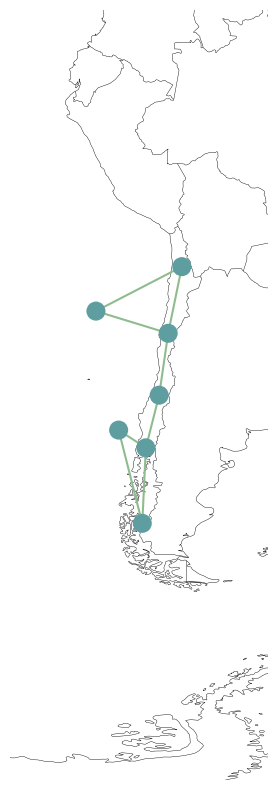

In [94]:
gdf = gpd.GeoDataFrame(n1.buses, geometry=[Point(xy) for xy in zip(n1.buses.x, n1.buses.y)])
utm_zone_epsg = 32719
gdf.crs = f'epsg:{utm_zone_epsg}'

gdf = gdf.to_crs(epsg=4326)

n1.buses['x'] = gdf.geometry.x
n1.buses['y'] = gdf.geometry.y

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection=ccrs.PlateCarree())

n1.plot(ax=ax, margin=1, bus_sizes=1)

In [91]:
n1

PyPSA Network
Components:
 - Bus: 7
 - Carrier: 11
 - Generator: 28
 - Link: 8
 - Load: 14600
 - StorageUnit: 10
Snapshots: 2920

### Investigation

##### without a limit on CO2 emissions

In [95]:
# without a limit on CO2 emissions
n1.optimize(solver_name="gurobi")

DatetimeIndex(['2013-01-01 00:00:00', '2013-01-01 03:00:00',
               '2013-01-01 06:00:00', '2013-01-01 09:00:00',
               '2013-01-01 12:00:00', '2013-01-01 15:00:00',
               '2013-01-01 18:00:00', '2013-01-01 21:00:00',
               '2013-01-02 00:00:00', '2013-01-02 03:00:00',
               ...
               '2013-12-30 18:00:00', '2013-12-30 21:00:00',
               '2013-12-31 00:00:00', '2013-12-31 03:00:00',
               '2013-12-31 06:00:00', '2013-12-31 09:00:00',
               '2013-12-31 12:00:00', '2013-12-31 15:00:00',
               '2013-12-31 18:00:00', '2013-12-31 21:00:00'],
              dtype='datetime64[ns]', name='snapshot', length=2920, freq='3h')
DatetimeIndex(['2013-01-01 00:00:00', '2013-01-01 03:00:00',
               '2013-01-01 06:00:00', '2013-01-01 09:00:00',
               '2013-01-01 12:00:00', '2013-01-01 15:00:00',
               '2013-01-01 18:00:00', '2013-01-01 21:00:00',
               '2013-01-02 00:00:00', '2013-01-

DatetimeIndex(['2013-01-01 00:00:00', '2013-01-01 03:00:00',
               '2013-01-01 06:00:00', '2013-01-01 09:00:00',
               '2013-01-01 12:00:00', '2013-01-01 15:00:00',
               '2013-01-01 18:00:00', '2013-01-01 21:00:00',
               '2013-01-02 00:00:00', '2013-01-02 03:00:00',
               ...
               '2013-12-30 18:00:00', '2013-12-30 21:00:00',
               '2013-12-31 00:00:00', '2013-12-31 03:00:00',
               '2013-12-31 06:00:00', '2013-12-31 09:00:00',
               '2013-12-31 12:00:00', '2013-12-31 15:00:00',
               '2013-12-31 18:00:00', '2013-12-31 21:00:00'],
              dtype='datetime64[ns]', name='snapshot', length=2920, freq='3h')
DatetimeIndex(['2013-01-01 00:00:00', '2013-01-01 03:00:00',
               '2013-01-01 06:00:00', '2013-01-01 09:00:00',
               '2013-01-01 12:00:00', '2013-01-01 15:00:00',
               '2013-01-01 18:00:00', '2013-01-01 21:00:00',
               '2013-01-02 00:00:00', '2013-01-

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-02-11


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-02-11
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 9/9 [00:00<00:00, 27.03it/s]
INFO:linopy.io: Writing time: 2.38s


Read LP format model from file C:\Users\phamt\AppData\Local\Temp\linopy-problem-jtdp17js.lp


INFO:gurobipy:Read LP format model from file C:\Users\phamt\AppData\Local\Temp\linopy-problem-jtdp17js.lp


Reading time = 0.70 seconds


INFO:gurobipy:Reading time = 0.70 seconds


obj: 435110 rows, 192750 columns, 823470 nonzeros


INFO:gurobipy:obj: 435110 rows, 192750 columns, 823470 nonzeros


Gurobi Optimizer version 11.0.0 build v11.0.0rc2 (win64 - Windows 11+.0 (22631.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.0 build v11.0.0rc2 (win64 - Windows 11+.0 (22631.2))


INFO:gurobipy:


CPU model: 13th Gen Intel(R) Core(TM) i7-13620H, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: 13th Gen Intel(R) Core(TM) i7-13620H, instruction set [SSE2|AVX|AVX2]


Thread count: 10 physical cores, 16 logical processors, using up to 16 threads


INFO:gurobipy:Thread count: 10 physical cores, 16 logical processors, using up to 16 threads


INFO:gurobipy:


Optimize a model with 435110 rows, 192750 columns and 823470 nonzeros


INFO:gurobipy:Optimize a model with 435110 rows, 192750 columns and 823470 nonzeros


Model fingerprint: 0x33a870eb


INFO:gurobipy:Model fingerprint: 0x33a870eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [3e-02, 8e+05]


INFO:gurobipy:  Objective range  [3e-02, 8e+05]


  Bounds range     [0e+00, 0e+00]


INFO:gurobipy:  Bounds range     [0e+00, 0e+00]


  RHS range        [1e+01, 2e+07]


INFO:gurobipy:  RHS range        [1e+01, 2e+07]


Presolve removed 271590 rows and 84692 columns


INFO:gurobipy:Presolve removed 271590 rows and 84692 columns


Presolve time: 0.39s


INFO:gurobipy:Presolve time: 0.39s


Presolved: 163520 rows, 108058 columns, 554800 nonzeros


INFO:gurobipy:Presolved: 163520 rows, 108058 columns, 554800 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: primal simplex, dual simplex, and barrier


INFO:gurobipy:Concurrent LP optimizer: primal simplex, dual simplex, and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.09s


INFO:gurobipy:Ordering time: 0.09s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 18


INFO:gurobipy: Dense cols : 18


 Free vars  : 2920


INFO:gurobipy: Free vars  : 2920


 AA' NZ     : 6.044e+05


INFO:gurobipy: AA' NZ     : 6.044e+05


 Factor NZ  : 2.563e+06 (roughly 130 MB of memory)


INFO:gurobipy: Factor NZ  : 2.563e+06 (roughly 130 MB of memory)


 Factor Ops : 5.736e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.736e+07 (less than 1 second per iteration)


 Threads    : 8


INFO:gurobipy: Threads    : 8


INFO:gurobipy:


Barrier performed 0 iterations in 0.79 seconds (0.53 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.79 seconds (0.53 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with primal simplex


INFO:gurobipy:Solved with primal simplex


INFO:gurobipy:


Solved in 0 iterations and 1.53 seconds (0.74 work units)


INFO:gurobipy:Solved in 0 iterations and 1.53 seconds (0.74 work units)


Infeasible or unbounded model


INFO:gurobipy:Infeasible or unbounded model
Status: warning
Termination condition: infeasible_or_unbounded
Solution: 0 primals, 0 duals
Objective: nan
Solver model: available
Solver message: 4



('warning', 'infeasible_or_unbounded')

In [96]:
labels = n1.model.compute_infeasibilities()
print(f"Labels:\n{labels}")
n1.model.print_infeasibilities()

Gurobi Optimizer version 11.0.0 build v11.0.0rc2 (win64 - Windows 11+.0 (22631.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.0 build v11.0.0rc2 (win64 - Windows 11+.0 (22631.2))


INFO:gurobipy:


CPU model: 13th Gen Intel(R) Core(TM) i7-13620H, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: 13th Gen Intel(R) Core(TM) i7-13620H, instruction set [SSE2|AVX|AVX2]


Thread count: 10 physical cores, 16 logical processors, using up to 16 threads


INFO:gurobipy:Thread count: 10 physical cores, 16 logical processors, using up to 16 threads


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0      handle free variables                          0s


INFO:gurobipy:       0      handle free variables                          0s


  191658   -1.0910275e+32   2.005367e+35   1.091027e+02      5s


INFO:gurobipy:  191658   -1.0910275e+32   2.005367e+35   1.091027e+02      5s


  265363    5.1653440e+12   3.584094e+12   0.000000e+00     10s


INFO:gurobipy:  265363    5.1653440e+12   3.584094e+12   0.000000e+00     10s


  284333    8.9273720e+12   3.202113e+12   0.000000e+00     15s


INFO:gurobipy:  284333    8.9273720e+12   3.202113e+12   0.000000e+00     15s


  302743    1.0216547e+13   1.930824e+12   0.000000e+00     20s


INFO:gurobipy:  302743    1.0216547e+13   1.930824e+12   0.000000e+00     20s


  312093    1.1746766e+13   1.955526e+12   0.000000e+00     25s


INFO:gurobipy:  312093    1.1746766e+13   1.955526e+12   0.000000e+00     25s


  320213    1.2044762e+13   3.349427e+12   0.000000e+00     30s


INFO:gurobipy:  320213    1.2044762e+13   3.349427e+12   0.000000e+00     30s


  327513    1.2858143e+13   3.688376e+12   0.000000e+00     35s


INFO:gurobipy:  327513    1.2858143e+13   3.688376e+12   0.000000e+00     35s


  333458    1.3654519e+13   1.931134e+12   0.000000e+00     40s


INFO:gurobipy:  333458    1.3654519e+13   1.931134e+12   0.000000e+00     40s


  340138    1.5335104e+13   3.389262e+12   0.000000e+00     45s


INFO:gurobipy:  340138    1.5335104e+13   3.389262e+12   0.000000e+00     45s


  345848    1.6232515e+13   2.203076e+12   0.000000e+00     50s


INFO:gurobipy:  345848    1.6232515e+13   2.203076e+12   0.000000e+00     50s


  349328    1.6820372e+13   4.123882e+13   0.000000e+00     55s


INFO:gurobipy:  349328    1.6820372e+13   4.123882e+13   0.000000e+00     55s


  352428    1.8039354e+13   2.812512e+13   0.000000e+00     60s


INFO:gurobipy:  352428    1.8039354e+13   2.812512e+13   0.000000e+00     60s


  355548    1.8177191e+13   4.836560e+12   0.000000e+00     65s


INFO:gurobipy:  355548    1.8177191e+13   4.836560e+12   0.000000e+00     65s


  358358    1.8603686e+13   9.155869e+13   0.000000e+00     70s


INFO:gurobipy:  358358    1.8603686e+13   9.155869e+13   0.000000e+00     70s


  360318    1.9431224e+13   1.253594e+14   0.000000e+00     76s


INFO:gurobipy:  360318    1.9431224e+13   1.253594e+14   0.000000e+00     76s


  360848    1.9489590e+13   8.371635e+13   0.000000e+00     81s


INFO:gurobipy:  360848    1.9489590e+13   8.371635e+13   0.000000e+00     81s


  361688    1.9557468e+13   1.087493e+13   0.000000e+00     86s


INFO:gurobipy:  361688    1.9557468e+13   1.087493e+13   0.000000e+00     86s


  362318    1.9587604e+13   1.246148e+13   0.000000e+00     91s


INFO:gurobipy:  362318    1.9587604e+13   1.246148e+13   0.000000e+00     91s


  362918    1.9844627e+13   2.578732e+13   0.000000e+00     95s


INFO:gurobipy:  362918    1.9844627e+13   2.578732e+13   0.000000e+00     95s


  363708    2.0560423e+13   1.570271e+14   0.000000e+00    101s


INFO:gurobipy:  363708    2.0560423e+13   1.570271e+14   0.000000e+00    101s


  364248    2.0603212e+13   6.401077e+13   0.000000e+00    105s


INFO:gurobipy:  364248    2.0603212e+13   6.401077e+13   0.000000e+00    105s


  364978    2.0803437e+13   5.957188e+13   0.000000e+00    110s


INFO:gurobipy:  364978    2.0803437e+13   5.957188e+13   0.000000e+00    110s


  365698    2.1053547e+13   1.041227e+14   0.000000e+00    115s


INFO:gurobipy:  365698    2.1053547e+13   1.041227e+14   0.000000e+00    115s


  366438    2.1279099e+13   2.773586e+13   0.000000e+00    121s


INFO:gurobipy:  366438    2.1279099e+13   2.773586e+13   0.000000e+00    121s


  367198    2.1906872e+13   2.764104e+13   0.000000e+00    126s


INFO:gurobipy:  367198    2.1906872e+13   2.764104e+13   0.000000e+00    126s


  367798    2.1936016e+13   2.090093e+13   0.000000e+00    130s


INFO:gurobipy:  367798    2.1936016e+13   2.090093e+13   0.000000e+00    130s


  368598    2.2035617e+13   5.685514e+13   0.000000e+00    136s


INFO:gurobipy:  368598    2.2035617e+13   5.685514e+13   0.000000e+00    136s


  369398    2.2130797e+13   2.281505e+13   0.000000e+00    141s


INFO:gurobipy:  369398    2.2130797e+13   2.281505e+13   0.000000e+00    141s


  369978    2.2237242e+13   5.198188e+13   0.000000e+00    145s


INFO:gurobipy:  369978    2.2237242e+13   5.198188e+13   0.000000e+00    145s


  370768    2.2258055e+13   5.251975e+13   0.000000e+00    150s


INFO:gurobipy:  370768    2.2258055e+13   5.251975e+13   0.000000e+00    150s


  371478    2.2648501e+13   2.155962e+13   0.000000e+00    156s


INFO:gurobipy:  371478    2.2648501e+13   2.155962e+13   0.000000e+00    156s


  371978    2.3608468e+13   5.881954e+13   0.000000e+00    161s


INFO:gurobipy:  371978    2.3608468e+13   5.881954e+13   0.000000e+00    161s


  372488    2.3623086e+13   5.708929e+13   0.000000e+00    165s


INFO:gurobipy:  372488    2.3623086e+13   5.708929e+13   0.000000e+00    165s


  373148    2.4216375e+13   1.517590e+14   0.000000e+00    171s


INFO:gurobipy:  373148    2.4216375e+13   1.517590e+14   0.000000e+00    171s


  373658    2.4275803e+13   3.549495e+14   0.000000e+00    175s


INFO:gurobipy:  373658    2.4275803e+13   3.549495e+14   0.000000e+00    175s


  374368    2.4665359e+13   3.247576e+13   0.000000e+00    181s


INFO:gurobipy:  374368    2.4665359e+13   3.247576e+13   0.000000e+00    181s


  374938    2.4704523e+13   1.777814e+14   0.000000e+00    186s


INFO:gurobipy:  374938    2.4704523e+13   1.777814e+14   0.000000e+00    186s


  375508    2.5499706e+13   1.456648e+14   0.000000e+00    190s


INFO:gurobipy:  375508    2.5499706e+13   1.456648e+14   0.000000e+00    190s


  376268    2.5708064e+13   7.155478e+13   0.000000e+00    196s


INFO:gurobipy:  376268    2.5708064e+13   7.155478e+13   0.000000e+00    196s


  376828    2.6321356e+13   1.544119e+13   0.000000e+00    201s


INFO:gurobipy:  376828    2.6321356e+13   1.544119e+13   0.000000e+00    201s


  377398    2.6386286e+13   1.584473e+13   0.000000e+00    205s


INFO:gurobipy:  377398    2.6386286e+13   1.584473e+13   0.000000e+00    205s


  378118    2.6714992e+13   1.068748e+13   0.000000e+00    211s


INFO:gurobipy:  378118    2.6714992e+13   1.068748e+13   0.000000e+00    211s


  378698    2.6754172e+13   1.316443e+13   0.000000e+00    216s


INFO:gurobipy:  378698    2.6754172e+13   1.316443e+13   0.000000e+00    216s


  379338    2.7186391e+13   3.281071e+14   0.000000e+00    220s


INFO:gurobipy:  379338    2.7186391e+13   3.281071e+14   0.000000e+00    220s


  380178    2.7325944e+13   8.830336e+12   0.000000e+00    226s


INFO:gurobipy:  380178    2.7325944e+13   8.830336e+12   0.000000e+00    226s


  381028    2.7462842e+13   1.528739e+13   0.000000e+00    231s


INFO:gurobipy:  381028    2.7462842e+13   1.528739e+13   0.000000e+00    231s


  381618    2.7542748e+13   2.145358e+13   0.000000e+00    235s


INFO:gurobipy:  381618    2.7542748e+13   2.145358e+13   0.000000e+00    235s


  382318    2.7978817e+13   3.900241e+13   0.000000e+00    241s


INFO:gurobipy:  382318    2.7978817e+13   3.900241e+13   0.000000e+00    241s


  382868    2.8247767e+13   6.299162e+13   0.000000e+00    245s


INFO:gurobipy:  382868    2.8247767e+13   6.299162e+13   0.000000e+00    245s


  383578    2.8415123e+13   3.672628e+13   0.000000e+00    251s


INFO:gurobipy:  383578    2.8415123e+13   3.672628e+13   0.000000e+00    251s


  384078    2.8422438e+13   2.551094e+13   0.000000e+00    255s


INFO:gurobipy:  384078    2.8422438e+13   2.551094e+13   0.000000e+00    255s


  385768    2.8850584e+13   5.330257e+13   0.000000e+00    260s


INFO:gurobipy:  385768    2.8850584e+13   5.330257e+13   0.000000e+00    260s


  387558    2.9093198e+13   6.687936e+13   0.000000e+00    265s


INFO:gurobipy:  387558    2.9093198e+13   6.687936e+13   0.000000e+00    265s


  389148    2.9408010e+13   5.124236e+13   0.000000e+00    270s


INFO:gurobipy:  389148    2.9408010e+13   5.124236e+13   0.000000e+00    270s


  390438    2.9428583e+13   4.358524e+13   0.000000e+00    275s


INFO:gurobipy:  390438    2.9428583e+13   4.358524e+13   0.000000e+00    275s


  391068    2.9467482e+13   3.793505e+13   0.000000e+00    281s


INFO:gurobipy:  391068    2.9467482e+13   3.793505e+13   0.000000e+00    281s


  391458    2.9535503e+13   1.685831e+13   0.000000e+00    286s


INFO:gurobipy:  391458    2.9535503e+13   1.685831e+13   0.000000e+00    286s


  391878    2.9567799e+13   2.431130e+13   0.000000e+00    290s


INFO:gurobipy:  391878    2.9567799e+13   2.431130e+13   0.000000e+00    290s


  392438    2.9843380e+13   3.256320e+13   0.000000e+00    296s


INFO:gurobipy:  392438    2.9843380e+13   3.256320e+13   0.000000e+00    296s


  392808    2.9984430e+13   3.032629e+13   0.000000e+00    301s


INFO:gurobipy:  392808    2.9984430e+13   3.032629e+13   0.000000e+00    301s


  393288    2.9994764e+13   8.861873e+13   0.000000e+00    306s


INFO:gurobipy:  393288    2.9994764e+13   8.861873e+13   0.000000e+00    306s


  393678    3.0018320e+13   8.410049e+13   0.000000e+00    310s


INFO:gurobipy:  393678    3.0018320e+13   8.410049e+13   0.000000e+00    310s


  394218    3.0087861e+13   2.513723e+13   0.000000e+00    316s


INFO:gurobipy:  394218    3.0087861e+13   2.513723e+13   0.000000e+00    316s


  394628    3.0356135e+13   3.521710e+13   0.000000e+00    320s


INFO:gurobipy:  394628    3.0356135e+13   3.521710e+13   0.000000e+00    320s


  395138    3.0434845e+13   3.026272e+13   0.000000e+00    325s


INFO:gurobipy:  395138    3.0434845e+13   3.026272e+13   0.000000e+00    325s


  395748    3.0446871e+13   3.772313e+12   0.000000e+00    331s


INFO:gurobipy:  395748    3.0446871e+13   3.772313e+12   0.000000e+00    331s


  396108    3.0477200e+13   1.901395e+13   0.000000e+00    335s


INFO:gurobipy:  396108    3.0477200e+13   1.901395e+13   0.000000e+00    335s


  396498    3.0497818e+13   1.798244e+14   0.000000e+00    340s


INFO:gurobipy:  396498    3.0497818e+13   1.798244e+14   0.000000e+00    340s


  397018    3.0527080e+13   1.071432e+13   0.000000e+00    346s


INFO:gurobipy:  397018    3.0527080e+13   1.071432e+13   0.000000e+00    346s


  397428    3.0572310e+13   2.888571e+13   0.000000e+00    350s


INFO:gurobipy:  397428    3.0572310e+13   2.888571e+13   0.000000e+00    350s


  397968    3.1183422e+13   3.470206e+13   0.000000e+00    356s


INFO:gurobipy:  397968    3.1183422e+13   3.470206e+13   0.000000e+00    356s


  398378    3.1254031e+13   4.658383e+13   0.000000e+00    361s


INFO:gurobipy:  398378    3.1254031e+13   4.658383e+13   0.000000e+00    361s


  398738    3.1256610e+13   3.631854e+13   0.000000e+00    365s


INFO:gurobipy:  398738    3.1256610e+13   3.631854e+13   0.000000e+00    365s


  399218    3.1353129e+13   4.989621e+13   0.000000e+00    371s


INFO:gurobipy:  399218    3.1353129e+13   4.989621e+13   0.000000e+00    371s


  399598    3.1456160e+13   1.402228e+13   0.000000e+00    375s


INFO:gurobipy:  399598    3.1456160e+13   1.402228e+13   0.000000e+00    375s


  400118    3.1465026e+13   1.315411e+13   0.000000e+00    381s


INFO:gurobipy:  400118    3.1465026e+13   1.315411e+13   0.000000e+00    381s


  400508    3.1503918e+13   2.251796e+14   0.000000e+00    386s


INFO:gurobipy:  400508    3.1503918e+13   2.251796e+14   0.000000e+00    386s


  400998    3.1509688e+13   6.545219e+13   0.000000e+00    391s


INFO:gurobipy:  400998    3.1509688e+13   6.545219e+13   0.000000e+00    391s


  401358    3.1539988e+13   1.159635e+14   0.000000e+00    396s


INFO:gurobipy:  401358    3.1539988e+13   1.159635e+14   0.000000e+00    396s


  401738    3.1551364e+13   8.434789e+15   0.000000e+00    400s


INFO:gurobipy:  401738    3.1551364e+13   8.434789e+15   0.000000e+00    400s


  402098    3.1740447e+13   4.399203e+13   0.000000e+00    405s


INFO:gurobipy:  402098    3.1740447e+13   4.399203e+13   0.000000e+00    405s


  402618    3.1784626e+13   1.185187e+13   0.000000e+00    411s


INFO:gurobipy:  402618    3.1784626e+13   1.185187e+13   0.000000e+00    411s


  402998    3.1914545e+13   1.675988e+13   0.000000e+00    415s


INFO:gurobipy:  402998    3.1914545e+13   1.675988e+13   0.000000e+00    415s


  403458    3.2005126e+13   2.762156e+13   0.000000e+00    421s


INFO:gurobipy:  403458    3.2005126e+13   2.762156e+13   0.000000e+00    421s


  403788    3.2007994e+13   2.375561e+13   0.000000e+00    426s


INFO:gurobipy:  403788    3.2007994e+13   2.375561e+13   0.000000e+00    426s


  404238    3.2015433e+13   1.971231e+13   0.000000e+00    431s


INFO:gurobipy:  404238    3.2015433e+13   1.971231e+13   0.000000e+00    431s


  404618    3.2324791e+13   1.456621e+13   0.000000e+00    436s


INFO:gurobipy:  404618    3.2324791e+13   1.456621e+13   0.000000e+00    436s


  404978    3.2330578e+13   4.400793e+13   0.000000e+00    440s


INFO:gurobipy:  404978    3.2330578e+13   4.400793e+13   0.000000e+00    440s


  405458    3.2339789e+13   3.532868e+13   0.000000e+00    446s


INFO:gurobipy:  405458    3.2339789e+13   3.532868e+13   0.000000e+00    446s


  405818    3.2652021e+13   2.753421e+13   0.000000e+00    451s


INFO:gurobipy:  405818    3.2652021e+13   2.753421e+13   0.000000e+00    451s


  406178    3.2705631e+13   2.398996e+13   0.000000e+00    455s


INFO:gurobipy:  406178    3.2705631e+13   2.398996e+13   0.000000e+00    455s


  406658    3.3055476e+13   5.565943e+13   0.000000e+00    461s


INFO:gurobipy:  406658    3.3055476e+13   5.565943e+13   0.000000e+00    461s


  407068    3.3231625e+13   3.386195e+13   0.000000e+00    466s


INFO:gurobipy:  407068    3.3231625e+13   3.386195e+13   0.000000e+00    466s


  408248    3.3861572e+13   1.053800e+13   0.000000e+00    470s


INFO:gurobipy:  408248    3.3861572e+13   1.053800e+13   0.000000e+00    470s


  409818    3.4449637e+13   1.993793e+13   0.000000e+00    475s


INFO:gurobipy:  409818    3.4449637e+13   1.993793e+13   0.000000e+00    475s


  411028    3.4899663e+13   1.017774e+13   0.000000e+00    481s


INFO:gurobipy:  411028    3.4899663e+13   1.017774e+13   0.000000e+00    481s


  411448    3.5002164e+13   4.265907e+14   0.000000e+00    485s


INFO:gurobipy:  411448    3.5002164e+13   4.265907e+14   0.000000e+00    485s


  411998    3.5040894e+13   7.388206e+12   0.000000e+00    490s


INFO:gurobipy:  411998    3.5040894e+13   7.388206e+12   0.000000e+00    490s


  412498    3.5390364e+13   1.517198e+13   0.000000e+00    496s


INFO:gurobipy:  412498    3.5390364e+13   1.517198e+13   0.000000e+00    496s


  412848    3.5755494e+13   1.542207e+13   0.000000e+00    501s


INFO:gurobipy:  412848    3.5755494e+13   1.542207e+13   0.000000e+00    501s


  413318    3.5764763e+13   6.586262e+12   0.000000e+00    505s


INFO:gurobipy:  413318    3.5764763e+13   6.586262e+12   0.000000e+00    505s


  413728    3.5835878e+13   1.067018e+13   0.000000e+00    510s


INFO:gurobipy:  413728    3.5835878e+13   1.067018e+13   0.000000e+00    510s


  414268    3.6063264e+13   4.027074e+13   0.000000e+00    516s


INFO:gurobipy:  414268    3.6063264e+13   4.027074e+13   0.000000e+00    516s


  414708    3.6091169e+13   1.004009e+14   0.000000e+00    521s


INFO:gurobipy:  414708    3.6091169e+13   1.004009e+14   0.000000e+00    521s


  415138    3.6105567e+13   1.123651e+13   0.000000e+00    525s


INFO:gurobipy:  415138    3.6105567e+13   1.123651e+13   0.000000e+00    525s


  415518    3.6170197e+13   1.189193e+13   0.000000e+00    530s


INFO:gurobipy:  415518    3.6170197e+13   1.189193e+13   0.000000e+00    530s


  415958    3.6190092e+13   2.927315e+13   0.000000e+00    536s


INFO:gurobipy:  415958    3.6190092e+13   2.927315e+13   0.000000e+00    536s


  416308    3.6372157e+13   1.768984e+13   0.000000e+00    541s


INFO:gurobipy:  416308    3.6372157e+13   1.768984e+13   0.000000e+00    541s


  416668    3.6412625e+13   2.164734e+13   0.000000e+00    546s


INFO:gurobipy:  416668    3.6412625e+13   2.164734e+13   0.000000e+00    546s


  417018    3.6442448e+13   1.941303e+13   0.000000e+00    551s


INFO:gurobipy:  417018    3.6442448e+13   1.941303e+13   0.000000e+00    551s


  417238    3.6452449e+13   2.121583e+13   0.000000e+00    555s


INFO:gurobipy:  417238    3.6452449e+13   2.121583e+13   0.000000e+00    555s


  417558    3.6459355e+13   1.405619e+14   0.000000e+00    561s


INFO:gurobipy:  417558    3.6459355e+13   1.405619e+14   0.000000e+00    561s


  417868    3.6469745e+13   2.308946e+13   0.000000e+00    567s


INFO:gurobipy:  417868    3.6469745e+13   2.308946e+13   0.000000e+00    567s


  418708    3.6496344e+13   2.886303e+13   0.000000e+00    570s


INFO:gurobipy:  418708    3.6496344e+13   2.886303e+13   0.000000e+00    570s


  420108    3.6539447e+13   2.382098e+13   0.000000e+00    575s


INFO:gurobipy:  420108    3.6539447e+13   2.382098e+13   0.000000e+00    575s


  421608    3.6579023e+13   1.222337e+13   0.000000e+00    580s


INFO:gurobipy:  421608    3.6579023e+13   1.222337e+13   0.000000e+00    580s


  423208    3.6984902e+13   3.667572e+13   0.000000e+00    585s


INFO:gurobipy:  423208    3.6984902e+13   3.667572e+13   0.000000e+00    585s


  424718    3.7438692e+13   3.564452e+14   0.000000e+00    590s


INFO:gurobipy:  424718    3.7438692e+13   3.564452e+14   0.000000e+00    590s


  426248    3.7774873e+13   4.484328e+14   0.000000e+00    595s


INFO:gurobipy:  426248    3.7774873e+13   4.484328e+14   0.000000e+00    595s


  427908    3.8531518e+13   2.464994e+14   0.000000e+00    600s


INFO:gurobipy:  427908    3.8531518e+13   2.464994e+14   0.000000e+00    600s


  429838    3.8825531e+13   1.372029e+14   0.000000e+00    605s


INFO:gurobipy:  429838    3.8825531e+13   1.372029e+14   0.000000e+00    605s


  431658    3.8825531e+13   1.417299e+14   0.000000e+00    610s


INFO:gurobipy:  431658    3.8825531e+13   1.417299e+14   0.000000e+00    610s


  433448    3.8908950e+13   3.282416e+13   0.000000e+00    615s


INFO:gurobipy:  433448    3.8908950e+13   3.282416e+13   0.000000e+00    615s


  435248    3.9453317e+13   3.723001e+14   0.000000e+00    620s


INFO:gurobipy:  435248    3.9453317e+13   3.723001e+14   0.000000e+00    620s


  436808    3.9788022e+13   1.429917e+14   0.000000e+00    625s


INFO:gurobipy:  436808    3.9788022e+13   1.429917e+14   0.000000e+00    625s


  438328    4.0808132e+13   6.711986e+13   0.000000e+00    630s


INFO:gurobipy:  438328    4.0808132e+13   6.711986e+13   0.000000e+00    630s


  440008    4.0883489e+13   1.080412e+14   0.000000e+00    635s


INFO:gurobipy:  440008    4.0883489e+13   1.080412e+14   0.000000e+00    635s


  441518    4.1165263e+13   4.391858e+13   0.000000e+00    640s


INFO:gurobipy:  441518    4.1165263e+13   4.391858e+13   0.000000e+00    640s


  442988    4.1255763e+13   6.859948e+13   0.000000e+00    645s


INFO:gurobipy:  442988    4.1255763e+13   6.859948e+13   0.000000e+00    645s


  444348    4.1469812e+13   5.597316e+13   0.000000e+00    650s


INFO:gurobipy:  444348    4.1469812e+13   5.597316e+13   0.000000e+00    650s


  445668    4.1557933e+13   1.173255e+13   0.000000e+00    655s


INFO:gurobipy:  445668    4.1557933e+13   1.173255e+13   0.000000e+00    655s


  446758    4.1592975e+13   8.648779e+12   0.000000e+00    660s


INFO:gurobipy:  446758    4.1592975e+13   8.648779e+12   0.000000e+00    660s


  447838    4.1691141e+13   7.955906e+12   0.000000e+00    665s


INFO:gurobipy:  447838    4.1691141e+13   7.955906e+12   0.000000e+00    665s


  448918    4.1843958e+13   1.974833e+14   0.000000e+00    670s


INFO:gurobipy:  448918    4.1843958e+13   1.974833e+14   0.000000e+00    670s


  449998    4.2004812e+13   2.256366e+14   0.000000e+00    675s


INFO:gurobipy:  449998    4.2004812e+13   2.256366e+14   0.000000e+00    675s


  451078    4.2063245e+13   2.227582e+14   0.000000e+00    680s


INFO:gurobipy:  451078    4.2063245e+13   2.227582e+14   0.000000e+00    680s


  452198    4.3106280e+13   2.313321e+14   0.000000e+00    685s


INFO:gurobipy:  452198    4.3106280e+13   2.313321e+14   0.000000e+00    685s


  453458    4.4105161e+13   4.610970e+13   0.000000e+00    690s


INFO:gurobipy:  453458    4.4105161e+13   4.610970e+13   0.000000e+00    690s


  454668    4.4485113e+13   3.747300e+14   0.000000e+00    695s


INFO:gurobipy:  454668    4.4485113e+13   3.747300e+14   0.000000e+00    695s


  455848    4.7193534e+13   1.052070e+15   0.000000e+00    700s


INFO:gurobipy:  455848    4.7193534e+13   1.052070e+15   0.000000e+00    700s


  457188    4.9031349e+13   1.063510e+14   0.000000e+00    705s


INFO:gurobipy:  457188    4.9031349e+13   1.063510e+14   0.000000e+00    705s


  458318    5.7012399e+13   2.847427e+13   0.000000e+00    710s


INFO:gurobipy:  458318    5.7012399e+13   2.847427e+13   0.000000e+00    710s


  459588    5.9409551e+13   2.049373e+13   0.000000e+00    716s


INFO:gurobipy:  459588    5.9409551e+13   2.049373e+13   0.000000e+00    716s


  460638    6.4903161e+13   1.164227e+14   0.000000e+00    720s


INFO:gurobipy:  460638    6.4903161e+13   1.164227e+14   0.000000e+00    720s


  461908    6.6214116e+13   1.848977e+14   0.000000e+00    726s


INFO:gurobipy:  461908    6.6214116e+13   1.848977e+14   0.000000e+00    726s


  462848    6.6654958e+13   5.524228e+14   0.000000e+00    730s


INFO:gurobipy:  462848    6.6654958e+13   5.524228e+14   0.000000e+00    730s


  463968    6.9046295e+13   3.048960e+14   0.000000e+00    735s


INFO:gurobipy:  463968    6.9046295e+13   3.048960e+14   0.000000e+00    735s


  464958    7.0747779e+13   9.032808e+13   0.000000e+00    740s


INFO:gurobipy:  464958    7.0747779e+13   9.032808e+13   0.000000e+00    740s


  466138    7.1114972e+13   6.904176e+13   0.000000e+00    745s


INFO:gurobipy:  466138    7.1114972e+13   6.904176e+13   0.000000e+00    745s


  467168    7.1277164e+13   7.433947e+13   0.000000e+00    750s


INFO:gurobipy:  467168    7.1277164e+13   7.433947e+13   0.000000e+00    750s


  468108    7.2153852e+13   9.641866e+13   0.000000e+00    755s


INFO:gurobipy:  468108    7.2153852e+13   9.641866e+13   0.000000e+00    755s


  469298    7.3294698e+13   3.977416e+14   0.000000e+00    760s


INFO:gurobipy:  469298    7.3294698e+13   3.977416e+14   0.000000e+00    760s


  470568    7.4173220e+13   3.346365e+14   0.000000e+00    765s


INFO:gurobipy:  470568    7.4173220e+13   3.346365e+14   0.000000e+00    765s


  471848    7.6353663e+13   8.853037e+13   0.000000e+00    770s


INFO:gurobipy:  471848    7.6353663e+13   8.853037e+13   0.000000e+00    770s


  473038    7.8705154e+13   1.163688e+14   0.000000e+00    775s


INFO:gurobipy:  473038    7.8705154e+13   1.163688e+14   0.000000e+00    775s


  474348    8.1665581e+13   3.886835e+14   0.000000e+00    780s


INFO:gurobipy:  474348    8.1665581e+13   3.886835e+14   0.000000e+00    780s


  475448    8.7104355e+13   1.055136e+15   0.000000e+00    785s


INFO:gurobipy:  475448    8.7104355e+13   1.055136e+15   0.000000e+00    785s


  476658    8.8746218e+13   4.609619e+14   0.000000e+00    790s


INFO:gurobipy:  476658    8.8746218e+13   4.609619e+14   0.000000e+00    790s


  477878    9.6217935e+13   1.255120e+15   0.000000e+00    795s


INFO:gurobipy:  477878    9.6217935e+13   1.255120e+15   0.000000e+00    795s


  478958    1.0214796e+14   3.709974e+14   0.000000e+00    800s


INFO:gurobipy:  478958    1.0214796e+14   3.709974e+14   0.000000e+00    800s


  480068    1.0498570e+14   7.918456e+15   0.000000e+00    805s


INFO:gurobipy:  480068    1.0498570e+14   7.918456e+15   0.000000e+00    805s


  480918    1.1166660e+14   2.449944e+15   0.000000e+00    811s


INFO:gurobipy:  480918    1.1166660e+14   2.449944e+15   0.000000e+00    811s


  481248    1.1197441e+14   8.184868e+14   0.000000e+00    817s


INFO:gurobipy:  481248    1.1197441e+14   8.184868e+14   0.000000e+00    817s


  481468    1.1241476e+14   1.902482e+14   0.000000e+00    820s


INFO:gurobipy:  481468    1.1241476e+14   1.902482e+14   0.000000e+00    820s


  481798    1.1267067e+14   5.390103e+14   0.000000e+00    826s


INFO:gurobipy:  481798    1.1267067e+14   5.390103e+14   0.000000e+00    826s


  482108    1.1299871e+14   9.042863e+14   0.000000e+00    831s


INFO:gurobipy:  482108    1.1299871e+14   9.042863e+14   0.000000e+00    831s


  482418    1.1306686e+14   2.475131e+14   0.000000e+00    836s


INFO:gurobipy:  482418    1.1306686e+14   2.475131e+14   0.000000e+00    836s


  482748    1.1312122e+14   2.105495e+14   0.000000e+00    841s


INFO:gurobipy:  482748    1.1312122e+14   2.105495e+14   0.000000e+00    841s


  483078    1.1312779e+14   1.809313e+14   0.000000e+00    847s


INFO:gurobipy:  483078    1.1312779e+14   1.809313e+14   0.000000e+00    847s


  483298    1.1312848e+14   1.689972e+14   0.000000e+00    850s


INFO:gurobipy:  483298    1.1312848e+14   1.689972e+14   0.000000e+00    850s


  483618    1.1316475e+14   1.750850e+14   0.000000e+00    856s


INFO:gurobipy:  483618    1.1316475e+14   1.750850e+14   0.000000e+00    856s


  483948    1.1351100e+14   2.652423e+14   0.000000e+00    861s


INFO:gurobipy:  483948    1.1351100e+14   2.652423e+14   0.000000e+00    861s


  484278    1.1356545e+14   2.611944e+14   0.000000e+00    866s


INFO:gurobipy:  484278    1.1356545e+14   2.611944e+14   0.000000e+00    866s


  484598    1.1360066e+14   2.632705e+14   0.000000e+00    871s


INFO:gurobipy:  484598    1.1360066e+14   2.632705e+14   0.000000e+00    871s


  484938    1.1370129e+14   2.642786e+14   0.000000e+00    877s


INFO:gurobipy:  484938    1.1370129e+14   2.642786e+14   0.000000e+00    877s


  485148    1.1378800e+14   2.510640e+14   0.000000e+00    880s


INFO:gurobipy:  485148    1.1378800e+14   2.510640e+14   0.000000e+00    880s


  485498    1.1398842e+14   9.077778e+13   0.000000e+00    885s


INFO:gurobipy:  485498    1.1398842e+14   9.077778e+13   0.000000e+00    885s


  485958    1.1449916e+14   1.686719e+14   0.000000e+00    890s


INFO:gurobipy:  485958    1.1449916e+14   1.686719e+14   0.000000e+00    890s


  486318    1.1477593e+14   7.675378e+14   0.000000e+00    896s


INFO:gurobipy:  486318    1.1477593e+14   7.675378e+14   0.000000e+00    896s


  486618    1.1482767e+14   4.507700e+14   0.000000e+00    901s


INFO:gurobipy:  486618    1.1482767e+14   4.507700e+14   0.000000e+00    901s


  486918    1.1492220e+14   6.001991e+14   0.000000e+00    907s


INFO:gurobipy:  486918    1.1492220e+14   6.001991e+14   0.000000e+00    907s


  487128    1.1492277e+14   5.699715e+14   0.000000e+00    910s


INFO:gurobipy:  487128    1.1492277e+14   5.699715e+14   0.000000e+00    910s


  487488    1.1501901e+14   4.947678e+15   0.000000e+00    916s


INFO:gurobipy:  487488    1.1501901e+14   4.947678e+15   0.000000e+00    916s


  487998    1.1599747e+14   4.675204e+15   0.000000e+00    921s


INFO:gurobipy:  487998    1.1599747e+14   4.675204e+15   0.000000e+00    921s


  488498    1.1607988e+14   2.990732e+15   0.000000e+00    926s


INFO:gurobipy:  488498    1.1607988e+14   2.990732e+15   0.000000e+00    926s


  488798    1.1625838e+14   1.731421e+15   0.000000e+00    932s


INFO:gurobipy:  488798    1.1625838e+14   1.731421e+15   0.000000e+00    932s


  488998    1.1627155e+14   2.192576e+15   0.000000e+00    936s


INFO:gurobipy:  488998    1.1627155e+14   2.192576e+15   0.000000e+00    936s


  489298    1.1628836e+14   1.931457e+15   0.000000e+00    941s


INFO:gurobipy:  489298    1.1628836e+14   1.931457e+15   0.000000e+00    941s


  489618    1.1643768e+14   6.754526e+15   0.000000e+00    947s


INFO:gurobipy:  489618    1.1643768e+14   6.754526e+15   0.000000e+00    947s


  489828    1.1710055e+14   1.794898e+15   0.000000e+00    950s


INFO:gurobipy:  489828    1.1710055e+14   1.794898e+15   0.000000e+00    950s


  490148    1.1768617e+14   2.915839e+15   0.000000e+00    956s


INFO:gurobipy:  490148    1.1768617e+14   2.915839e+15   0.000000e+00    956s


  490478    1.1876593e+14   6.518003e+15   0.000000e+00    961s


INFO:gurobipy:  490478    1.1876593e+14   6.518003e+15   0.000000e+00    961s


  490818    1.1882968e+14   1.195478e+15   0.000000e+00    967s


INFO:gurobipy:  490818    1.1882968e+14   1.195478e+15   0.000000e+00    967s


  491108    1.1965135e+14   1.182497e+15   0.000000e+00    972s


INFO:gurobipy:  491108    1.1965135e+14   1.182497e+15   0.000000e+00    972s


  491318    1.2060998e+14   1.407902e+15   0.000000e+00    976s


INFO:gurobipy:  491318    1.2060998e+14   1.407902e+15   0.000000e+00    976s


  491538    1.2124094e+14   1.460125e+14   0.000000e+00    980s


INFO:gurobipy:  491538    1.2124094e+14   1.460125e+14   0.000000e+00    980s


  491858    1.2452325e+14   5.631963e+14   0.000000e+00    986s


INFO:gurobipy:  491858    1.2452325e+14   5.631963e+14   0.000000e+00    986s


  492178    1.2614892e+14   3.120654e+16   0.000000e+00    991s


INFO:gurobipy:  492178    1.2614892e+14   3.120654e+16   0.000000e+00    991s


  492388    1.2734720e+14   2.751674e+16   0.000000e+00    995s


INFO:gurobipy:  492388    1.2734720e+14   2.751674e+16   0.000000e+00    995s


  492738    1.3396068e+14   6.193756e+15   0.000000e+00   1001s


INFO:gurobipy:  492738    1.3396068e+14   6.193756e+15   0.000000e+00   1001s


  493258    1.3523412e+14   1.492930e+16   0.000000e+00   1006s


INFO:gurobipy:  493258    1.3523412e+14   1.492930e+16   0.000000e+00   1006s


  493788    1.3762234e+14   1.334179e+16   0.000000e+00   1011s


INFO:gurobipy:  493788    1.3762234e+14   1.334179e+16   0.000000e+00   1011s


  494188    1.4300147e+14   4.565443e+15   0.000000e+00   1017s


INFO:gurobipy:  494188    1.4300147e+14   4.565443e+15   0.000000e+00   1017s


  494408    1.4606870e+14   1.358686e+15   0.000000e+00   1020s


INFO:gurobipy:  494408    1.4606870e+14   1.358686e+15   0.000000e+00   1020s


  494868    1.5390546e+14   6.505943e+13   0.000000e+00   1026s


INFO:gurobipy:  494868    1.5390546e+14   6.505943e+13   0.000000e+00   1026s


  495338    1.5409495e+14   4.947402e+15   0.000000e+00   1031s


INFO:gurobipy:  495338    1.5409495e+14   4.947402e+15   0.000000e+00   1031s


  495808    1.5690498e+14   6.248520e+13   0.000000e+00   1036s


INFO:gurobipy:  495808    1.5690498e+14   6.248520e+13   0.000000e+00   1036s


  496548    1.5755318e+14   3.727341e+15   0.000000e+00   1041s


INFO:gurobipy:  496548    1.5755318e+14   3.727341e+15   0.000000e+00   1041s


  497218    1.5796829e+14   2.939043e+15   0.000000e+00   1047s


INFO:gurobipy:  497218    1.5796829e+14   2.939043e+15   0.000000e+00   1047s


  497988    1.5828022e+14   1.393694e+15   0.000000e+00   1052s


INFO:gurobipy:  497988    1.5828022e+14   1.393694e+15   0.000000e+00   1052s


  498548    1.5907225e+14   6.568498e+16   0.000000e+00   1056s


INFO:gurobipy:  498548    1.5907225e+14   6.568498e+16   0.000000e+00   1056s


  499018    1.5971399e+14   1.654930e+14   0.000000e+00   1060s


INFO:gurobipy:  499018    1.5971399e+14   1.654930e+14   0.000000e+00   1060s


  499528    1.5996516e+14   4.978417e+16   0.000000e+00   1065s


INFO:gurobipy:  499528    1.5996516e+14   4.978417e+16   0.000000e+00   1065s


  499908    1.6146908e+14   1.226701e+15   0.000000e+00   1070s


INFO:gurobipy:  499908    1.6146908e+14   1.226701e+15   0.000000e+00   1070s


  500408    1.6235395e+14   1.202834e+15   0.000000e+00   1075s


INFO:gurobipy:  500408    1.6235395e+14   1.202834e+15   0.000000e+00   1075s


  500948    1.6331723e+14   1.195007e+15   0.000000e+00   1080s


INFO:gurobipy:  500948    1.6331723e+14   1.195007e+15   0.000000e+00   1080s


  501538    1.6519806e+14   5.729077e+13   0.000000e+00   1087s


INFO:gurobipy:  501538    1.6519806e+14   5.729077e+13   0.000000e+00   1087s


  502058    1.6823646e+14   1.279391e+14   0.000000e+00   1091s


INFO:gurobipy:  502058    1.6823646e+14   1.279391e+14   0.000000e+00   1091s


  502548    1.7650106e+14   5.592958e+13   0.000000e+00   1097s


INFO:gurobipy:  502548    1.7650106e+14   5.592958e+13   0.000000e+00   1097s


  502808    1.7650106e+14   6.922672e+13   0.000000e+00   1100s


INFO:gurobipy:  502808    1.7650106e+14   6.922672e+13   0.000000e+00   1100s


  503148    1.7650401e+14   6.153698e+13   0.000000e+00   1108s


INFO:gurobipy:  503148    1.7650401e+14   6.153698e+13   0.000000e+00   1108s


  503328    1.7650579e+14   6.334278e+13   0.000000e+00   1111s


INFO:gurobipy:  503328    1.7650579e+14   6.334278e+13   0.000000e+00   1111s


  503508    1.7651483e+14   7.447639e+13   0.000000e+00   1115s


INFO:gurobipy:  503508    1.7651483e+14   7.447639e+13   0.000000e+00   1115s


  503998    1.7656261e+14   1.768713e+15   0.000000e+00   1121s


INFO:gurobipy:  503998    1.7656261e+14   1.768713e+15   0.000000e+00   1121s


  504568    1.7851918e+14   4.594857e+15   0.000000e+00   1126s


INFO:gurobipy:  504568    1.7851918e+14   4.594857e+15   0.000000e+00   1126s


  505128    1.8222956e+14   1.355723e+15   0.000000e+00   1131s


INFO:gurobipy:  505128    1.8222956e+14   1.355723e+15   0.000000e+00   1131s


  505468    1.8244210e+14   2.772972e+14   0.000000e+00   1136s


INFO:gurobipy:  505468    1.8244210e+14   2.772972e+14   0.000000e+00   1136s


  505808    1.8245007e+14   1.652536e+14   0.000000e+00   1143s


INFO:gurobipy:  505808    1.8245007e+14   1.652536e+14   0.000000e+00   1143s


  505988    1.8245143e+14   2.495271e+14   0.000000e+00   1147s


INFO:gurobipy:  505988    1.8245143e+14   2.495271e+14   0.000000e+00   1147s


  506168    1.8245143e+14   2.525634e+14   0.000000e+00   1152s


INFO:gurobipy:  506168    1.8245143e+14   2.525634e+14   0.000000e+00   1152s


  506348    1.8245305e+14   2.467539e+14   0.000000e+00   1156s


INFO:gurobipy:  506348    1.8245305e+14   2.467539e+14   0.000000e+00   1156s


  506708    1.8245434e+14   2.550989e+14   0.000000e+00   1164s


INFO:gurobipy:  506708    1.8245434e+14   2.550989e+14   0.000000e+00   1164s


  506888    1.8245531e+14   2.437539e+14   0.000000e+00   1168s


INFO:gurobipy:  506888    1.8245531e+14   2.437539e+14   0.000000e+00   1168s


  507068    1.8245596e+14   2.412800e+14   0.000000e+00   1172s


INFO:gurobipy:  507068    1.8245596e+14   2.412800e+14   0.000000e+00   1172s


  507248    1.8245651e+14   2.476141e+14   0.000000e+00   1176s


INFO:gurobipy:  507248    1.8245651e+14   2.476141e+14   0.000000e+00   1176s


  507428    1.8245715e+14   2.059720e+14   0.000000e+00   1181s


INFO:gurobipy:  507428    1.8245715e+14   2.059720e+14   0.000000e+00   1181s


  507778    1.8245715e+14   2.221587e+14   0.000000e+00   1189s


INFO:gurobipy:  507778    1.8245715e+14   2.221587e+14   0.000000e+00   1189s


  507938    1.8245715e+14   2.202245e+14   0.000000e+00   1193s


INFO:gurobipy:  507938    1.8245715e+14   2.202245e+14   0.000000e+00   1193s


  508098    1.8245715e+14   1.938639e+14   0.000000e+00   1196s


INFO:gurobipy:  508098    1.8245715e+14   1.938639e+14   0.000000e+00   1196s


  508358    1.8245769e+14   3.348241e+14   0.000000e+00   1203s


INFO:gurobipy:  508358    1.8245769e+14   3.348241e+14   0.000000e+00   1203s


  508538    1.8246507e+14   4.822578e+14   0.000000e+00   1207s


INFO:gurobipy:  508538    1.8246507e+14   4.822578e+14   0.000000e+00   1207s


  508708    1.8247012e+14   4.134609e+14   0.000000e+00   1211s


INFO:gurobipy:  508708    1.8247012e+14   4.134609e+14   0.000000e+00   1211s


  508878    1.8247012e+14   4.078020e+14   0.000000e+00   1215s


INFO:gurobipy:  508878    1.8247012e+14   4.078020e+14   0.000000e+00   1215s


  509178    1.8247418e+14   5.808628e+14   0.000000e+00   1221s


INFO:gurobipy:  509178    1.8247418e+14   5.808628e+14   0.000000e+00   1221s


  509418    1.8249398e+14   9.347476e+13   0.000000e+00   1225s


INFO:gurobipy:  509418    1.8249398e+14   9.347476e+13   0.000000e+00   1225s


  509788    1.8256899e+14   2.048097e+14   0.000000e+00   1233s


INFO:gurobipy:  509788    1.8256899e+14   2.048097e+14   0.000000e+00   1233s


  510048    1.8256901e+14   2.052748e+14   0.000000e+00   1236s


INFO:gurobipy:  510048    1.8256901e+14   2.052748e+14   0.000000e+00   1236s


  510308    1.8258108e+14   2.336728e+14   0.000000e+00   1240s


INFO:gurobipy:  510308    1.8258108e+14   2.336728e+14   0.000000e+00   1240s


  510618    1.8284345e+14   4.396881e+14   0.000000e+00   1246s


INFO:gurobipy:  510618    1.8284345e+14   4.396881e+14   0.000000e+00   1246s


  510988    1.8301146e+14   2.674713e+15   0.000000e+00   1252s


INFO:gurobipy:  510988    1.8301146e+14   2.674713e+15   0.000000e+00   1252s


  511148    1.8301146e+14   2.694070e+15   0.000000e+00   1256s


INFO:gurobipy:  511148    1.8301146e+14   2.694070e+15   0.000000e+00   1256s


  511478    1.8309523e+14   1.861426e+15   0.000000e+00   1264s


INFO:gurobipy:  511478    1.8309523e+14   1.861426e+15   0.000000e+00   1264s


  511688    1.8315027e+14   3.153782e+15   0.000000e+00   1268s


INFO:gurobipy:  511688    1.8315027e+14   3.153782e+15   0.000000e+00   1268s


  511858    1.8315028e+14   2.654859e+15   0.000000e+00   1272s


INFO:gurobipy:  511858    1.8315028e+14   2.654859e+15   0.000000e+00   1272s


  512048    1.8341034e+14   3.045847e+14   0.000000e+00   1276s


INFO:gurobipy:  512048    1.8341034e+14   3.045847e+14   0.000000e+00   1276s


  512338    1.8505622e+14   4.241746e+14   0.000000e+00   1280s


INFO:gurobipy:  512338    1.8505622e+14   4.241746e+14   0.000000e+00   1280s


  512738    1.8606856e+14   2.293342e+15   0.000000e+00   1286s


INFO:gurobipy:  512738    1.8606856e+14   2.293342e+15   0.000000e+00   1286s


  512978    1.8750438e+14   2.256131e+15   0.000000e+00   1291s


INFO:gurobipy:  512978    1.8750438e+14   2.256131e+15   0.000000e+00   1291s


  513218    1.8849177e+14   8.408593e+13   0.000000e+00   1295s


INFO:gurobipy:  513218    1.8849177e+14   8.408593e+13   0.000000e+00   1295s


  513568    1.9439940e+14   2.558796e+16   0.000000e+00   1303s


INFO:gurobipy:  513568    1.9439940e+14   2.558796e+16   0.000000e+00   1303s


  513708    1.9494814e+14   5.935271e+15   0.000000e+00   1305s


INFO:gurobipy:  513708    1.9494814e+14   5.935271e+15   0.000000e+00   1305s


  514138    1.9821924e+14   4.026478e+15   0.000000e+00   1312s


INFO:gurobipy:  514138    1.9821924e+14   4.026478e+15   0.000000e+00   1312s


  514408    2.0131533e+14   2.734145e+16   0.000000e+00   1316s


INFO:gurobipy:  514408    2.0131533e+14   2.734145e+16   0.000000e+00   1316s


  514598    2.0705853e+14   5.101406e+15   0.000000e+00   1320s


INFO:gurobipy:  514598    2.0705853e+14   5.101406e+15   0.000000e+00   1320s


  514858    2.1088160e+14   3.504579e+15   0.000000e+00   1327s


INFO:gurobipy:  514858    2.1088160e+14   3.504579e+15   0.000000e+00   1327s


  515098    2.1636590e+14   3.497861e+15   0.000000e+00   1331s


INFO:gurobipy:  515098    2.1636590e+14   3.497861e+15   0.000000e+00   1331s


  515308    2.2177800e+14   3.358414e+14   0.000000e+00   1335s


INFO:gurobipy:  515308    2.2177800e+14   3.358414e+14   0.000000e+00   1335s


  515598    2.2203073e+14   3.150489e+14   0.000000e+00   1341s


INFO:gurobipy:  515598    2.2203073e+14   3.150489e+14   0.000000e+00   1341s


  515918    2.2204000e+14   1.598469e+16   0.000000e+00   1348s


INFO:gurobipy:  515918    2.2204000e+14   1.598469e+16   0.000000e+00   1348s


  516078    2.2204000e+14   1.595759e+16   0.000000e+00   1352s


INFO:gurobipy:  516078    2.2204000e+14   1.595759e+16   0.000000e+00   1352s


  516238    2.2204798e+14   1.190492e+16   0.000000e+00   1356s


INFO:gurobipy:  516238    2.2204798e+14   1.190492e+16   0.000000e+00   1356s


  516398    2.2204832e+14   1.283083e+14   0.000000e+00   1360s


INFO:gurobipy:  516398    2.2204832e+14   1.283083e+14   0.000000e+00   1360s


  516698    2.2207156e+14   1.171142e+16   0.000000e+00   1368s


INFO:gurobipy:  516698    2.2207156e+14   1.171142e+16   0.000000e+00   1368s


  516838    2.2207760e+14   2.408386e+15   0.000000e+00   1373s


INFO:gurobipy:  516838    2.2207760e+14   2.408386e+15   0.000000e+00   1373s


  516978    2.2207789e+14   1.348660e+15   0.000000e+00   1377s


INFO:gurobipy:  516978    2.2207789e+14   1.348660e+15   0.000000e+00   1377s


  517118    2.2207789e+14   1.318335e+15   0.000000e+00   1381s


INFO:gurobipy:  517118    2.2207789e+14   1.318335e+15   0.000000e+00   1381s


  517318    2.2207950e+14   2.316213e+14   0.000000e+00   1385s


INFO:gurobipy:  517318    2.2207950e+14   2.316213e+14   0.000000e+00   1385s


  517628    2.2208038e+14   3.424654e+14   0.000000e+00   1393s


INFO:gurobipy:  517628    2.2208038e+14   3.424654e+14   0.000000e+00   1393s


  517808    2.2208038e+14   2.300236e+14   0.000000e+00   1396s


INFO:gurobipy:  517808    2.2208038e+14   2.300236e+14   0.000000e+00   1396s


  518088    2.2208038e+14   1.884198e+14   0.000000e+00   1402s


INFO:gurobipy:  518088    2.2208038e+14   1.884198e+14   0.000000e+00   1402s


  518268    2.2208302e+14   2.624728e+16   0.000000e+00   1406s


INFO:gurobipy:  518268    2.2208302e+14   2.624728e+16   0.000000e+00   1406s


  518858    2.2257331e+14   6.897549e+14   0.000000e+00   1412s


INFO:gurobipy:  518858    2.2257331e+14   6.897549e+14   0.000000e+00   1412s


  519238    2.2280042e+14   8.204187e+14   0.000000e+00   1415s


INFO:gurobipy:  519238    2.2280042e+14   8.204187e+14   0.000000e+00   1415s


  519738    2.2319383e+14   6.967928e+15   0.000000e+00   1421s


INFO:gurobipy:  519738    2.2319383e+14   6.967928e+15   0.000000e+00   1421s


  520068    2.2324602e+14   2.871462e+14   0.000000e+00   1428s


INFO:gurobipy:  520068    2.2324602e+14   2.871462e+14   0.000000e+00   1428s


  520238    2.2324602e+14   2.762746e+14   0.000000e+00   1432s


INFO:gurobipy:  520238    2.2324602e+14   2.762746e+14   0.000000e+00   1432s


  520408    2.2324602e+14   3.576109e+14   0.000000e+00   1436s


INFO:gurobipy:  520408    2.2324602e+14   3.576109e+14   0.000000e+00   1436s


  520738    2.2324602e+14   2.724217e+14   0.000000e+00   1443s


INFO:gurobipy:  520738    2.2324602e+14   2.724217e+14   0.000000e+00   1443s


  520898    2.2324603e+14   2.208245e+14   0.000000e+00   1447s


INFO:gurobipy:  520898    2.2324603e+14   2.208245e+14   0.000000e+00   1447s


  521058    2.2324603e+14   2.211877e+14   0.000000e+00   1451s


INFO:gurobipy:  521058    2.2324603e+14   2.211877e+14   0.000000e+00   1451s


  521268    2.2324603e+14   1.948669e+14   0.000000e+00   1456s


INFO:gurobipy:  521268    2.2324603e+14   1.948669e+14   0.000000e+00   1456s


  521598    2.2324640e+14   4.789865e+16   0.000000e+00   1464s


INFO:gurobipy:  521598    2.2324640e+14   4.789865e+16   0.000000e+00   1464s


  521698    2.2328383e+14   2.437415e+15   0.000000e+00   1466s


INFO:gurobipy:  521698    2.2328383e+14   2.437415e+15   0.000000e+00   1466s


  522008    2.2328384e+14   2.415427e+15   0.000000e+00   1474s


INFO:gurobipy:  522008    2.2328384e+14   2.415427e+15   0.000000e+00   1474s


  522108    2.2328384e+14   2.404945e+15   0.000000e+00   1475s


INFO:gurobipy:  522108    2.2328384e+14   2.404945e+15   0.000000e+00   1475s


  522408    2.2334359e+14   1.440895e+16   0.000000e+00   1481s


INFO:gurobipy:  522408    2.2334359e+14   1.440895e+16   0.000000e+00   1481s


  522788    2.2357509e+14   2.600679e+15   0.000000e+00   1485s


INFO:gurobipy:  522788    2.2357509e+14   2.600679e+15   0.000000e+00   1485s


  523558    2.2418358e+14   3.398060e+15   0.000000e+00   1491s


INFO:gurobipy:  523558    2.2418358e+14   3.398060e+15   0.000000e+00   1491s


  524278    2.2491325e+14   5.881574e+15   0.000000e+00   1497s


INFO:gurobipy:  524278    2.2491325e+14   5.881574e+15   0.000000e+00   1497s


  524678    2.2517933e+14   8.517898e+14   0.000000e+00   1501s


INFO:gurobipy:  524678    2.2517933e+14   8.517898e+14   0.000000e+00   1501s


  525308    2.2701295e+14   1.503537e+15   0.000000e+00   1506s


INFO:gurobipy:  525308    2.2701295e+14   1.503537e+15   0.000000e+00   1506s


  525788    2.2711592e+14   6.978302e+14   0.000000e+00   1510s


INFO:gurobipy:  525788    2.2711592e+14   6.978302e+14   0.000000e+00   1510s


  526368    2.3084347e+14   2.742388e+14   0.000000e+00   1516s


INFO:gurobipy:  526368    2.3084347e+14   2.742388e+14   0.000000e+00   1516s


  526978    2.3214887e+14   3.621320e+15   0.000000e+00   1522s


INFO:gurobipy:  526978    2.3214887e+14   3.621320e+15   0.000000e+00   1522s


  527378    2.3440731e+14   6.751784e+15   0.000000e+00   1526s


INFO:gurobipy:  527378    2.3440731e+14   6.751784e+15   0.000000e+00   1526s


  527998    2.3813514e+14   2.401447e+15   0.000000e+00   1532s


INFO:gurobipy:  527998    2.3813514e+14   2.401447e+15   0.000000e+00   1532s


  528418    2.3932442e+14   5.535734e+15   0.000000e+00   1537s


INFO:gurobipy:  528418    2.3932442e+14   5.535734e+15   0.000000e+00   1537s


  528788    2.3981802e+14   2.117560e+15   0.000000e+00   1541s


INFO:gurobipy:  528788    2.3981802e+14   2.117560e+15   0.000000e+00   1541s


  529088    2.4017350e+14   1.108616e+16   0.000000e+00   1545s


INFO:gurobipy:  529088    2.4017350e+14   1.108616e+16   0.000000e+00   1545s


  529538    2.4021280e+14   4.107562e+15   0.000000e+00   1553s


INFO:gurobipy:  529538    2.4021280e+14   4.107562e+15   0.000000e+00   1553s


  529888    2.4134781e+14   9.561855e+15   0.000000e+00   1556s


INFO:gurobipy:  529888    2.4134781e+14   9.561855e+15   0.000000e+00   1556s


  530308    2.4286319e+14   6.405862e+16   0.000000e+00   1562s


INFO:gurobipy:  530308    2.4286319e+14   6.405862e+16   0.000000e+00   1562s


  530848    2.4332022e+14   1.222427e+16   0.000000e+00   1566s


INFO:gurobipy:  530848    2.4332022e+14   1.222427e+16   0.000000e+00   1566s


  531518    2.4417724e+14   9.389335e+16   0.000000e+00   1572s


INFO:gurobipy:  531518    2.4417724e+14   9.389335e+16   0.000000e+00   1572s


  531778    2.4429661e+14   1.555455e+15   0.000000e+00   1576s


INFO:gurobipy:  531778    2.4429661e+14   1.555455e+15   0.000000e+00   1576s


  532048    2.4456681e+14   1.495187e+15   0.000000e+00   1581s


INFO:gurobipy:  532048    2.4456681e+14   1.495187e+15   0.000000e+00   1581s


  532398    2.4497665e+14   7.108587e+15   0.000000e+00   1585s


INFO:gurobipy:  532398    2.4497665e+14   7.108587e+15   0.000000e+00   1585s


  533118    2.4589663e+14   1.515401e+16   0.000000e+00   1592s


INFO:gurobipy:  533118    2.4589663e+14   1.515401e+16   0.000000e+00   1592s


  533438    2.4599381e+14   7.927953e+15   0.000000e+00   1596s


INFO:gurobipy:  533438    2.4599381e+14   7.927953e+15   0.000000e+00   1596s


  533698    2.4625582e+14   1.692648e+15   0.000000e+00   1602s


INFO:gurobipy:  533698    2.4625582e+14   1.692648e+15   0.000000e+00   1602s


  533968    2.4651874e+14   5.687898e+15   0.000000e+00   1607s


INFO:gurobipy:  533968    2.4651874e+14   5.687898e+15   0.000000e+00   1607s


  534108    2.4652355e+14   5.849304e+15   0.000000e+00   1611s


INFO:gurobipy:  534108    2.4652355e+14   5.849304e+15   0.000000e+00   1611s


  534298    2.4664642e+14   1.135808e+16   0.000000e+00   1615s


INFO:gurobipy:  534298    2.4664642e+14   1.135808e+16   0.000000e+00   1615s


  534578    2.4681184e+14   7.753499e+15   0.000000e+00   1624s


INFO:gurobipy:  534578    2.4681184e+14   7.753499e+15   0.000000e+00   1624s


  534718    2.4685503e+14   1.955952e+14   0.000000e+00   1628s


INFO:gurobipy:  534718    2.4685503e+14   1.955952e+14   0.000000e+00   1628s


  535078    2.4696840e+14   4.323847e+15   0.000000e+00   1632s


INFO:gurobipy:  535078    2.4696840e+14   4.323847e+15   0.000000e+00   1632s


  535338    2.4697766e+14   6.442679e+14   0.000000e+00   1638s


INFO:gurobipy:  535338    2.4697766e+14   6.442679e+14   0.000000e+00   1638s


  535478    2.4698093e+14   6.460180e+14   0.000000e+00   1642s


INFO:gurobipy:  535478    2.4698093e+14   6.460180e+14   0.000000e+00   1642s


  535618    2.4700426e+14   9.948598e+13   0.000000e+00   1646s


INFO:gurobipy:  535618    2.4700426e+14   9.948598e+13   0.000000e+00   1646s


  535908    2.4728613e+14   5.429943e+14   0.000000e+00   1654s


INFO:gurobipy:  535908    2.4728613e+14   5.429943e+14   0.000000e+00   1654s


  536068    2.4728642e+14   2.317353e+14   0.000000e+00   1658s


INFO:gurobipy:  536068    2.4728642e+14   2.317353e+14   0.000000e+00   1658s


  536228    2.4728642e+14   1.975987e+14   0.000000e+00   1662s


INFO:gurobipy:  536228    2.4728642e+14   1.975987e+14   0.000000e+00   1662s


  536378    2.4728887e+14   3.178395e+13   0.000000e+00   1667s


INFO:gurobipy:  536378    2.4728887e+14   3.178395e+13   0.000000e+00   1667s


  536518    2.4729178e+14   1.444685e+14   0.000000e+00   1671s


INFO:gurobipy:  536518    2.4729178e+14   1.444685e+14   0.000000e+00   1671s


  536798    2.4729178e+14   9.704070e+13   0.000000e+00   1679s


INFO:gurobipy:  536798    2.4729178e+14   9.704070e+13   0.000000e+00   1679s


  536938    2.4729178e+14   1.033455e+14   0.000000e+00   1683s


INFO:gurobipy:  536938    2.4729178e+14   1.033455e+14   0.000000e+00   1683s


  537098    2.4732701e+14   4.558114e+15   0.000000e+00   1687s


INFO:gurobipy:  537098    2.4732701e+14   4.558114e+15   0.000000e+00   1687s


  537358    2.4764971e+14   3.911992e+15   0.000000e+00   1691s


INFO:gurobipy:  537358    2.4764971e+14   3.911992e+15   0.000000e+00   1691s


  537638    2.4852176e+14   1.706353e+15   0.000000e+00   1696s


INFO:gurobipy:  537638    2.4852176e+14   1.706353e+15   0.000000e+00   1696s


  538158    2.4916157e+14   7.435369e+13   0.000000e+00   1702s


INFO:gurobipy:  538158    2.4916157e+14   7.435369e+13   0.000000e+00   1702s


  538478    2.5101044e+14   1.294074e+15   0.000000e+00   1708s


INFO:gurobipy:  538478    2.5101044e+14   1.294074e+15   0.000000e+00   1708s


  538748    2.5317247e+14   2.588166e+15   0.000000e+00   1712s


INFO:gurobipy:  538748    2.5317247e+14   2.588166e+15   0.000000e+00   1712s


  539058    2.5510805e+14   1.281661e+14   0.000000e+00   1715s


INFO:gurobipy:  539058    2.5510805e+14   1.281661e+14   0.000000e+00   1715s


  539448    2.5871464e+14   1.372168e+15   0.000000e+00   1721s


INFO:gurobipy:  539448    2.5871464e+14   1.372168e+15   0.000000e+00   1721s


  539868    2.6256014e+14   3.738906e+14   0.000000e+00   1727s


INFO:gurobipy:  539868    2.6256014e+14   3.738906e+14   0.000000e+00   1727s


  540098    2.6818167e+14   2.098565e+14   0.000000e+00   1731s


INFO:gurobipy:  540098    2.6818167e+14   2.098565e+14   0.000000e+00   1731s


  540468    2.7318960e+14   3.783722e+14   0.000000e+00   1737s


INFO:gurobipy:  540468    2.7318960e+14   3.783722e+14   0.000000e+00   1737s


  540678    2.7318960e+14   3.949684e+14   0.000000e+00   1741s


INFO:gurobipy:  540678    2.7318960e+14   3.949684e+14   0.000000e+00   1741s


  540998    2.7318960e+14   4.115349e+14   0.000000e+00   1747s


INFO:gurobipy:  540998    2.7318960e+14   4.115349e+14   0.000000e+00   1747s


  541208    2.7318960e+14   3.816906e+14   0.000000e+00   1751s


INFO:gurobipy:  541208    2.7318960e+14   3.816906e+14   0.000000e+00   1751s


  541538    2.7318960e+14   3.751699e+14   0.000000e+00   1757s


INFO:gurobipy:  541538    2.7318960e+14   3.751699e+14   0.000000e+00   1757s


  541778    2.7318960e+14   1.953505e+14   0.000000e+00   1761s


INFO:gurobipy:  541778    2.7318960e+14   1.953505e+14   0.000000e+00   1761s


  542018    2.7318960e+14   8.932185e+13   0.000000e+00   1765s


INFO:gurobipy:  542018    2.7318960e+14   8.932185e+13   0.000000e+00   1765s


  542418    2.7318960e+14   1.104159e+14   0.000000e+00   1774s


INFO:gurobipy:  542418    2.7318960e+14   1.104159e+14   0.000000e+00   1774s


  542558    2.7318960e+14   2.002837e+14   0.000000e+00   1778s


INFO:gurobipy:  542558    2.7318960e+14   2.002837e+14   0.000000e+00   1778s


  542708    2.7318960e+14   1.690715e+14   0.000000e+00   1783s


INFO:gurobipy:  542708    2.7318960e+14   1.690715e+14   0.000000e+00   1783s


  542868    2.7318960e+14   1.140899e+14   0.000000e+00   1787s


INFO:gurobipy:  542868    2.7318960e+14   1.140899e+14   0.000000e+00   1787s


  543008    2.7318960e+14   1.448785e+14   0.000000e+00   1791s


INFO:gurobipy:  543008    2.7318960e+14   1.448785e+14   0.000000e+00   1791s


  543148    2.7318960e+14   1.292033e+14   0.000000e+00   1796s


INFO:gurobipy:  543148    2.7318960e+14   1.292033e+14   0.000000e+00   1796s


  543288    2.7318960e+14   1.489270e+14   0.000000e+00   1800s


INFO:gurobipy:  543288    2.7318960e+14   1.489270e+14   0.000000e+00   1800s


  543568    2.7318960e+14   1.288101e+14   0.000000e+00   1809s


INFO:gurobipy:  543568    2.7318960e+14   1.288101e+14   0.000000e+00   1809s


  543728    2.7318960e+14   1.207504e+14   0.000000e+00   1813s


INFO:gurobipy:  543728    2.7318960e+14   1.207504e+14   0.000000e+00   1813s


  543878    2.7318960e+14   1.139800e+14   0.000000e+00   1818s


INFO:gurobipy:  543878    2.7318960e+14   1.139800e+14   0.000000e+00   1818s


  544028    2.7318960e+14   1.880513e+14   0.000000e+00   1822s


INFO:gurobipy:  544028    2.7318960e+14   1.880513e+14   0.000000e+00   1822s


  544188    2.7318960e+14   2.496156e+14   0.000000e+00   1827s


INFO:gurobipy:  544188    2.7318960e+14   2.496156e+14   0.000000e+00   1827s


  544338    2.7318960e+14   1.029546e+14   0.000000e+00   1831s


INFO:gurobipy:  544338    2.7318960e+14   1.029546e+14   0.000000e+00   1831s


  544478    2.7318960e+14   9.912207e+13   0.000000e+00   1835s


INFO:gurobipy:  544478    2.7318960e+14   9.912207e+13   0.000000e+00   1835s


  544758    2.7318960e+14   1.195018e+14   0.000000e+00   1844s


INFO:gurobipy:  544758    2.7318960e+14   1.195018e+14   0.000000e+00   1844s


  544908    2.7318960e+14   8.986365e+13   0.000000e+00   1849s


INFO:gurobipy:  544908    2.7318960e+14   8.986365e+13   0.000000e+00   1849s


  545078    2.7318960e+14   2.406118e+14   0.000000e+00   1853s


INFO:gurobipy:  545078    2.7318960e+14   2.406118e+14   0.000000e+00   1853s


  545318    2.7318960e+14   7.645166e+13   0.000000e+00   1859s


INFO:gurobipy:  545318    2.7318960e+14   7.645166e+13   0.000000e+00   1859s


  545458    2.7318960e+14   1.118223e+14   0.000000e+00   1864s


INFO:gurobipy:  545458    2.7318960e+14   1.118223e+14   0.000000e+00   1864s


  545598    2.7318960e+14   7.896699e+13   0.000000e+00   1868s


INFO:gurobipy:  545598    2.7318960e+14   7.896699e+13   0.000000e+00   1868s


  545728    2.7318960e+14   2.314019e+14   0.000000e+00   1872s


INFO:gurobipy:  545728    2.7318960e+14   2.314019e+14   0.000000e+00   1872s


  545878    2.7318960e+14   8.728580e+13   0.000000e+00   1877s


INFO:gurobipy:  545878    2.7318960e+14   8.728580e+13   0.000000e+00   1877s


  546038    2.7318960e+14   9.652677e+13   0.000000e+00   1881s


INFO:gurobipy:  546038    2.7318960e+14   9.652677e+13   0.000000e+00   1881s


  546198    2.7318960e+14   1.203510e+14   0.000000e+00   1885s


INFO:gurobipy:  546198    2.7318960e+14   1.203510e+14   0.000000e+00   1885s


  546508    2.7318960e+14   1.936105e+14   0.000000e+00   1894s


INFO:gurobipy:  546508    2.7318960e+14   1.936105e+14   0.000000e+00   1894s


  546688    2.7318960e+14   8.736211e+13   0.000000e+00   1898s


INFO:gurobipy:  546688    2.7318960e+14   8.736211e+13   0.000000e+00   1898s


  546788    2.7318960e+14   8.815144e+13   0.000000e+00   1900s


INFO:gurobipy:  546788    2.7318960e+14   8.815144e+13   0.000000e+00   1900s


  547048    2.7318960e+14   1.530080e+14   0.000000e+00   1906s


INFO:gurobipy:  547048    2.7318960e+14   1.530080e+14   0.000000e+00   1906s


  547218    2.7318960e+14   6.880444e+13   0.000000e+00   1911s


INFO:gurobipy:  547218    2.7318960e+14   6.880444e+13   0.000000e+00   1911s


  547358    2.7318960e+14   1.325595e+14   0.000000e+00   1915s


INFO:gurobipy:  547358    2.7318960e+14   1.325595e+14   0.000000e+00   1915s


  547628    2.7318960e+14   6.093399e+13   0.000000e+00   1924s


INFO:gurobipy:  547628    2.7318960e+14   6.093399e+13   0.000000e+00   1924s


  547758    2.7318960e+14   2.547065e+14   0.000000e+00   1928s


INFO:gurobipy:  547758    2.7318960e+14   2.547065e+14   0.000000e+00   1928s


  547918    2.7318960e+14   9.846469e+13   0.000000e+00   1933s


INFO:gurobipy:  547918    2.7318960e+14   9.846469e+13   0.000000e+00   1933s


  548078    2.7318960e+14   7.872375e+13   0.000000e+00   1937s


INFO:gurobipy:  548078    2.7318960e+14   7.872375e+13   0.000000e+00   1937s


  548228    2.7318960e+14   6.843399e+13   0.000000e+00   1942s


INFO:gurobipy:  548228    2.7318960e+14   6.843399e+13   0.000000e+00   1942s


  548478    2.7318960e+14   1.248481e+14   0.000000e+00   1948s


INFO:gurobipy:  548478    2.7318960e+14   1.248481e+14   0.000000e+00   1948s


  548628    2.7318960e+14   1.235140e+14   0.000000e+00   1953s


INFO:gurobipy:  548628    2.7318960e+14   1.235140e+14   0.000000e+00   1953s


  548798    2.7318960e+14   1.172131e+14   0.000000e+00   1957s


INFO:gurobipy:  548798    2.7318960e+14   1.172131e+14   0.000000e+00   1957s


  548938    2.7318960e+14   4.019242e+14   0.000000e+00   1961s


INFO:gurobipy:  548938    2.7318960e+14   4.019242e+14   0.000000e+00   1961s


  549058    2.7318960e+14   7.408922e+13   0.000000e+00   1965s


INFO:gurobipy:  549058    2.7318960e+14   7.408922e+13   0.000000e+00   1965s


  549328    2.7318960e+14   4.170660e+13   0.000000e+00   1974s


INFO:gurobipy:  549328    2.7318960e+14   4.170660e+13   0.000000e+00   1974s


  549458    2.7336982e+14   3.331255e+15   0.000000e+00   1976s


INFO:gurobipy:  549458    2.7336982e+14   3.331255e+15   0.000000e+00   1976s


  549838    2.7367189e+14   2.083605e+16   0.000000e+00   1980s


INFO:gurobipy:  549838    2.7367189e+14   2.083605e+16   0.000000e+00   1980s


  550238    2.7453194e+14   9.889162e+15   0.000000e+00   1986s


INFO:gurobipy:  550238    2.7453194e+14   9.889162e+15   0.000000e+00   1986s


  550478    2.7493201e+14   3.879405e+14   0.000000e+00   1991s


INFO:gurobipy:  550478    2.7493201e+14   3.879405e+14   0.000000e+00   1991s


  550978    2.8443078e+14   5.960584e+14   0.000000e+00   1997s


INFO:gurobipy:  550978    2.8443078e+14   5.960584e+14   0.000000e+00   1997s


  551148    2.8586750e+14   2.065794e+15   0.000000e+00   2001s


INFO:gurobipy:  551148    2.8586750e+14   2.065794e+15   0.000000e+00   2001s


  551368    2.8638851e+14   1.802225e+14   0.000000e+00   2008s


INFO:gurobipy:  551368    2.8638851e+14   1.802225e+14   0.000000e+00   2008s


  551488    2.8638851e+14   1.680942e+14   0.000000e+00   2012s


INFO:gurobipy:  551488    2.8638851e+14   1.680942e+14   0.000000e+00   2012s


  551838    2.8686493e+14   7.544272e+15   0.000000e+00   2016s


INFO:gurobipy:  551838    2.8686493e+14   7.544272e+15   0.000000e+00   2016s


  552108    2.8706667e+14   3.807176e+14   0.000000e+00   2021s


INFO:gurobipy:  552108    2.8706667e+14   3.807176e+14   0.000000e+00   2021s


  552518    2.8786222e+14   5.758095e+14   0.000000e+00   2027s


INFO:gurobipy:  552518    2.8786222e+14   5.758095e+14   0.000000e+00   2027s


  552738    2.8845667e+14   8.915348e+13   0.000000e+00   2031s


INFO:gurobipy:  552738    2.8845667e+14   8.915348e+13   0.000000e+00   2031s


  553078    2.8928432e+14   1.134351e+14   0.000000e+00   2035s


INFO:gurobipy:  553078    2.8928432e+14   1.134351e+14   0.000000e+00   2035s


  553638    2.9053116e+14   1.623442e+16   0.000000e+00   2041s


INFO:gurobipy:  553638    2.9053116e+14   1.623442e+16   0.000000e+00   2041s


  554118    2.9090627e+14   7.086591e+15   0.000000e+00   2047s


INFO:gurobipy:  554118    2.9090627e+14   7.086591e+15   0.000000e+00   2047s


  554348    2.9147785e+14   1.574409e+15   0.000000e+00   2051s


INFO:gurobipy:  554348    2.9147785e+14   1.574409e+15   0.000000e+00   2051s


  554538    2.9154647e+14   1.270682e+15   0.000000e+00   2055s


INFO:gurobipy:  554538    2.9154647e+14   1.270682e+15   0.000000e+00   2055s


  554888    2.9154647e+14   4.182606e+15   0.000000e+00   2062s


INFO:gurobipy:  554888    2.9154647e+14   4.182606e+15   0.000000e+00   2062s


  555018    2.9154647e+14   1.289126e+16   0.000000e+00   2066s


INFO:gurobipy:  555018    2.9154647e+14   1.289126e+16   0.000000e+00   2066s


  555408    2.9176377e+14   4.331343e+15   0.000000e+00   2072s


INFO:gurobipy:  555408    2.9176377e+14   4.331343e+15   0.000000e+00   2072s


  555678    2.9203136e+14   9.892080e+15   0.000000e+00   2076s


INFO:gurobipy:  555678    2.9203136e+14   9.892080e+15   0.000000e+00   2076s


  555968    2.9329878e+14   6.573173e+15   0.000000e+00   2080s


INFO:gurobipy:  555968    2.9329878e+14   6.573173e+15   0.000000e+00   2080s


  556418    2.9342832e+14   5.520600e+15   0.000000e+00   2086s


INFO:gurobipy:  556418    2.9342832e+14   5.520600e+15   0.000000e+00   2086s


  556898    2.9351556e+14   1.525558e+17   0.000000e+00   2091s


INFO:gurobipy:  556898    2.9351556e+14   1.525558e+17   0.000000e+00   2091s


  557398    2.9356068e+14   5.693568e+16   0.000000e+00   2096s


INFO:gurobipy:  557398    2.9356068e+14   5.693568e+16   0.000000e+00   2096s


  557958    2.9416386e+14   2.452824e+17   0.000000e+00   2101s


INFO:gurobipy:  557958    2.9416386e+14   2.452824e+17   0.000000e+00   2101s


  558298    2.9612809e+14   4.693063e+16   0.000000e+00   2105s


INFO:gurobipy:  558298    2.9612809e+14   4.693063e+16   0.000000e+00   2105s


  558848    2.9955940e+14   3.607416e+15   0.000000e+00   2110s


INFO:gurobipy:  558848    2.9955940e+14   3.607416e+15   0.000000e+00   2110s


  559598    3.0139074e+14   3.379119e+16   0.000000e+00   2117s


INFO:gurobipy:  559598    3.0139074e+14   3.379119e+16   0.000000e+00   2117s


  560058    3.0210692e+14   7.250636e+16   0.000000e+00   2121s


INFO:gurobipy:  560058    3.0210692e+14   7.250636e+16   0.000000e+00   2121s


  560618    3.0292737e+14   1.131038e+16   0.000000e+00   2127s


INFO:gurobipy:  560618    3.0292737e+14   1.131038e+16   0.000000e+00   2127s


  561058    3.0315413e+14   8.008895e+15   0.000000e+00   2131s


INFO:gurobipy:  561058    3.0315413e+14   8.008895e+15   0.000000e+00   2131s


  561928    3.0373882e+14   2.662633e+15   0.000000e+00   2137s


INFO:gurobipy:  561928    3.0373882e+14   2.662633e+15   0.000000e+00   2137s


  562408    3.0393250e+14   2.514450e+16   0.000000e+00   2141s


INFO:gurobipy:  562408    3.0393250e+14   2.514450e+16   0.000000e+00   2141s


  563118    3.0476233e+14   6.385181e+15   0.000000e+00   2147s


INFO:gurobipy:  563118    3.0476233e+14   6.385181e+15   0.000000e+00   2147s


  563578    3.0502601e+14   2.549630e+15   0.000000e+00   2151s


INFO:gurobipy:  563578    3.0502601e+14   2.549630e+15   0.000000e+00   2151s


  564008    3.0596618e+14   1.442898e+15   0.000000e+00   2155s


INFO:gurobipy:  564008    3.0596618e+14   1.442898e+15   0.000000e+00   2155s


  564688    3.0639289e+14   1.523307e+17   0.000000e+00   2161s


INFO:gurobipy:  564688    3.0639289e+14   1.523307e+17   0.000000e+00   2161s


  565058    3.0639290e+14   9.268577e+15   0.000000e+00   2167s


INFO:gurobipy:  565058    3.0639290e+14   9.268577e+15   0.000000e+00   2167s


  565228    3.0639290e+14   9.361409e+15   0.000000e+00   2170s


INFO:gurobipy:  565228    3.0639290e+14   9.361409e+15   0.000000e+00   2170s


  565528    3.0639293e+14   4.268194e+15   0.000000e+00   2177s


INFO:gurobipy:  565528    3.0639293e+14   4.268194e+15   0.000000e+00   2177s


  565738    3.0639293e+14   4.260690e+15   0.000000e+00   2180s


INFO:gurobipy:  565738    3.0639293e+14   4.260690e+15   0.000000e+00   2180s


  566078    3.0639622e+14   5.131895e+15   0.000000e+00   2189s


INFO:gurobipy:  566078    3.0639622e+14   5.131895e+15   0.000000e+00   2189s


  566198    3.0639622e+14   5.131235e+15   0.000000e+00   2193s


INFO:gurobipy:  566198    3.0639622e+14   5.131235e+15   0.000000e+00   2193s


  566368    3.0639701e+14   4.860139e+15   0.000000e+00   2197s


INFO:gurobipy:  566368    3.0639701e+14   4.860139e+15   0.000000e+00   2197s


  566618    3.0697190e+14   2.340211e+15   0.000000e+00   2201s


INFO:gurobipy:  566618    3.0697190e+14   2.340211e+15   0.000000e+00   2201s


  567148    3.0863531e+14   4.442907e+15   0.000000e+00   2208s


INFO:gurobipy:  567148    3.0863531e+14   4.442907e+15   0.000000e+00   2208s


  567278    3.0863531e+14   4.322818e+15   0.000000e+00   2210s


INFO:gurobipy:  567278    3.0863531e+14   4.322818e+15   0.000000e+00   2210s


  567648    3.0921844e+14   1.184507e+15   0.000000e+00   2216s


INFO:gurobipy:  567648    3.0921844e+14   1.184507e+15   0.000000e+00   2216s


  568138    3.1339424e+14   1.732103e+15   0.000000e+00   2222s


INFO:gurobipy:  568138    3.1339424e+14   1.732103e+15   0.000000e+00   2222s


  568428    3.1528745e+14   1.233740e+15   0.000000e+00   2226s


INFO:gurobipy:  568428    3.1528745e+14   1.233740e+15   0.000000e+00   2226s


  568638    3.1698167e+14   2.784380e+15   0.000000e+00   2232s


INFO:gurobipy:  568638    3.1698167e+14   2.784380e+15   0.000000e+00   2232s


  568758    3.1698447e+14   5.328431e+14   0.000000e+00   2236s


INFO:gurobipy:  568758    3.1698447e+14   5.328431e+14   0.000000e+00   2236s


  568878    3.1705637e+14   5.765915e+14   0.000000e+00   2241s


INFO:gurobipy:  568878    3.1705637e+14   5.765915e+14   0.000000e+00   2241s


  569128    3.1802828e+14   4.369613e+15   0.000000e+00   2251s


INFO:gurobipy:  569128    3.1802828e+14   4.369613e+15   0.000000e+00   2251s


  569248    3.1886831e+14   6.626971e+15   0.000000e+00   2255s


INFO:gurobipy:  569248    3.1886831e+14   6.626971e+15   0.000000e+00   2255s


  569488    3.2120387e+14   1.526767e+13   0.000000e+00   2263s


INFO:gurobipy:  569488    3.2120387e+14   1.526767e+13   0.000000e+00   2263s


  569608    3.2163085e+14   5.043072e+15   0.000000e+00   2268s


INFO:gurobipy:  569608    3.2163085e+14   5.043072e+15   0.000000e+00   2268s


  569728    3.2163086e+14   5.026230e+15   0.000000e+00   2272s


INFO:gurobipy:  569728    3.2163086e+14   5.026230e+15   0.000000e+00   2272s


  569848    3.2168371e+14   5.061169e+15   0.000000e+00   2276s


INFO:gurobipy:  569848    3.2168371e+14   5.061169e+15   0.000000e+00   2276s


  569968    3.2198223e+14   1.272027e+15   0.000000e+00   2280s


INFO:gurobipy:  569968    3.2198223e+14   1.272027e+15   0.000000e+00   2280s


  570208    3.2657258e+14   1.004273e+16   0.000000e+00   2289s


INFO:gurobipy:  570208    3.2657258e+14   1.004273e+16   0.000000e+00   2289s


  570328    3.2706158e+14   2.369422e+15   0.000000e+00   2293s


INFO:gurobipy:  570328    3.2706158e+14   2.369422e+15   0.000000e+00   2293s


  570438    3.2857870e+14   5.497228e+13   0.000000e+00   2297s


INFO:gurobipy:  570438    3.2857870e+14   5.497228e+13   0.000000e+00   2297s


  570558    3.2951275e+14   8.660080e+15   0.000000e+00   2302s


INFO:gurobipy:  570558    3.2951275e+14   8.660080e+15   0.000000e+00   2302s


  570668    3.3128823e+14   8.945010e+13   0.000000e+00   2306s


INFO:gurobipy:  570668    3.3128823e+14   8.945010e+13   0.000000e+00   2306s


  570778    3.3479117e+14   6.327466e+13   0.000000e+00   2310s


INFO:gurobipy:  570778    3.3479117e+14   6.327466e+13   0.000000e+00   2310s


  571018    3.3827971e+14   1.061627e+16   0.000000e+00   2319s


INFO:gurobipy:  571018    3.3827971e+14   1.061627e+16   0.000000e+00   2319s


  571138    3.4000488e+14   1.700553e+16   0.000000e+00   2323s


INFO:gurobipy:  571138    3.4000488e+14   1.700553e+16   0.000000e+00   2323s


  571258    3.4659977e+14   1.117180e+15   0.000000e+00   2327s


INFO:gurobipy:  571258    3.4659977e+14   1.117180e+15   0.000000e+00   2327s


  571378    3.5029864e+14   3.512065e+15   0.000000e+00   2332s


INFO:gurobipy:  571378    3.5029864e+14   3.512065e+15   0.000000e+00   2332s


  571488    3.5615695e+14   2.098268e+16   0.000000e+00   2336s


INFO:gurobipy:  571488    3.5615695e+14   2.098268e+16   0.000000e+00   2336s


  571728    3.7586030e+14   1.470896e+15   0.000000e+00   2344s


INFO:gurobipy:  571728    3.7586030e+14   1.470896e+15   0.000000e+00   2344s


  571848    3.7955006e+14   9.728045e+15   0.000000e+00   2349s


INFO:gurobipy:  571848    3.7955006e+14   9.728045e+15   0.000000e+00   2349s


  571968    3.8065505e+14   5.824155e+15   0.000000e+00   2353s


INFO:gurobipy:  571968    3.8065505e+14   5.824155e+15   0.000000e+00   2353s


  572088    3.9446254e+14   1.302883e+16   0.000000e+00   2357s


INFO:gurobipy:  572088    3.9446254e+14   1.302883e+16   0.000000e+00   2357s


  572208    3.9691340e+14   8.571870e+14   0.000000e+00   2362s


INFO:gurobipy:  572208    3.9691340e+14   8.571870e+14   0.000000e+00   2362s


  572328    3.9844655e+14   1.080885e+16   0.000000e+00   2366s


INFO:gurobipy:  572328    3.9844655e+14   1.080885e+16   0.000000e+00   2366s


  572448    4.0119157e+14   8.241725e+13   0.000000e+00   2371s


INFO:gurobipy:  572448    4.0119157e+14   8.241725e+13   0.000000e+00   2371s


  572568    4.0631275e+14   7.960305e+15   0.000000e+00   2375s


INFO:gurobipy:  572568    4.0631275e+14   7.960305e+15   0.000000e+00   2375s


  572808    4.1025751e+14   5.689233e+13   0.000000e+00   2384s


INFO:gurobipy:  572808    4.1025751e+14   5.689233e+13   0.000000e+00   2384s


  572928    4.1684971e+14   9.951961e+14   0.000000e+00   2388s


INFO:gurobipy:  572928    4.1684971e+14   9.951961e+14   0.000000e+00   2388s


  573048    4.1890331e+14   1.428113e+15   0.000000e+00   2393s


INFO:gurobipy:  573048    4.1890331e+14   1.428113e+15   0.000000e+00   2393s


  573168    4.2855711e+14   7.219696e+16   0.000000e+00   2397s


INFO:gurobipy:  573168    4.2855711e+14   7.219696e+16   0.000000e+00   2397s


  573288    4.3533815e+14   1.757898e+15   0.000000e+00   2402s


INFO:gurobipy:  573288    4.3533815e+14   1.757898e+15   0.000000e+00   2402s


  573408    4.3864784e+14   3.459967e+16   0.000000e+00   2406s


INFO:gurobipy:  573408    4.3864784e+14   3.459967e+16   0.000000e+00   2406s


  573528    4.4048884e+14   3.423193e+16   0.000000e+00   2410s


INFO:gurobipy:  573528    4.4048884e+14   3.423193e+16   0.000000e+00   2410s


  573768    4.4739462e+14   4.530301e+15   0.000000e+00   2419s


INFO:gurobipy:  573768    4.4739462e+14   4.530301e+15   0.000000e+00   2419s


  573888    4.5385907e+14   2.434878e+15   0.000000e+00   2424s


INFO:gurobipy:  573888    4.5385907e+14   2.434878e+15   0.000000e+00   2424s


  574008    4.5735615e+14   6.728527e+16   0.000000e+00   2428s


INFO:gurobipy:  574008    4.5735615e+14   6.728527e+16   0.000000e+00   2428s


  574128    4.6522143e+14   4.475816e+15   0.000000e+00   2433s


INFO:gurobipy:  574128    4.6522143e+14   4.475816e+15   0.000000e+00   2433s


  574248    4.6875845e+14   9.778621e+14   0.000000e+00   2437s


INFO:gurobipy:  574248    4.6875845e+14   9.778621e+14   0.000000e+00   2437s


  574368    4.7319693e+14   2.351359e+15   0.000000e+00   2441s


INFO:gurobipy:  574368    4.7319693e+14   2.351359e+15   0.000000e+00   2441s


  574488    4.7776815e+14   8.838069e+15   0.000000e+00   2446s


INFO:gurobipy:  574488    4.7776815e+14   8.838069e+15   0.000000e+00   2446s


  574608    4.7802414e+14   2.628445e+15   0.000000e+00   2450s


INFO:gurobipy:  574608    4.7802414e+14   2.628445e+15   0.000000e+00   2450s


  574848    4.8860770e+14   2.917853e+14   0.000000e+00   2458s


INFO:gurobipy:  574848    4.8860770e+14   2.917853e+14   0.000000e+00   2458s


  574968    4.8935383e+14   3.076641e+14   0.000000e+00   2463s


INFO:gurobipy:  574968    4.8935383e+14   3.076641e+14   0.000000e+00   2463s


  575088    4.9563091e+14   1.190595e+15   0.000000e+00   2467s


INFO:gurobipy:  575088    4.9563091e+14   1.190595e+15   0.000000e+00   2467s


  575208    4.9986467e+14   2.113856e+16   0.000000e+00   2471s


INFO:gurobipy:  575208    4.9986467e+14   2.113856e+16   0.000000e+00   2471s


  575328    5.0456038e+14   1.210941e+15   0.000000e+00   2476s


INFO:gurobipy:  575328    5.0456038e+14   1.210941e+15   0.000000e+00   2476s


  575568    5.1345955e+14   3.564923e+15   0.000000e+00   2484s


INFO:gurobipy:  575568    5.1345955e+14   3.564923e+15   0.000000e+00   2484s


  575688    5.1597665e+14   1.604518e+14   0.000000e+00   2488s


INFO:gurobipy:  575688    5.1597665e+14   1.604518e+14   0.000000e+00   2488s


  575808    5.2472928e+14   7.642409e+14   0.000000e+00   2493s


INFO:gurobipy:  575808    5.2472928e+14   7.642409e+14   0.000000e+00   2493s


  575928    5.3298285e+14   3.617961e+15   0.000000e+00   2497s


INFO:gurobipy:  575928    5.3298285e+14   3.617961e+15   0.000000e+00   2497s


  576048    5.3659459e+14   2.534491e+15   0.000000e+00   2501s


INFO:gurobipy:  576048    5.3659459e+14   2.534491e+15   0.000000e+00   2501s


  576168    5.4153871e+14   1.470654e+15   0.000000e+00   2506s


INFO:gurobipy:  576168    5.4153871e+14   1.470654e+15   0.000000e+00   2506s


  576408    5.4322065e+14   8.264714e+15   0.000000e+00   2514s


INFO:gurobipy:  576408    5.4322065e+14   8.264714e+15   0.000000e+00   2514s


  576528    5.4427027e+14   8.412536e+14   0.000000e+00   2518s


INFO:gurobipy:  576528    5.4427027e+14   8.412536e+14   0.000000e+00   2518s


  576648    5.4431398e+14   1.827430e+15   0.000000e+00   2522s


INFO:gurobipy:  576648    5.4431398e+14   1.827430e+15   0.000000e+00   2522s


  576768    5.4553561e+14   1.635609e+15   0.000000e+00   2526s


INFO:gurobipy:  576768    5.4553561e+14   1.635609e+15   0.000000e+00   2526s


  576888    5.4553561e+14   1.574279e+15   0.000000e+00   2531s


INFO:gurobipy:  576888    5.4553561e+14   1.574279e+15   0.000000e+00   2531s


  577128    5.5155710e+14   4.237816e+14   0.000000e+00   2539s


INFO:gurobipy:  577128    5.5155710e+14   4.237816e+14   0.000000e+00   2539s


  577248    5.5427357e+14   5.554269e+14   0.000000e+00   2543s


INFO:gurobipy:  577248    5.5427357e+14   5.554269e+14   0.000000e+00   2543s


  577368    5.5673093e+14   4.572656e+14   0.000000e+00   2548s


INFO:gurobipy:  577368    5.5673093e+14   4.572656e+14   0.000000e+00   2548s


  577488    5.5730415e+14   4.537600e+14   0.000000e+00   2552s


INFO:gurobipy:  577488    5.5730415e+14   4.537600e+14   0.000000e+00   2552s


  577608    5.5763000e+14   4.588214e+14   0.000000e+00   2556s


INFO:gurobipy:  577608    5.5763000e+14   4.588214e+14   0.000000e+00   2556s


  577728    5.5980625e+14   8.507423e+14   0.000000e+00   2560s


INFO:gurobipy:  577728    5.5980625e+14   8.507423e+14   0.000000e+00   2560s


  577968    5.6346830e+14   4.317177e+15   0.000000e+00   2568s


INFO:gurobipy:  577968    5.6346830e+14   4.317177e+15   0.000000e+00   2568s


  578088    5.6414663e+14   7.058904e+15   0.000000e+00   2573s


INFO:gurobipy:  578088    5.6414663e+14   7.058904e+15   0.000000e+00   2573s


  578208    5.6931745e+14   5.978473e+15   0.000000e+00   2577s


INFO:gurobipy:  578208    5.6931745e+14   5.978473e+15   0.000000e+00   2577s


  578328    5.7454787e+14   1.796525e+16   0.000000e+00   2581s


INFO:gurobipy:  578328    5.7454787e+14   1.796525e+16   0.000000e+00   2581s


  578448    5.7454787e+14   1.796558e+16   0.000000e+00   2585s


INFO:gurobipy:  578448    5.7454787e+14   1.796558e+16   0.000000e+00   2585s


  578688    5.8045957e+14   3.253704e+16   0.000000e+00   2594s


INFO:gurobipy:  578688    5.8045957e+14   3.253704e+16   0.000000e+00   2594s


  578808    5.8217389e+14   3.678622e+16   0.000000e+00   2598s


INFO:gurobipy:  578808    5.8217389e+14   3.678622e+16   0.000000e+00   2598s


  578928    5.8551258e+14   1.562692e+17   0.000000e+00   2602s


INFO:gurobipy:  578928    5.8551258e+14   1.562692e+17   0.000000e+00   2602s


  579048    5.9061643e+14   1.054856e+16   0.000000e+00   2607s


INFO:gurobipy:  579048    5.9061643e+14   1.054856e+16   0.000000e+00   2607s


  579158    5.9922176e+14   5.808175e+16   0.000000e+00   2611s


INFO:gurobipy:  579158    5.9922176e+14   5.808175e+16   0.000000e+00   2611s


  579278    6.1209006e+14   1.389592e+17   0.000000e+00   2615s


INFO:gurobipy:  579278    6.1209006e+14   1.389592e+17   0.000000e+00   2615s


  579518    6.2971140e+14   2.139735e+17   0.000000e+00   2623s


INFO:gurobipy:  579518    6.2971140e+14   2.139735e+17   0.000000e+00   2623s


  579638    6.3187321e+14   4.746554e+16   0.000000e+00   2628s


INFO:gurobipy:  579638    6.3187321e+14   4.746554e+16   0.000000e+00   2628s


  579738    6.4086651e+14   8.788343e+16   0.000000e+00   2632s


INFO:gurobipy:  579738    6.4086651e+14   8.788343e+16   0.000000e+00   2632s


  579858    6.4810937e+14   6.696305e+15   0.000000e+00   2636s


INFO:gurobipy:  579858    6.4810937e+14   6.696305e+15   0.000000e+00   2636s


  580098    6.6174729e+14   9.108793e+16   0.000000e+00   2644s


INFO:gurobipy:  580098    6.6174729e+14   9.108793e+16   0.000000e+00   2644s


  580218    6.6795777e+14   5.028779e+15   0.000000e+00   2648s


INFO:gurobipy:  580218    6.6795777e+14   5.028779e+15   0.000000e+00   2648s


  580338    6.7604327e+14   7.948171e+15   0.000000e+00   2653s


INFO:gurobipy:  580338    6.7604327e+14   7.948171e+15   0.000000e+00   2653s


  580458    6.7724119e+14   1.376862e+16   0.000000e+00   2657s


INFO:gurobipy:  580458    6.7724119e+14   1.376862e+16   0.000000e+00   2657s


  580578    6.7881284e+14   2.673667e+16   0.000000e+00   2661s


INFO:gurobipy:  580578    6.7881284e+14   2.673667e+16   0.000000e+00   2661s


  580698    6.8219530e+14   1.518075e+17   0.000000e+00   2666s


INFO:gurobipy:  580698    6.8219530e+14   1.518075e+17   0.000000e+00   2666s


  580818    6.8492502e+14   7.958202e+15   0.000000e+00   2670s


INFO:gurobipy:  580818    6.8492502e+14   7.958202e+15   0.000000e+00   2670s


  581058    6.9104382e+14   4.581315e+16   0.000000e+00   2679s


INFO:gurobipy:  581058    6.9104382e+14   4.581315e+16   0.000000e+00   2679s


  581178    6.9483685e+14   1.490778e+16   0.000000e+00   2683s


INFO:gurobipy:  581178    6.9483685e+14   1.490778e+16   0.000000e+00   2683s


  581298    7.1083745e+14   9.119414e+15   0.000000e+00   2687s


INFO:gurobipy:  581298    7.1083745e+14   9.119414e+15   0.000000e+00   2687s


  581418    7.1083745e+14   9.003880e+15   0.000000e+00   2691s


INFO:gurobipy:  581418    7.1083745e+14   9.003880e+15   0.000000e+00   2691s


  581538    7.2067198e+14   1.046528e+16   0.000000e+00   2696s


INFO:gurobipy:  581538    7.2067198e+14   1.046528e+16   0.000000e+00   2696s


  581778    7.3588381e+14   3.493402e+15   0.000000e+00   2704s


INFO:gurobipy:  581778    7.3588381e+14   3.493402e+15   0.000000e+00   2704s


  581898    7.5156009e+14   3.323430e+16   0.000000e+00   2708s


INFO:gurobipy:  581898    7.5156009e+14   3.323430e+16   0.000000e+00   2708s


  582018    7.6165518e+14   1.222644e+15   0.000000e+00   2712s


INFO:gurobipy:  582018    7.6165518e+14   1.222644e+15   0.000000e+00   2712s


  582138    7.6702614e+14   1.395079e+16   0.000000e+00   2717s


INFO:gurobipy:  582138    7.6702614e+14   1.395079e+16   0.000000e+00   2717s


  582258    7.8090656e+14   8.178724e+15   0.000000e+00   2721s


INFO:gurobipy:  582258    7.8090656e+14   8.178724e+15   0.000000e+00   2721s


  582378    7.8767289e+14   1.815126e+16   0.000000e+00   2725s


INFO:gurobipy:  582378    7.8767289e+14   1.815126e+16   0.000000e+00   2725s


  582618    7.9112917e+14   7.951347e+15   0.000000e+00   2733s


INFO:gurobipy:  582618    7.9112917e+14   7.951347e+15   0.000000e+00   2733s


  582738    7.9112917e+14   7.592313e+15   0.000000e+00   2738s


INFO:gurobipy:  582738    7.9112917e+14   7.592313e+15   0.000000e+00   2738s


  582858    7.9112917e+14   7.725431e+15   0.000000e+00   2742s


INFO:gurobipy:  582858    7.9112917e+14   7.725431e+15   0.000000e+00   2742s


  582978    7.9112917e+14   7.630978e+15   0.000000e+00   2746s


INFO:gurobipy:  582978    7.9112917e+14   7.630978e+15   0.000000e+00   2746s


  583098    7.9426467e+14   3.054396e+15   0.000000e+00   2750s


INFO:gurobipy:  583098    7.9426467e+14   3.054396e+15   0.000000e+00   2750s


  583338    8.1751894e+14   3.872416e+16   0.000000e+00   2759s


INFO:gurobipy:  583338    8.1751894e+14   3.872416e+16   0.000000e+00   2759s


  583448    8.3259666e+14   9.832519e+15   0.000000e+00   2763s


INFO:gurobipy:  583448    8.3259666e+14   9.832519e+15   0.000000e+00   2763s


  583568    8.4366032e+14   1.248250e+16   0.000000e+00   2767s


INFO:gurobipy:  583568    8.4366032e+14   1.248250e+16   0.000000e+00   2767s


  583688    8.4495760e+14   1.363004e+16   0.000000e+00   2771s


INFO:gurobipy:  583688    8.4495760e+14   1.363004e+16   0.000000e+00   2771s


  583808    8.4660365e+14   3.698564e+16   0.000000e+00   2775s


INFO:gurobipy:  583808    8.4660365e+14   3.698564e+16   0.000000e+00   2775s


  584048    8.7079352e+14   1.325879e+16   0.000000e+00   2784s


INFO:gurobipy:  584048    8.7079352e+14   1.325879e+16   0.000000e+00   2784s


  584168    8.7211597e+14   1.454238e+16   0.000000e+00   2788s


INFO:gurobipy:  584168    8.7211597e+14   1.454238e+16   0.000000e+00   2788s


  584288    8.7432282e+14   9.956138e+14   0.000000e+00   2792s


INFO:gurobipy:  584288    8.7432282e+14   9.956138e+14   0.000000e+00   2792s


  584408    8.8794394e+14   6.562570e+16   0.000000e+00   2797s


INFO:gurobipy:  584408    8.8794394e+14   6.562570e+16   0.000000e+00   2797s


  584518    9.0626018e+14   4.815511e+16   0.000000e+00   2800s


INFO:gurobipy:  584518    9.0626018e+14   4.815511e+16   0.000000e+00   2800s


  584758    9.2158445e+14   3.401825e+15   0.000000e+00   2809s


INFO:gurobipy:  584758    9.2158445e+14   3.401825e+15   0.000000e+00   2809s


  584878    9.4027199e+14   1.685479e+16   0.000000e+00   2813s


INFO:gurobipy:  584878    9.4027199e+14   1.685479e+16   0.000000e+00   2813s


  584998    9.5262277e+14   5.169764e+16   0.000000e+00   2817s


INFO:gurobipy:  584998    9.5262277e+14   5.169764e+16   0.000000e+00   2817s


  585118    9.5616558e+14   1.383279e+15   0.000000e+00   2821s


INFO:gurobipy:  585118    9.5616558e+14   1.383279e+15   0.000000e+00   2821s


  585238    9.8792532e+14   1.964142e+15   0.000000e+00   2825s


INFO:gurobipy:  585238    9.8792532e+14   1.964142e+15   0.000000e+00   2825s


  585468    1.0519966e+15   2.930289e+15   0.000000e+00   2833s


INFO:gurobipy:  585468    1.0519966e+15   2.930289e+15   0.000000e+00   2833s


  585588    1.0622944e+15   3.617267e+15   0.000000e+00   2838s


INFO:gurobipy:  585588    1.0622944e+15   3.617267e+15   0.000000e+00   2838s


  585708    1.0767439e+15   2.059388e+15   0.000000e+00   2842s


INFO:gurobipy:  585708    1.0767439e+15   2.059388e+15   0.000000e+00   2842s


  585828    1.0870234e+15   5.501748e+15   0.000000e+00   2846s


INFO:gurobipy:  585828    1.0870234e+15   5.501748e+15   0.000000e+00   2846s


  585948    1.0982880e+15   3.640847e+15   0.000000e+00   2850s


INFO:gurobipy:  585948    1.0982880e+15   3.640847e+15   0.000000e+00   2850s


  586188    1.1536433e+15   4.831521e+16   0.000000e+00   2859s


INFO:gurobipy:  586188    1.1536433e+15   4.831521e+16   0.000000e+00   2859s


  586308    1.1687910e+15   1.152047e+16   0.000000e+00   2863s


INFO:gurobipy:  586308    1.1687910e+15   1.152047e+16   0.000000e+00   2863s


  586428    1.1830195e+15   6.072264e+16   0.000000e+00   2867s


INFO:gurobipy:  586428    1.1830195e+15   6.072264e+16   0.000000e+00   2867s


  586548    1.1830195e+15   6.033018e+16   0.000000e+00   2871s


INFO:gurobipy:  586548    1.1830195e+15   6.033018e+16   0.000000e+00   2871s


  586668    1.2004165e+15   3.765268e+14   0.000000e+00   2875s


INFO:gurobipy:  586668    1.2004165e+15   3.765268e+14   0.000000e+00   2875s


  586908    1.2556285e+15   4.713766e+14   0.000000e+00   2884s


INFO:gurobipy:  586908    1.2556285e+15   4.713766e+14   0.000000e+00   2884s


  587028    1.2676379e+15   5.209040e+16   0.000000e+00   2888s


INFO:gurobipy:  587028    1.2676379e+15   5.209040e+16   0.000000e+00   2888s


  587148    1.2676379e+15   5.087119e+16   0.000000e+00   2892s


INFO:gurobipy:  587148    1.2676379e+15   5.087119e+16   0.000000e+00   2892s


  587268    1.2676379e+15   5.219488e+16   0.000000e+00   2896s


INFO:gurobipy:  587268    1.2676379e+15   5.219488e+16   0.000000e+00   2896s


  587388    1.2676379e+15   5.118273e+16   0.000000e+00   2901s


INFO:gurobipy:  587388    1.2676379e+15   5.118273e+16   0.000000e+00   2901s


  587628    1.2676379e+15   4.890439e+16   0.000000e+00   2909s


INFO:gurobipy:  587628    1.2676379e+15   4.890439e+16   0.000000e+00   2909s


  587748    1.2676379e+15   4.864580e+16   0.000000e+00   2913s


INFO:gurobipy:  587748    1.2676379e+15   4.864580e+16   0.000000e+00   2913s


  587868    1.2676380e+15   4.576474e+16   0.000000e+00   2917s


INFO:gurobipy:  587868    1.2676380e+15   4.576474e+16   0.000000e+00   2917s


  587988    1.2676380e+15   4.700844e+16   0.000000e+00   2921s


INFO:gurobipy:  587988    1.2676380e+15   4.700844e+16   0.000000e+00   2921s


  588108    1.2676380e+15   4.420715e+16   0.000000e+00   2926s


INFO:gurobipy:  588108    1.2676380e+15   4.420715e+16   0.000000e+00   2926s


  588348    1.2676380e+15   4.296225e+16   0.000000e+00   2934s


INFO:gurobipy:  588348    1.2676380e+15   4.296225e+16   0.000000e+00   2934s


  588468    1.2676380e+15   4.365119e+16   0.000000e+00   2938s


INFO:gurobipy:  588468    1.2676380e+15   4.365119e+16   0.000000e+00   2938s


  588588    1.2760364e+15   1.798949e+16   0.000000e+00   2942s


INFO:gurobipy:  588588    1.2760364e+15   1.798949e+16   0.000000e+00   2942s


  588708    1.2793561e+15   8.461669e+16   0.000000e+00   2946s


INFO:gurobipy:  588708    1.2793561e+15   8.461669e+16   0.000000e+00   2946s


  588828    1.3013178e+15   1.300682e+15   0.000000e+00   2951s


INFO:gurobipy:  588828    1.3013178e+15   1.300682e+15   0.000000e+00   2951s


  589068    1.3020002e+15   4.474805e+14   0.000000e+00   2959s


INFO:gurobipy:  589068    1.3020002e+15   4.474805e+14   0.000000e+00   2959s


  589188    1.3027437e+15   1.015543e+15   0.000000e+00   2963s


INFO:gurobipy:  589188    1.3027437e+15   1.015543e+15   0.000000e+00   2963s


  589308    1.3061889e+15   2.587946e+15   0.000000e+00   2968s


INFO:gurobipy:  589308    1.3061889e+15   2.587946e+15   0.000000e+00   2968s


  589418    1.3437609e+15   6.521204e+14   0.000000e+00   2972s


INFO:gurobipy:  589418    1.3437609e+15   6.521204e+14   0.000000e+00   2972s


  589538    1.3645016e+15   5.223978e+14   0.000000e+00   2976s


INFO:gurobipy:  589538    1.3645016e+15   5.223978e+14   0.000000e+00   2976s


  589658    1.3792726e+15   5.187108e+14   0.000000e+00   2980s


INFO:gurobipy:  589658    1.3792726e+15   5.187108e+14   0.000000e+00   2980s


  589888    1.4350619e+15   8.996566e+14   0.000000e+00   2988s


INFO:gurobipy:  589888    1.4350619e+15   8.996566e+14   0.000000e+00   2988s


  589998    1.4753597e+15   3.580701e+15   0.000000e+00   2992s


INFO:gurobipy:  589998    1.4753597e+15   3.580701e+15   0.000000e+00   2992s


  590118    1.4756918e+15   4.835127e+14   0.000000e+00   2996s


INFO:gurobipy:  590118    1.4756918e+15   4.835127e+14   0.000000e+00   2996s


  590238    1.4756918e+15   4.915946e+14   0.000000e+00   3000s


INFO:gurobipy:  590238    1.4756918e+15   4.915946e+14   0.000000e+00   3000s


  590478    1.4760588e+15   2.453871e+15   0.000000e+00   3008s


INFO:gurobipy:  590478    1.4760588e+15   2.453871e+15   0.000000e+00   3008s


  590598    1.5036184e+15   2.066804e+15   0.000000e+00   3013s


INFO:gurobipy:  590598    1.5036184e+15   2.066804e+15   0.000000e+00   3013s


  590718    1.5078907e+15   1.601444e+15   0.000000e+00   3017s


INFO:gurobipy:  590718    1.5078907e+15   1.601444e+15   0.000000e+00   3017s


  590838    1.5078907e+15   1.615664e+15   0.000000e+00   3021s


INFO:gurobipy:  590838    1.5078907e+15   1.615664e+15   0.000000e+00   3021s


  590958    1.5078907e+15   1.604110e+15   0.000000e+00   3025s


INFO:gurobipy:  590958    1.5078907e+15   1.604110e+15   0.000000e+00   3025s


  591198    1.5104551e+15   1.068577e+16   0.000000e+00   3033s


INFO:gurobipy:  591198    1.5104551e+15   1.068577e+16   0.000000e+00   3033s


  591318    1.5549410e+15   7.478844e+14   0.000000e+00   3038s


INFO:gurobipy:  591318    1.5549410e+15   7.478844e+14   0.000000e+00   3038s


  591438    1.5557593e+15   1.210240e+15   0.000000e+00   3042s


INFO:gurobipy:  591438    1.5557593e+15   1.210240e+15   0.000000e+00   3042s


  591558    1.5598634e+15   2.542925e+15   0.000000e+00   3046s


INFO:gurobipy:  591558    1.5598634e+15   2.542925e+15   0.000000e+00   3046s


  591678    1.5823619e+15   3.332518e+14   0.000000e+00   3050s


INFO:gurobipy:  591678    1.5823619e+15   3.332518e+14   0.000000e+00   3050s


  591918    1.5897983e+15   1.405630e+16   0.000000e+00   3058s


INFO:gurobipy:  591918    1.5897983e+15   1.405630e+16   0.000000e+00   3058s


  592038    1.5941281e+15   4.532915e+15   0.000000e+00   3062s


INFO:gurobipy:  592038    1.5941281e+15   4.532915e+15   0.000000e+00   3062s


  592158    1.6026183e+15   2.687090e+15   0.000000e+00   3066s


INFO:gurobipy:  592158    1.6026183e+15   2.687090e+15   0.000000e+00   3066s


  592278    1.6065933e+15   5.260615e+15   0.000000e+00   3071s


INFO:gurobipy:  592278    1.6065933e+15   5.260615e+15   0.000000e+00   3071s


  592398    1.6142654e+15   2.499922e+15   0.000000e+00   3075s


INFO:gurobipy:  592398    1.6142654e+15   2.499922e+15   0.000000e+00   3075s


  592638    1.6164035e+15   5.062282e+15   0.000000e+00   3084s


INFO:gurobipy:  592638    1.6164035e+15   5.062282e+15   0.000000e+00   3084s


  592758    1.6164035e+15   5.021396e+15   0.000000e+00   3088s


INFO:gurobipy:  592758    1.6164035e+15   5.021396e+15   0.000000e+00   3088s


  592878    1.6164035e+15   5.040501e+15   0.000000e+00   3092s


INFO:gurobipy:  592878    1.6164035e+15   5.040501e+15   0.000000e+00   3092s


  592998    1.6164035e+15   4.985943e+15   0.000000e+00   3096s


INFO:gurobipy:  592998    1.6164035e+15   4.985943e+15   0.000000e+00   3096s


  593118    1.6164035e+15   4.958296e+15   0.000000e+00   3100s


INFO:gurobipy:  593118    1.6164035e+15   4.958296e+15   0.000000e+00   3100s


  593358    1.6164035e+15   4.912744e+15   0.000000e+00   3109s


INFO:gurobipy:  593358    1.6164035e+15   4.912744e+15   0.000000e+00   3109s


  593478    1.6164035e+15   4.916122e+15   0.000000e+00   3113s


INFO:gurobipy:  593478    1.6164035e+15   4.916122e+15   0.000000e+00   3113s


  593598    1.6164035e+15   4.866417e+15   0.000000e+00   3117s


INFO:gurobipy:  593598    1.6164035e+15   4.866417e+15   0.000000e+00   3117s


  593718    1.6164035e+15   4.854231e+15   0.000000e+00   3121s


INFO:gurobipy:  593718    1.6164035e+15   4.854231e+15   0.000000e+00   3121s


  593838    1.6164035e+15   4.913744e+15   0.000000e+00   3125s


INFO:gurobipy:  593838    1.6164035e+15   4.913744e+15   0.000000e+00   3125s


  594078    1.6177899e+15   5.049346e+15   0.000000e+00   3134s


INFO:gurobipy:  594078    1.6177899e+15   5.049346e+15   0.000000e+00   3134s


  594198    1.6285589e+15   6.033893e+14   0.000000e+00   3138s


INFO:gurobipy:  594198    1.6285589e+15   6.033893e+14   0.000000e+00   3138s


  594318    1.6305749e+15   5.962996e+14   0.000000e+00   3143s


INFO:gurobipy:  594318    1.6305749e+15   5.962996e+14   0.000000e+00   3143s


  594438    1.6331545e+15   8.104707e+14   0.000000e+00   3147s


INFO:gurobipy:  594438    1.6331545e+15   8.104707e+14   0.000000e+00   3147s


  594558    1.6363114e+15   1.258299e+15   0.000000e+00   3151s


INFO:gurobipy:  594558    1.6363114e+15   1.258299e+15   0.000000e+00   3151s


  594678    1.6404445e+15   1.740713e+14   0.000000e+00   3155s


INFO:gurobipy:  594678    1.6404445e+15   1.740713e+14   0.000000e+00   3155s


  594918    1.6416931e+15   2.716436e+14   0.000000e+00   3163s


INFO:gurobipy:  594918    1.6416931e+15   2.716436e+14   0.000000e+00   3163s


  595038    1.6531834e+15   6.125333e+14   0.000000e+00   3168s


INFO:gurobipy:  595038    1.6531834e+15   6.125333e+14   0.000000e+00   3168s


  595158    1.6592163e+15   2.153286e+14   0.000000e+00   3172s


INFO:gurobipy:  595158    1.6592163e+15   2.153286e+14   0.000000e+00   3172s


  595278    1.6647434e+15   3.430988e+14   0.000000e+00   3176s


INFO:gurobipy:  595278    1.6647434e+15   3.430988e+14   0.000000e+00   3176s


  595398    1.6722327e+15   8.292573e+14   0.000000e+00   3180s


INFO:gurobipy:  595398    1.6722327e+15   8.292573e+14   0.000000e+00   3180s


  595638    1.6792371e+15   1.931238e+14   0.000000e+00   3189s


INFO:gurobipy:  595638    1.6792371e+15   1.931238e+14   0.000000e+00   3189s


  595758    1.6792371e+15   1.834034e+14   0.000000e+00   3193s


INFO:gurobipy:  595758    1.6792371e+15   1.834034e+14   0.000000e+00   3193s


  595878    1.6792371e+15   1.800337e+14   0.000000e+00   3197s


INFO:gurobipy:  595878    1.6792371e+15   1.800337e+14   0.000000e+00   3197s


  595998    1.6800641e+15   1.053745e+15   0.000000e+00   3202s


INFO:gurobipy:  595998    1.6800641e+15   1.053745e+15   0.000000e+00   3202s


  596118    1.6827609e+15   7.753795e+14   0.000000e+00   3206s


INFO:gurobipy:  596118    1.6827609e+15   7.753795e+14   0.000000e+00   3206s


  596238    1.6827931e+15   2.006240e+15   0.000000e+00   3210s


INFO:gurobipy:  596238    1.6827931e+15   2.006240e+15   0.000000e+00   3210s


  596478    1.6827931e+15   1.995833e+15   0.000000e+00   3219s


INFO:gurobipy:  596478    1.6827931e+15   1.995833e+15   0.000000e+00   3219s


  596598    1.6827931e+15   1.995433e+15   0.000000e+00   3223s


INFO:gurobipy:  596598    1.6827931e+15   1.995433e+15   0.000000e+00   3223s


  596718    1.6833321e+15   1.219858e+15   0.000000e+00   3227s


INFO:gurobipy:  596718    1.6833321e+15   1.219858e+15   0.000000e+00   3227s


  596838    1.6862465e+15   3.133251e+14   0.000000e+00   3231s


INFO:gurobipy:  596838    1.6862465e+15   3.133251e+14   0.000000e+00   3231s


  596958    1.6889206e+15   8.598155e+14   0.000000e+00   3235s


INFO:gurobipy:  596958    1.6889206e+15   8.598155e+14   0.000000e+00   3235s


  597198    1.6912862e+15   8.137200e+14   0.000000e+00   3244s


INFO:gurobipy:  597198    1.6912862e+15   8.137200e+14   0.000000e+00   3244s


  597318    1.6912862e+15   8.067247e+14   0.000000e+00   3248s


INFO:gurobipy:  597318    1.6912862e+15   8.067247e+14   0.000000e+00   3248s


  597438    1.6936306e+15   8.284746e+14   0.000000e+00   3252s


INFO:gurobipy:  597438    1.6936306e+15   8.284746e+14   0.000000e+00   3252s


  597558    1.6936306e+15   8.245277e+14   0.000000e+00   3256s


INFO:gurobipy:  597558    1.6936306e+15   8.245277e+14   0.000000e+00   3256s


  597678    1.6936306e+15   8.138058e+14   0.000000e+00   3260s


INFO:gurobipy:  597678    1.6936306e+15   8.138058e+14   0.000000e+00   3260s


  597918    1.6936306e+15   8.035654e+14   0.000000e+00   3269s


INFO:gurobipy:  597918    1.6936306e+15   8.035654e+14   0.000000e+00   3269s


  598038    1.6936306e+15   8.257669e+14   0.000000e+00   3273s


INFO:gurobipy:  598038    1.6936306e+15   8.257669e+14   0.000000e+00   3273s


  598158    1.6947823e+15   1.107174e+15   0.000000e+00   3278s


INFO:gurobipy:  598158    1.6947823e+15   1.107174e+15   0.000000e+00   3278s


  598278    1.6969464e+15   1.756047e+14   0.000000e+00   3282s


INFO:gurobipy:  598278    1.6969464e+15   1.756047e+14   0.000000e+00   3282s


  598398    1.6982884e+15   1.420012e+15   0.000000e+00   3286s


INFO:gurobipy:  598398    1.6982884e+15   1.420012e+15   0.000000e+00   3286s


  598518    1.7001594e+15   1.359364e+15   0.000000e+00   3290s


INFO:gurobipy:  598518    1.7001594e+15   1.359364e+15   0.000000e+00   3290s


  598758    1.7001594e+15   1.311576e+15   0.000000e+00   3298s


INFO:gurobipy:  598758    1.7001594e+15   1.311576e+15   0.000000e+00   3298s


  598878    1.7001594e+15   1.290030e+15   0.000000e+00   3303s


INFO:gurobipy:  598878    1.7001594e+15   1.290030e+15   0.000000e+00   3303s


  598998    1.7001594e+15   1.284181e+15   0.000000e+00   3307s


INFO:gurobipy:  598998    1.7001594e+15   1.284181e+15   0.000000e+00   3307s


  599118    1.7001594e+15   1.235920e+15   0.000000e+00   3311s


INFO:gurobipy:  599118    1.7001594e+15   1.235920e+15   0.000000e+00   3311s


  599238    1.7004184e+15   1.088531e+15   0.000000e+00   3315s


INFO:gurobipy:  599238    1.7004184e+15   1.088531e+15   0.000000e+00   3315s


  599478    1.7039892e+15   5.571005e+14   0.000000e+00   3324s


INFO:gurobipy:  599478    1.7039892e+15   5.571005e+14   0.000000e+00   3324s


  599598    1.7048342e+15   5.982401e+14   0.000000e+00   3328s


INFO:gurobipy:  599598    1.7048342e+15   5.982401e+14   0.000000e+00   3328s


  599718    1.7074037e+15   4.602795e+15   0.000000e+00   3332s


INFO:gurobipy:  599718    1.7074037e+15   4.602795e+15   0.000000e+00   3332s


  599838    1.7074037e+15   4.444681e+15   0.000000e+00   3336s


INFO:gurobipy:  599838    1.7074037e+15   4.444681e+15   0.000000e+00   3336s


  599958    1.7074037e+15   4.304439e+15   0.000000e+00   3340s


INFO:gurobipy:  599958    1.7074037e+15   4.304439e+15   0.000000e+00   3340s


  600198    1.7089085e+15   5.079821e+14   0.000000e+00   3349s


INFO:gurobipy:  600198    1.7089085e+15   5.079821e+14   0.000000e+00   3349s


  600318    1.7089085e+15   5.076173e+14   0.000000e+00   3353s


INFO:gurobipy:  600318    1.7089085e+15   5.076173e+14   0.000000e+00   3353s


  600438    1.7089085e+15   4.796742e+14   0.000000e+00   3357s


INFO:gurobipy:  600438    1.7089085e+15   4.796742e+14   0.000000e+00   3357s


  600558    1.7092451e+15   2.696442e+14   0.000000e+00   3361s


INFO:gurobipy:  600558    1.7092451e+15   2.696442e+14   0.000000e+00   3361s


  600678    1.7092451e+15   2.643095e+14   0.000000e+00   3365s


INFO:gurobipy:  600678    1.7092451e+15   2.643095e+14   0.000000e+00   3365s


  600918    1.7153728e+15   6.711323e+14   0.000000e+00   3374s


INFO:gurobipy:  600918    1.7153728e+15   6.711323e+14   0.000000e+00   3374s


  601038    1.7170987e+15   7.144396e+14   0.000000e+00   3378s


INFO:gurobipy:  601038    1.7170987e+15   7.144396e+14   0.000000e+00   3378s


  601158    1.7221539e+15   3.052466e+14   0.000000e+00   3382s


INFO:gurobipy:  601158    1.7221539e+15   3.052466e+14   0.000000e+00   3382s


  601278    1.7273982e+15   3.811544e+14   0.000000e+00   3386s


INFO:gurobipy:  601278    1.7273982e+15   3.811544e+14   0.000000e+00   3386s


  601398    1.7346524e+15   6.624800e+15   0.000000e+00   3391s


INFO:gurobipy:  601398    1.7346524e+15   6.624800e+15   0.000000e+00   3391s


  601638    1.7409896e+15   5.741645e+14   0.000000e+00   3399s


INFO:gurobipy:  601638    1.7409896e+15   5.741645e+14   0.000000e+00   3399s


  601758    1.7627324e+15   2.854401e+14   0.000000e+00   3403s


INFO:gurobipy:  601758    1.7627324e+15   2.854401e+14   0.000000e+00   3403s


  601878    1.7846116e+15   5.968254e+14   0.000000e+00   3408s


INFO:gurobipy:  601878    1.7846116e+15   5.968254e+14   0.000000e+00   3408s


  601998    1.7846116e+15   5.522600e+14   0.000000e+00   3412s


INFO:gurobipy:  601998    1.7846116e+15   5.522600e+14   0.000000e+00   3412s


  602118    1.7928092e+15   4.965015e+14   0.000000e+00   3416s


INFO:gurobipy:  602118    1.7928092e+15   4.965015e+14   0.000000e+00   3416s


  602238    1.7977477e+15   2.123170e+15   0.000000e+00   3420s


INFO:gurobipy:  602238    1.7977477e+15   2.123170e+15   0.000000e+00   3420s


  602478    1.8236085e+15   5.831424e+14   0.000000e+00   3429s


INFO:gurobipy:  602478    1.8236085e+15   5.831424e+14   0.000000e+00   3429s


  602598    1.8258375e+15   1.702698e+15   0.000000e+00   3433s


INFO:gurobipy:  602598    1.8258375e+15   1.702698e+15   0.000000e+00   3433s


  602718    1.8566546e+15   3.147362e+15   0.000000e+00   3437s


INFO:gurobipy:  602718    1.8566546e+15   3.147362e+15   0.000000e+00   3437s


  602838    1.9078510e+15   1.954979e+15   0.000000e+00   3441s


INFO:gurobipy:  602838    1.9078510e+15   1.954979e+15   0.000000e+00   3441s


  602958    1.9336752e+15   3.154030e+14   0.000000e+00   3446s


INFO:gurobipy:  602958    1.9336752e+15   3.154030e+14   0.000000e+00   3446s


  603078    1.9511933e+15   7.307445e+15   0.000000e+00   3450s


INFO:gurobipy:  603078    1.9511933e+15   7.307445e+15   0.000000e+00   3450s


  603308    2.0296096e+15   4.155095e+14   0.000000e+00   3458s


INFO:gurobipy:  603308    2.0296096e+15   4.155095e+14   0.000000e+00   3458s


  603428    2.0771836e+15   3.319706e+15   0.000000e+00   3462s


INFO:gurobipy:  603428    2.0771836e+15   3.319706e+15   0.000000e+00   3462s


  603548    2.1065916e+15   1.364510e+15   0.000000e+00   3467s


INFO:gurobipy:  603548    2.1065916e+15   1.364510e+15   0.000000e+00   3467s


  603668    2.1262664e+15   2.143747e+15   0.000000e+00   3471s


INFO:gurobipy:  603668    2.1262664e+15   2.143747e+15   0.000000e+00   3471s


  603908    2.1336942e+15   1.590651e+15   0.000000e+00   3479s


INFO:gurobipy:  603908    2.1336942e+15   1.590651e+15   0.000000e+00   3479s


  604028    2.1860494e+15   1.540146e+16   0.000000e+00   3483s


INFO:gurobipy:  604028    2.1860494e+15   1.540146e+16   0.000000e+00   3483s


  604148    2.1966884e+15   1.210094e+16   0.000000e+00   3488s


INFO:gurobipy:  604148    2.1966884e+15   1.210094e+16   0.000000e+00   3488s


  604268    2.1966884e+15   1.206545e+16   0.000000e+00   3492s


INFO:gurobipy:  604268    2.1966884e+15   1.206545e+16   0.000000e+00   3492s


  604388    2.1966884e+15   1.209667e+16   0.000000e+00   3496s


INFO:gurobipy:  604388    2.1966884e+15   1.209667e+16   0.000000e+00   3496s


  604628    2.2353767e+15   4.304212e+14   0.000000e+00   3504s


INFO:gurobipy:  604628    2.2353767e+15   4.304212e+14   0.000000e+00   3504s


  604748    2.2415641e+15   5.833904e+14   0.000000e+00   3508s


INFO:gurobipy:  604748    2.2415641e+15   5.833904e+14   0.000000e+00   3508s


  604868    2.2707070e+15   1.484201e+16   0.000000e+00   3512s


INFO:gurobipy:  604868    2.2707070e+15   1.484201e+16   0.000000e+00   3512s


  604988    2.2721295e+15   2.445654e+15   0.000000e+00   3516s


INFO:gurobipy:  604988    2.2721295e+15   2.445654e+15   0.000000e+00   3516s


  605108    2.2721295e+15   2.458544e+15   0.000000e+00   3521s


INFO:gurobipy:  605108    2.2721295e+15   2.458544e+15   0.000000e+00   3521s


  605348    2.2721295e+15   2.545672e+15   0.000000e+00   3529s


INFO:gurobipy:  605348    2.2721295e+15   2.545672e+15   0.000000e+00   3529s


  605468    2.2790318e+15   8.407686e+14   0.000000e+00   3533s


INFO:gurobipy:  605468    2.2790318e+15   8.407686e+14   0.000000e+00   3533s


  605588    2.2790318e+15   8.006992e+14   0.000000e+00   3537s


INFO:gurobipy:  605588    2.2790318e+15   8.006992e+14   0.000000e+00   3537s


  605708    2.2790318e+15   7.666084e+14   0.000000e+00   3541s


INFO:gurobipy:  605708    2.2790318e+15   7.666084e+14   0.000000e+00   3541s


  605828    2.2869191e+15   2.331327e+15   0.000000e+00   3545s


INFO:gurobipy:  605828    2.2869191e+15   2.331327e+15   0.000000e+00   3545s


  606068    2.2968910e+15   1.070221e+15   0.000000e+00   3553s


INFO:gurobipy:  606068    2.2968910e+15   1.070221e+15   0.000000e+00   3553s


  606188    2.3045639e+15   9.669831e+14   0.000000e+00   3558s


INFO:gurobipy:  606188    2.3045639e+15   9.669831e+14   0.000000e+00   3558s


  606308    2.3125294e+15   1.164735e+15   0.000000e+00   3562s


INFO:gurobipy:  606308    2.3125294e+15   1.164735e+15   0.000000e+00   3562s


  606428    2.3148107e+15   1.562781e+15   0.000000e+00   3566s


INFO:gurobipy:  606428    2.3148107e+15   1.562781e+15   0.000000e+00   3566s


  606548    2.3328639e+15   8.603271e+14   0.000000e+00   3570s


INFO:gurobipy:  606548    2.3328639e+15   8.603271e+14   0.000000e+00   3570s


  606788    2.3579134e+15   9.420199e+14   0.000000e+00   3579s


INFO:gurobipy:  606788    2.3579134e+15   9.420199e+14   0.000000e+00   3579s


  606908    2.3738636e+15   8.829329e+14   0.000000e+00   3583s


INFO:gurobipy:  606908    2.3738636e+15   8.829329e+14   0.000000e+00   3583s


  607028    2.3738636e+15   8.080466e+14   0.000000e+00   3587s


INFO:gurobipy:  607028    2.3738636e+15   8.080466e+14   0.000000e+00   3587s


  607148    2.3738636e+15   7.559158e+14   0.000000e+00   3591s


INFO:gurobipy:  607148    2.3738636e+15   7.559158e+14   0.000000e+00   3591s


  607268    2.3738636e+15   7.231071e+14   0.000000e+00   3595s


INFO:gurobipy:  607268    2.3738636e+15   7.231071e+14   0.000000e+00   3595s


  607508    2.3881317e+15   5.185664e+14   0.000000e+00   3604s


INFO:gurobipy:  607508    2.3881317e+15   5.185664e+14   0.000000e+00   3604s


  607628    2.4105110e+15   3.768194e+14   0.000000e+00   3608s


INFO:gurobipy:  607628    2.4105110e+15   3.768194e+14   0.000000e+00   3608s


  607748    2.4118809e+15   9.557327e+14   0.000000e+00   3612s


INFO:gurobipy:  607748    2.4118809e+15   9.557327e+14   0.000000e+00   3612s


  607868    2.4118809e+15   9.508099e+14   0.000000e+00   3616s


INFO:gurobipy:  607868    2.4118809e+15   9.508099e+14   0.000000e+00   3616s


  607988    2.4157285e+15   9.099063e+14   0.000000e+00   3620s


INFO:gurobipy:  607988    2.4157285e+15   9.099063e+14   0.000000e+00   3620s


  608228    2.4201708e+15   3.173086e+14   0.000000e+00   3628s


INFO:gurobipy:  608228    2.4201708e+15   3.173086e+14   0.000000e+00   3628s


  608348    2.4219457e+15   4.773759e+14   0.000000e+00   3633s


INFO:gurobipy:  608348    2.4219457e+15   4.773759e+14   0.000000e+00   3633s


  608468    2.4555962e+15   6.827835e+14   0.000000e+00   3637s


INFO:gurobipy:  608468    2.4555962e+15   6.827835e+14   0.000000e+00   3637s


  608588    2.4555962e+15   6.338813e+14   0.000000e+00   3641s


INFO:gurobipy:  608588    2.4555962e+15   6.338813e+14   0.000000e+00   3641s


  608828    2.4859196e+15   3.412987e+14   0.000000e+00   3649s


INFO:gurobipy:  608828    2.4859196e+15   3.412987e+14   0.000000e+00   3649s


  608948    2.5026215e+15   3.114920e+14   0.000000e+00   3653s


INFO:gurobipy:  608948    2.5026215e+15   3.114920e+14   0.000000e+00   3653s


  609068    2.5090887e+15   4.741881e+14   0.000000e+00   3657s


INFO:gurobipy:  609068    2.5090887e+15   4.741881e+14   0.000000e+00   3657s


  609188    2.5142480e+15   6.606642e+14   0.000000e+00   3661s


INFO:gurobipy:  609188    2.5142480e+15   6.606642e+14   0.000000e+00   3661s


  609308    2.5199121e+15   3.730594e+14   0.000000e+00   3665s


INFO:gurobipy:  609308    2.5199121e+15   3.730594e+14   0.000000e+00   3665s


  609548    2.5200067e+15   3.884286e+14   0.000000e+00   3674s


INFO:gurobipy:  609548    2.5200067e+15   3.884286e+14   0.000000e+00   3674s


  609668    2.5200067e+15   3.748347e+14   0.000000e+00   3678s


INFO:gurobipy:  609668    2.5200067e+15   3.748347e+14   0.000000e+00   3678s


  609788    2.5265312e+15   3.881332e+14   0.000000e+00   3682s


INFO:gurobipy:  609788    2.5265312e+15   3.881332e+14   0.000000e+00   3682s


  609908    2.5265312e+15   3.593257e+14   0.000000e+00   3686s


INFO:gurobipy:  609908    2.5265312e+15   3.593257e+14   0.000000e+00   3686s


  610028    2.5319576e+15   1.315924e+15   0.000000e+00   3690s


INFO:gurobipy:  610028    2.5319576e+15   1.315924e+15   0.000000e+00   3690s


  610268    2.5350614e+15   2.528955e+14   0.000000e+00   3698s


INFO:gurobipy:  610268    2.5350614e+15   2.528955e+14   0.000000e+00   3698s


  610388    2.5409592e+15   8.003633e+15   0.000000e+00   3702s


INFO:gurobipy:  610388    2.5409592e+15   8.003633e+15   0.000000e+00   3702s


  610508    2.5485428e+15   1.159983e+15   0.000000e+00   3706s


INFO:gurobipy:  610508    2.5485428e+15   1.159983e+15   0.000000e+00   3706s


  610748    2.5485428e+15   1.056767e+15   0.000000e+00   3714s


INFO:gurobipy:  610748    2.5485428e+15   1.056767e+15   0.000000e+00   3714s


  610868    2.5485428e+15   9.701721e+14   0.000000e+00   3718s


INFO:gurobipy:  610868    2.5485428e+15   9.701721e+14   0.000000e+00   3718s


  610988    2.5888352e+15   1.616779e+15   0.000000e+00   3722s


INFO:gurobipy:  610988    2.5888352e+15   1.616779e+15   0.000000e+00   3722s


  611108    2.6000102e+15   2.406033e+15   0.000000e+00   3727s


INFO:gurobipy:  611108    2.6000102e+15   2.406033e+15   0.000000e+00   3727s


  611228    2.6271977e+15   8.448640e+15   0.000000e+00   3731s


INFO:gurobipy:  611228    2.6271977e+15   8.448640e+15   0.000000e+00   3731s


  611348    2.6522752e+15   6.722976e+16   0.000000e+00   3735s


INFO:gurobipy:  611348    2.6522752e+15   6.722976e+16   0.000000e+00   3735s


  611578    2.7287159e+15   2.950327e+15   0.000000e+00   3743s


INFO:gurobipy:  611578    2.7287159e+15   2.950327e+15   0.000000e+00   3743s


  611698    2.7732526e+15   9.988209e+15   0.000000e+00   3748s


INFO:gurobipy:  611698    2.7732526e+15   9.988209e+15   0.000000e+00   3748s


  611818    2.7793579e+15   3.114432e+15   0.000000e+00   3752s


INFO:gurobipy:  611818    2.7793579e+15   3.114432e+15   0.000000e+00   3752s


  611938    2.7830774e+15   1.697542e+16   0.000000e+00   3756s


INFO:gurobipy:  611938    2.7830774e+15   1.697542e+16   0.000000e+00   3756s


  612058    2.8036493e+15   6.424052e+15   0.000000e+00   3760s


INFO:gurobipy:  612058    2.8036493e+15   6.424052e+15   0.000000e+00   3760s


  612298    2.8608257e+15   4.157740e+15   0.000000e+00   3769s


INFO:gurobipy:  612298    2.8608257e+15   4.157740e+15   0.000000e+00   3769s


  612418    2.8608257e+15   4.400712e+15   0.000000e+00   3773s


INFO:gurobipy:  612418    2.8608257e+15   4.400712e+15   0.000000e+00   3773s


  612538    2.8608257e+15   4.404787e+15   0.000000e+00   3777s


INFO:gurobipy:  612538    2.8608257e+15   4.404787e+15   0.000000e+00   3777s


  612658    2.8761980e+15   1.036730e+16   0.000000e+00   3781s


INFO:gurobipy:  612658    2.8761980e+15   1.036730e+16   0.000000e+00   3781s


  612778    2.9553626e+15   2.736901e+15   0.000000e+00   3785s


INFO:gurobipy:  612778    2.9553626e+15   2.736901e+15   0.000000e+00   3785s


  613018    3.0926230e+15   4.016285e+16   0.000000e+00   3794s


INFO:gurobipy:  613018    3.0926230e+15   4.016285e+16   0.000000e+00   3794s


  613138    3.0926230e+15   3.989493e+16   0.000000e+00   3798s


INFO:gurobipy:  613138    3.0926230e+15   3.989493e+16   0.000000e+00   3798s


  613258    3.1071268e+15   6.157496e+15   0.000000e+00   3802s


INFO:gurobipy:  613258    3.1071268e+15   6.157496e+15   0.000000e+00   3802s


  613378    3.1071268e+15   6.132588e+15   0.000000e+00   3806s


INFO:gurobipy:  613378    3.1071268e+15   6.132588e+15   0.000000e+00   3806s


  613498    3.1118538e+15   9.751071e+14   0.000000e+00   3810s


INFO:gurobipy:  613498    3.1118538e+15   9.751071e+14   0.000000e+00   3810s


  613738    3.1341023e+15   1.748469e+16   0.000000e+00   3818s


INFO:gurobipy:  613738    3.1341023e+15   1.748469e+16   0.000000e+00   3818s


  613858    3.1430697e+15   1.796609e+16   0.000000e+00   3823s


INFO:gurobipy:  613858    3.1430697e+15   1.796609e+16   0.000000e+00   3823s


  613978    3.1528930e+15   2.350488e+16   0.000000e+00   3827s


INFO:gurobipy:  613978    3.1528930e+15   2.350488e+16   0.000000e+00   3827s


  614098    3.1914571e+15   7.040619e+15   0.000000e+00   3831s


INFO:gurobipy:  614098    3.1914571e+15   7.040619e+15   0.000000e+00   3831s


  614218    3.2132656e+15   7.123735e+15   0.000000e+00   3835s


INFO:gurobipy:  614218    3.2132656e+15   7.123735e+15   0.000000e+00   3835s


  614458    3.2719014e+15   7.019881e+15   0.000000e+00   3843s


INFO:gurobipy:  614458    3.2719014e+15   7.019881e+15   0.000000e+00   3843s


  614578    3.3194706e+15   8.399283e+15   0.000000e+00   3848s


INFO:gurobipy:  614578    3.3194706e+15   8.399283e+15   0.000000e+00   3848s


  614698    3.3385403e+15   1.143303e+15   0.000000e+00   3852s


INFO:gurobipy:  614698    3.3385403e+15   1.143303e+15   0.000000e+00   3852s


  614818    3.3638663e+15   8.904448e+15   0.000000e+00   3856s


INFO:gurobipy:  614818    3.3638663e+15   8.904448e+15   0.000000e+00   3856s


  614938    3.4038955e+15   6.463694e+15   0.000000e+00   3860s


INFO:gurobipy:  614938    3.4038955e+15   6.463694e+15   0.000000e+00   3860s


  615168    3.4982221e+15   1.207674e+16   0.000000e+00   3869s


INFO:gurobipy:  615168    3.4982221e+15   1.207674e+16   0.000000e+00   3869s


  615288    3.5222739e+15   5.389783e+16   0.000000e+00   3873s


INFO:gurobipy:  615288    3.5222739e+15   5.389783e+16   0.000000e+00   3873s


  615408    3.5222739e+15   5.375171e+16   0.000000e+00   3877s


INFO:gurobipy:  615408    3.5222739e+15   5.375171e+16   0.000000e+00   3877s


  615528    3.5222739e+15   5.449967e+16   0.000000e+00   3881s


INFO:gurobipy:  615528    3.5222739e+15   5.449967e+16   0.000000e+00   3881s


  615648    3.5222739e+15   5.519771e+16   0.000000e+00   3885s


INFO:gurobipy:  615648    3.5222739e+15   5.519771e+16   0.000000e+00   3885s


  615888    3.5590839e+15   4.206621e+16   0.000000e+00   3894s


INFO:gurobipy:  615888    3.5590839e+15   4.206621e+16   0.000000e+00   3894s


  616008    3.5590839e+15   4.194943e+16   0.000000e+00   3898s


INFO:gurobipy:  616008    3.5590839e+15   4.194943e+16   0.000000e+00   3898s


  616128    3.5590839e+15   4.237277e+16   0.000000e+00   3902s


INFO:gurobipy:  616128    3.5590839e+15   4.237277e+16   0.000000e+00   3902s


  616248    3.5648155e+15   7.569055e+15   0.000000e+00   3906s


INFO:gurobipy:  616248    3.5648155e+15   7.569055e+15   0.000000e+00   3906s


  616368    3.5648155e+15   7.572623e+15   0.000000e+00   3910s


INFO:gurobipy:  616368    3.5648155e+15   7.572623e+15   0.000000e+00   3910s


  616608    3.5998721e+15   6.511972e+15   0.000000e+00   3919s


INFO:gurobipy:  616608    3.5998721e+15   6.511972e+15   0.000000e+00   3919s


  616728    3.6591425e+15   6.580578e+15   0.000000e+00   3923s


INFO:gurobipy:  616728    3.6591425e+15   6.580578e+15   0.000000e+00   3923s


  616848    3.7109375e+15   2.004857e+15   0.000000e+00   3928s


INFO:gurobipy:  616848    3.7109375e+15   2.004857e+15   0.000000e+00   3928s


  616958    3.7831929e+15   7.035844e+15   0.000000e+00   3932s


INFO:gurobipy:  616958    3.7831929e+15   7.035844e+15   0.000000e+00   3932s


  617078    3.8481463e+15   7.527709e+15   0.000000e+00   3936s


INFO:gurobipy:  617078    3.8481463e+15   7.527709e+15   0.000000e+00   3936s


  617308    3.9757438e+15   1.861886e+15   0.000000e+00   3944s


INFO:gurobipy:  617308    3.9757438e+15   1.861886e+15   0.000000e+00   3944s


  617428    3.9912686e+15   5.553501e+15   0.000000e+00   3948s


INFO:gurobipy:  617428    3.9912686e+15   5.553501e+15   0.000000e+00   3948s


  617548    3.9912686e+15   5.721246e+15   0.000000e+00   3952s


INFO:gurobipy:  617548    3.9912686e+15   5.721246e+15   0.000000e+00   3952s


  617668    4.0831415e+15   3.654143e+15   0.000000e+00   3956s


INFO:gurobipy:  617668    4.0831415e+15   3.654143e+15   0.000000e+00   3956s


  617788    4.1340214e+15   6.095250e+15   0.000000e+00   3960s


INFO:gurobipy:  617788    4.1340214e+15   6.095250e+15   0.000000e+00   3960s


  618018    4.5129852e+15   4.761384e+15   0.000000e+00   3969s


INFO:gurobipy:  618018    4.5129852e+15   4.761384e+15   0.000000e+00   3969s


  618138    4.6772116e+15   2.855899e+15   0.000000e+00   3973s


INFO:gurobipy:  618138    4.6772116e+15   2.855899e+15   0.000000e+00   3973s


  618258    4.7311219e+15   3.541149e+15   0.000000e+00   3977s


INFO:gurobipy:  618258    4.7311219e+15   3.541149e+15   0.000000e+00   3977s


  618378    4.7617322e+15   3.177847e+15   0.000000e+00   3981s


INFO:gurobipy:  618378    4.7617322e+15   3.177847e+15   0.000000e+00   3981s


  618498    4.7617322e+15   3.137932e+15   0.000000e+00   3985s


INFO:gurobipy:  618498    4.7617322e+15   3.137932e+15   0.000000e+00   3985s


  618738    4.8260800e+15   8.097867e+14   0.000000e+00   3994s


INFO:gurobipy:  618738    4.8260800e+15   8.097867e+14   0.000000e+00   3994s


  618858    4.8954452e+15   1.537318e+15   0.000000e+00   3998s


INFO:gurobipy:  618858    4.8954452e+15   1.537318e+15   0.000000e+00   3998s


  618978    4.8954452e+15   1.570296e+15   0.000000e+00   4002s


INFO:gurobipy:  618978    4.8954452e+15   1.570296e+15   0.000000e+00   4002s


  619098    4.9164508e+15   4.338373e+15   0.000000e+00   4006s


INFO:gurobipy:  619098    4.9164508e+15   4.338373e+15   0.000000e+00   4006s


  619218    4.9164508e+15   4.266486e+15   0.000000e+00   4010s


INFO:gurobipy:  619218    4.9164508e+15   4.266486e+15   0.000000e+00   4010s


  619458    4.9424681e+15   3.904102e+15   0.000000e+00   4018s


INFO:gurobipy:  619458    4.9424681e+15   3.904102e+15   0.000000e+00   4018s


  619578    4.9675607e+15   4.000847e+15   0.000000e+00   4022s


INFO:gurobipy:  619578    4.9675607e+15   4.000847e+15   0.000000e+00   4022s


  619698    4.9675607e+15   3.985403e+15   0.000000e+00   4026s


INFO:gurobipy:  619698    4.9675607e+15   3.985403e+15   0.000000e+00   4026s


  619818    5.0097017e+15   1.336872e+15   0.000000e+00   4031s


INFO:gurobipy:  619818    5.0097017e+15   1.336872e+15   0.000000e+00   4031s


  620058    5.0847468e+15   2.484010e+15   0.000000e+00   4039s


INFO:gurobipy:  620058    5.0847468e+15   2.484010e+15   0.000000e+00   4039s


  620178    5.1907194e+15   2.332011e+15   0.000000e+00   4043s


INFO:gurobipy:  620178    5.1907194e+15   2.332011e+15   0.000000e+00   4043s


  620298    5.2007894e+15   2.013348e+15   0.000000e+00   4047s


INFO:gurobipy:  620298    5.2007894e+15   2.013348e+15   0.000000e+00   4047s


  620418    5.2469158e+15   1.513352e+15   0.000000e+00   4051s


INFO:gurobipy:  620418    5.2469158e+15   1.513352e+15   0.000000e+00   4051s


  620538    5.2469158e+15   1.483896e+15   0.000000e+00   4055s


INFO:gurobipy:  620538    5.2469158e+15   1.483896e+15   0.000000e+00   4055s


  620778    5.2612317e+15   8.101794e+14   0.000000e+00   4064s


INFO:gurobipy:  620778    5.2612317e+15   8.101794e+14   0.000000e+00   4064s


  620898    5.3433055e+15   7.363040e+14   0.000000e+00   4068s


INFO:gurobipy:  620898    5.3433055e+15   7.363040e+14   0.000000e+00   4068s


  621018    5.3469034e+15   1.306229e+15   0.000000e+00   4072s


INFO:gurobipy:  621018    5.3469034e+15   1.306229e+15   0.000000e+00   4072s


  621138    5.3469034e+15   1.319118e+15   0.000000e+00   4076s


INFO:gurobipy:  621138    5.3469034e+15   1.319118e+15   0.000000e+00   4076s


  621378    5.3658106e+15   9.302083e+14   0.000000e+00   4084s


INFO:gurobipy:  621378    5.3658106e+15   9.302083e+14   0.000000e+00   4084s


  621498    5.3658106e+15   9.535216e+14   0.000000e+00   4088s


INFO:gurobipy:  621498    5.3658106e+15   9.535216e+14   0.000000e+00   4088s


  621618    5.3658106e+15   9.438380e+14   0.000000e+00   4092s


INFO:gurobipy:  621618    5.3658106e+15   9.438380e+14   0.000000e+00   4092s


  621738    5.3907066e+15   1.915954e+15   0.000000e+00   4096s


INFO:gurobipy:  621738    5.3907066e+15   1.915954e+15   0.000000e+00   4096s


  621858    5.4222058e+15   1.303011e+15   0.000000e+00   4100s


INFO:gurobipy:  621858    5.4222058e+15   1.303011e+15   0.000000e+00   4100s


  622098    5.4222058e+15   1.237797e+15   0.000000e+00   4109s


INFO:gurobipy:  622098    5.4222058e+15   1.237797e+15   0.000000e+00   4109s


  622218    5.4423784e+15   2.140626e+15   0.000000e+00   4113s


INFO:gurobipy:  622218    5.4423784e+15   2.140626e+15   0.000000e+00   4113s


  622338    5.4423784e+15   2.145575e+15   0.000000e+00   4117s


INFO:gurobipy:  622338    5.4423784e+15   2.145575e+15   0.000000e+00   4117s


  622458    5.4678821e+15   7.482453e+14   0.000000e+00   4121s


INFO:gurobipy:  622458    5.4678821e+15   7.482453e+14   0.000000e+00   4121s


  622578    5.4678821e+15   7.407896e+14   0.000000e+00   4125s


INFO:gurobipy:  622578    5.4678821e+15   7.407896e+14   0.000000e+00   4125s


  622818    5.4787195e+15   7.623879e+14   0.000000e+00   4133s


INFO:gurobipy:  622818    5.4787195e+15   7.623879e+14   0.000000e+00   4133s


  622938    5.4817851e+15   1.097517e+15   0.000000e+00   4137s


INFO:gurobipy:  622938    5.4817851e+15   1.097517e+15   0.000000e+00   4137s


  623058    5.4817851e+15   1.065218e+15   0.000000e+00   4141s


INFO:gurobipy:  623058    5.4817851e+15   1.065218e+15   0.000000e+00   4141s


  623178    5.4817851e+15   1.073421e+15   0.000000e+00   4145s


INFO:gurobipy:  623178    5.4817851e+15   1.073421e+15   0.000000e+00   4145s


  623418    5.4817851e+15   1.027160e+15   0.000000e+00   4153s


INFO:gurobipy:  623418    5.4817851e+15   1.027160e+15   0.000000e+00   4153s


  623538    5.4817851e+15   1.003102e+15   0.000000e+00   4157s


INFO:gurobipy:  623538    5.4817851e+15   1.003102e+15   0.000000e+00   4157s


  623658    5.4817851e+15   9.731479e+14   0.000000e+00   4162s


INFO:gurobipy:  623658    5.4817851e+15   9.731479e+14   0.000000e+00   4162s


  623778    5.4817851e+15   9.902672e+14   0.000000e+00   4166s


INFO:gurobipy:  623778    5.4817851e+15   9.902672e+14   0.000000e+00   4166s


  624018    5.5089070e+15   2.682587e+14   0.000000e+00   4174s


INFO:gurobipy:  624018    5.5089070e+15   2.682587e+14   0.000000e+00   4174s


  624138    5.5089070e+15   2.610835e+14   0.000000e+00   4178s


INFO:gurobipy:  624138    5.5089070e+15   2.610835e+14   0.000000e+00   4178s


  624258    5.5089070e+15   2.744597e+14   0.000000e+00   4182s


INFO:gurobipy:  624258    5.5089070e+15   2.744597e+14   0.000000e+00   4182s


  624378    5.5555563e+15   2.807093e+14   0.000000e+00   4186s


INFO:gurobipy:  624378    5.5555563e+15   2.807093e+14   0.000000e+00   4186s


  624498    5.5675526e+15   1.167466e+15   0.000000e+00   4190s


INFO:gurobipy:  624498    5.5675526e+15   1.167466e+15   0.000000e+00   4190s


  624738    5.5796188e+15   1.047848e+15   0.000000e+00   4198s


INFO:gurobipy:  624738    5.5796188e+15   1.047848e+15   0.000000e+00   4198s


  624858    5.5796188e+15   1.024701e+15   0.000000e+00   4202s


INFO:gurobipy:  624858    5.5796188e+15   1.024701e+15   0.000000e+00   4202s


  624978    5.6043187e+15   8.806069e+14   0.000000e+00   4206s


INFO:gurobipy:  624978    5.6043187e+15   8.806069e+14   0.000000e+00   4206s


  625098    5.6688329e+15   7.370056e+14   0.000000e+00   4211s


INFO:gurobipy:  625098    5.6688329e+15   7.370056e+14   0.000000e+00   4211s


  625338    5.7668976e+15   1.209752e+15   0.000000e+00   4219s


INFO:gurobipy:  625338    5.7668976e+15   1.209752e+15   0.000000e+00   4219s


  625458    5.7812137e+15   9.008737e+14   0.000000e+00   4223s


INFO:gurobipy:  625458    5.7812137e+15   9.008737e+14   0.000000e+00   4223s


  625578    5.7812137e+15   8.867341e+14   0.000000e+00   4227s


INFO:gurobipy:  625578    5.7812137e+15   8.867341e+14   0.000000e+00   4227s


  625698    5.7812137e+15   8.089257e+14   0.000000e+00   4231s


INFO:gurobipy:  625698    5.7812137e+15   8.089257e+14   0.000000e+00   4231s


  625818    5.7812137e+15   7.629861e+14   0.000000e+00   4235s


INFO:gurobipy:  625818    5.7812137e+15   7.629861e+14   0.000000e+00   4235s


  626058    5.7890902e+15   1.405776e+15   0.000000e+00   4243s


INFO:gurobipy:  626058    5.7890902e+15   1.405776e+15   0.000000e+00   4243s


  626178    5.7890902e+15   1.452312e+15   0.000000e+00   4247s


INFO:gurobipy:  626178    5.7890902e+15   1.452312e+15   0.000000e+00   4247s


  626298    5.7890902e+15   1.421402e+15   0.000000e+00   4251s


INFO:gurobipy:  626298    5.7890902e+15   1.421402e+15   0.000000e+00   4251s


  626418    5.7966374e+15   2.276310e+15   0.000000e+00   4255s


INFO:gurobipy:  626418    5.7966374e+15   2.276310e+15   0.000000e+00   4255s


  626658    5.7966374e+15   2.251001e+15   0.000000e+00   4263s


INFO:gurobipy:  626658    5.7966374e+15   2.251001e+15   0.000000e+00   4263s


  626778    5.7966374e+15   2.258455e+15   0.000000e+00   4267s


INFO:gurobipy:  626778    5.7966374e+15   2.258455e+15   0.000000e+00   4267s


  626898    5.8480766e+15   8.120642e+14   0.000000e+00   4271s


INFO:gurobipy:  626898    5.8480766e+15   8.120642e+14   0.000000e+00   4271s


  627018    5.8741728e+15   6.726537e+14   0.000000e+00   4275s


INFO:gurobipy:  627018    5.8741728e+15   6.726537e+14   0.000000e+00   4275s


  627258    5.8751584e+15   5.181187e+14   0.000000e+00   4283s


INFO:gurobipy:  627258    5.8751584e+15   5.181187e+14   0.000000e+00   4283s


  627378    5.8899393e+15   8.249245e+14   0.000000e+00   4287s


INFO:gurobipy:  627378    5.8899393e+15   8.249245e+14   0.000000e+00   4287s


  627498    6.0409368e+15   7.464631e+14   0.000000e+00   4292s


INFO:gurobipy:  627498    6.0409368e+15   7.464631e+14   0.000000e+00   4292s


  627618    6.0424531e+15   4.001032e+14   0.000000e+00   4296s


INFO:gurobipy:  627618    6.0424531e+15   4.001032e+14   0.000000e+00   4296s


  627858    6.0463977e+15   5.364636e+14   0.000000e+00   4304s


INFO:gurobipy:  627858    6.0463977e+15   5.364636e+14   0.000000e+00   4304s


  627978    6.0699505e+15   3.404059e+14   0.000000e+00   4308s


INFO:gurobipy:  627978    6.0699505e+15   3.404059e+14   0.000000e+00   4308s


  628098    6.1380035e+15   1.926226e+15   0.000000e+00   4312s


INFO:gurobipy:  628098    6.1380035e+15   1.926226e+15   0.000000e+00   4312s


  628218    6.1505831e+15   4.382252e+14   0.000000e+00   4316s


INFO:gurobipy:  628218    6.1505831e+15   4.382252e+14   0.000000e+00   4316s


  628458    6.1551826e+15   2.424296e+15   0.000000e+00   4324s


INFO:gurobipy:  628458    6.1551826e+15   2.424296e+15   0.000000e+00   4324s


  628578    6.1551826e+15   2.218852e+15   0.000000e+00   4328s


INFO:gurobipy:  628578    6.1551826e+15   2.218852e+15   0.000000e+00   4328s


  628698    6.1987396e+15   2.570050e+15   0.000000e+00   4332s


INFO:gurobipy:  628698    6.1987396e+15   2.570050e+15   0.000000e+00   4332s


  628818    6.1987396e+15   2.553730e+15   0.000000e+00   4336s


INFO:gurobipy:  628818    6.1987396e+15   2.553730e+15   0.000000e+00   4336s


  628938    6.2286844e+15   1.852349e+15   0.000000e+00   4340s


INFO:gurobipy:  628938    6.2286844e+15   1.852349e+15   0.000000e+00   4340s


  629178    6.2286844e+15   1.741248e+15   0.000000e+00   4349s


INFO:gurobipy:  629178    6.2286844e+15   1.741248e+15   0.000000e+00   4349s


  629298    6.2322894e+15   1.614119e+15   0.000000e+00   4353s


INFO:gurobipy:  629298    6.2322894e+15   1.614119e+15   0.000000e+00   4353s


  629418    6.2531931e+15   8.465574e+14   0.000000e+00   4357s


INFO:gurobipy:  629418    6.2531931e+15   8.465574e+14   0.000000e+00   4357s


  629538    6.3776259e+15   7.898138e+14   0.000000e+00   4361s


INFO:gurobipy:  629538    6.3776259e+15   7.898138e+14   0.000000e+00   4361s


  629778    6.4037406e+15   1.519415e+15   0.000000e+00   4369s


INFO:gurobipy:  629778    6.4037406e+15   1.519415e+15   0.000000e+00   4369s


  629898    6.4838738e+15   2.964732e+15   0.000000e+00   4373s


INFO:gurobipy:  629898    6.4838738e+15   2.964732e+15   0.000000e+00   4373s


  630018    6.6357296e+15   2.389875e+15   0.000000e+00   4377s


INFO:gurobipy:  630018    6.6357296e+15   2.389875e+15   0.000000e+00   4377s


  630138    6.6778032e+15   3.010906e+14   0.000000e+00   4382s


INFO:gurobipy:  630138    6.6778032e+15   3.010906e+14   0.000000e+00   4382s


  630258    6.6802120e+15   1.899709e+15   0.000000e+00   4386s


INFO:gurobipy:  630258    6.6802120e+15   1.899709e+15   0.000000e+00   4386s


  630498    6.7034989e+15   4.362582e+15   0.000000e+00   4394s


INFO:gurobipy:  630498    6.7034989e+15   4.362582e+15   0.000000e+00   4394s


  630618    6.7230174e+15   2.212278e+15   0.000000e+00   4398s


INFO:gurobipy:  630618    6.7230174e+15   2.212278e+15   0.000000e+00   4398s


  630738    6.7230174e+15   2.152805e+15   0.000000e+00   4402s


INFO:gurobipy:  630738    6.7230174e+15   2.152805e+15   0.000000e+00   4402s


  630858    6.7266188e+15   1.256548e+15   0.000000e+00   4406s


INFO:gurobipy:  630858    6.7266188e+15   1.256548e+15   0.000000e+00   4406s


  630978    6.8479694e+15   6.742116e+14   0.000000e+00   4410s


INFO:gurobipy:  630978    6.8479694e+15   6.742116e+14   0.000000e+00   4410s


  631218    7.0151671e+15   5.278783e+14   0.000000e+00   4419s


INFO:gurobipy:  631218    7.0151671e+15   5.278783e+14   0.000000e+00   4419s


  631338    7.1393804e+15   3.367394e+15   0.000000e+00   4423s


INFO:gurobipy:  631338    7.1393804e+15   3.367394e+15   0.000000e+00   4423s


  631458    7.2779698e+15   8.974329e+14   0.000000e+00   4427s


INFO:gurobipy:  631458    7.2779698e+15   8.974329e+14   0.000000e+00   4427s


  631578    7.3482197e+15   8.943684e+14   0.000000e+00   4431s


INFO:gurobipy:  631578    7.3482197e+15   8.943684e+14   0.000000e+00   4431s


  631818    7.5411644e+15   1.008115e+16   0.000000e+00   4439s


INFO:gurobipy:  631818    7.5411644e+15   1.008115e+16   0.000000e+00   4439s


  631938    7.5495668e+15   1.254090e+15   0.000000e+00   4443s


INFO:gurobipy:  631938    7.5495668e+15   1.254090e+15   0.000000e+00   4443s


  632058    7.5841484e+15   9.497406e+15   0.000000e+00   4447s


INFO:gurobipy:  632058    7.5841484e+15   9.497406e+15   0.000000e+00   4447s


  632178    7.5841484e+15   9.885927e+15   0.000000e+00   4451s


INFO:gurobipy:  632178    7.5841484e+15   9.885927e+15   0.000000e+00   4451s


  632298    7.5979114e+15   3.865301e+15   0.000000e+00   4455s


INFO:gurobipy:  632298    7.5979114e+15   3.865301e+15   0.000000e+00   4455s


  632538    7.6506538e+15   9.325589e+15   0.000000e+00   4464s


INFO:gurobipy:  632538    7.6506538e+15   9.325589e+15   0.000000e+00   4464s


  632658    7.7808081e+15   4.940579e+15   0.000000e+00   4468s


INFO:gurobipy:  632658    7.7808081e+15   4.940579e+15   0.000000e+00   4468s


  632778    8.0341757e+15   3.962386e+15   0.000000e+00   4472s


INFO:gurobipy:  632778    8.0341757e+15   3.962386e+15   0.000000e+00   4472s


  632898    8.0341757e+15   3.830930e+15   0.000000e+00   4476s


INFO:gurobipy:  632898    8.0341757e+15   3.830930e+15   0.000000e+00   4476s


  633018    8.1125800e+15   9.755205e+15   0.000000e+00   4480s


INFO:gurobipy:  633018    8.1125800e+15   9.755205e+15   0.000000e+00   4480s


  633258    8.2439547e+15   5.584665e+15   0.000000e+00   4488s


INFO:gurobipy:  633258    8.2439547e+15   5.584665e+15   0.000000e+00   4488s


  633378    8.3721579e+15   2.836112e+16   0.000000e+00   4493s


INFO:gurobipy:  633378    8.3721579e+15   2.836112e+16   0.000000e+00   4493s


  633498    8.4909268e+15   5.823295e+15   0.000000e+00   4497s


INFO:gurobipy:  633498    8.4909268e+15   5.823295e+15   0.000000e+00   4497s


  633618    8.6879520e+15   2.523214e+15   0.000000e+00   4501s


INFO:gurobipy:  633618    8.6879520e+15   2.523214e+15   0.000000e+00   4501s


  633858    8.7035107e+15   5.329504e+15   0.000000e+00   4509s


INFO:gurobipy:  633858    8.7035107e+15   5.329504e+15   0.000000e+00   4509s


  633978    8.7035107e+15   5.338092e+15   0.000000e+00   4513s


INFO:gurobipy:  633978    8.7035107e+15   5.338092e+15   0.000000e+00   4513s


  634098    8.7035107e+15   5.383647e+15   0.000000e+00   4517s


INFO:gurobipy:  634098    8.7035107e+15   5.383647e+15   0.000000e+00   4517s


  634218    8.7076745e+15   3.795033e+15   0.000000e+00   4521s


INFO:gurobipy:  634218    8.7076745e+15   3.795033e+15   0.000000e+00   4521s


  634338    8.7076745e+15   3.845942e+15   0.000000e+00   4525s


INFO:gurobipy:  634338    8.7076745e+15   3.845942e+15   0.000000e+00   4525s


  634578    8.7293950e+15   3.962062e+15   0.000000e+00   4533s


INFO:gurobipy:  634578    8.7293950e+15   3.962062e+15   0.000000e+00   4533s


  634698    8.7408065e+15   1.910193e+15   0.000000e+00   4537s


INFO:gurobipy:  634698    8.7408065e+15   1.910193e+15   0.000000e+00   4537s


  634818    8.7676198e+15   1.083033e+15   0.000000e+00   4542s


INFO:gurobipy:  634818    8.7676198e+15   1.083033e+15   0.000000e+00   4542s


  634938    8.7777633e+15   7.523977e+15   0.000000e+00   4546s


INFO:gurobipy:  634938    8.7777633e+15   7.523977e+15   0.000000e+00   4546s


  635178    8.7813417e+15   2.152767e+15   0.000000e+00   4554s


INFO:gurobipy:  635178    8.7813417e+15   2.152767e+15   0.000000e+00   4554s


  635298    8.7813417e+15   2.191425e+15   0.000000e+00   4558s


INFO:gurobipy:  635298    8.7813417e+15   2.191425e+15   0.000000e+00   4558s


  635418    8.7813417e+15   2.062268e+15   0.000000e+00   4562s


INFO:gurobipy:  635418    8.7813417e+15   2.062268e+15   0.000000e+00   4562s


  635538    8.7813417e+15   2.042062e+15   0.000000e+00   4566s


INFO:gurobipy:  635538    8.7813417e+15   2.042062e+15   0.000000e+00   4566s


  635778    8.7813417e+15   2.165130e+15   0.000000e+00   4574s


INFO:gurobipy:  635778    8.7813417e+15   2.165130e+15   0.000000e+00   4574s


  635898    8.8027087e+15   7.184490e+14   0.000000e+00   4578s


INFO:gurobipy:  635898    8.8027087e+15   7.184490e+14   0.000000e+00   4578s


  636018    8.8065148e+15   1.237962e+15   0.000000e+00   4582s


INFO:gurobipy:  636018    8.8065148e+15   1.237962e+15   0.000000e+00   4582s


  636138    8.8119396e+15   1.710374e+15   0.000000e+00   4586s


INFO:gurobipy:  636138    8.8119396e+15   1.710374e+15   0.000000e+00   4586s


  636258    8.8119396e+15   1.765179e+15   0.000000e+00   4590s


INFO:gurobipy:  636258    8.8119396e+15   1.765179e+15   0.000000e+00   4590s


  636498    8.8556798e+15   2.238123e+16   0.000000e+00   4599s


INFO:gurobipy:  636498    8.8556798e+15   2.238123e+16   0.000000e+00   4599s


  636618    8.8614342e+15   2.421158e+16   0.000000e+00   4602s


INFO:gurobipy:  636618    8.8614342e+15   2.421158e+16   0.000000e+00   4602s


  636738    8.9411572e+15   1.263886e+16   0.000000e+00   4606s


INFO:gurobipy:  636738    8.9411572e+15   1.263886e+16   0.000000e+00   4606s


  636968    9.0764660e+15   2.473931e+16   0.000000e+00   4614s


INFO:gurobipy:  636968    9.0764660e+15   2.473931e+16   0.000000e+00   4614s


  637088    9.0764660e+15   2.625962e+16   0.000000e+00   4618s


INFO:gurobipy:  637088    9.0764660e+15   2.625962e+16   0.000000e+00   4618s


  637208    9.0775317e+15   2.086657e+16   0.000000e+00   4622s


INFO:gurobipy:  637208    9.0775317e+15   2.086657e+16   0.000000e+00   4622s


  637328    9.0775317e+15   1.943786e+16   0.000000e+00   4626s


INFO:gurobipy:  637328    9.0775317e+15   1.943786e+16   0.000000e+00   4626s


  637568    9.0775317e+15   1.954517e+16   0.000000e+00   4634s


INFO:gurobipy:  637568    9.0775317e+15   1.954517e+16   0.000000e+00   4634s


  637688    9.0883270e+15   2.313149e+16   0.000000e+00   4638s


INFO:gurobipy:  637688    9.0883270e+15   2.313149e+16   0.000000e+00   4638s


  637808    9.0883270e+15   2.490739e+16   0.000000e+00   4642s


INFO:gurobipy:  637808    9.0883270e+15   2.490739e+16   0.000000e+00   4642s


  637928    9.2840846e+15   9.118632e+15   0.000000e+00   4646s


INFO:gurobipy:  637928    9.2840846e+15   9.118632e+15   0.000000e+00   4646s


  638048    9.2840846e+15   9.119198e+15   0.000000e+00   4651s


INFO:gurobipy:  638048    9.2840846e+15   9.119198e+15   0.000000e+00   4651s


  638278    9.5176862e+15   1.998730e+15   0.000000e+00   4658s


INFO:gurobipy:  638278    9.5176862e+15   1.998730e+15   0.000000e+00   4658s


  638398    9.5290291e+15   5.549481e+15   0.000000e+00   4662s


INFO:gurobipy:  638398    9.5290291e+15   5.549481e+15   0.000000e+00   4662s


  638518    9.5634370e+15   5.941783e+15   0.000000e+00   4666s


INFO:gurobipy:  638518    9.5634370e+15   5.941783e+15   0.000000e+00   4666s


  638758    9.7317370e+15   3.828954e+16   0.000000e+00   4674s


INFO:gurobipy:  638758    9.7317370e+15   3.828954e+16   0.000000e+00   4674s


  638878    9.7317370e+15   3.842204e+16   0.000000e+00   4678s


INFO:gurobipy:  638878    9.7317370e+15   3.842204e+16   0.000000e+00   4678s


  638998    9.8413099e+15   6.338901e+15   0.000000e+00   4682s


INFO:gurobipy:  638998    9.8413099e+15   6.338901e+15   0.000000e+00   4682s


  639118    1.0058636e+16   2.269244e+16   0.000000e+00   4686s


INFO:gurobipy:  639118    1.0058636e+16   2.269244e+16   0.000000e+00   4686s


  639238    1.0075692e+16   5.696697e+16   0.000000e+00   4690s


INFO:gurobipy:  639238    1.0075692e+16   5.696697e+16   0.000000e+00   4690s


  639478    1.0075692e+16   5.943764e+16   0.000000e+00   4699s


INFO:gurobipy:  639478    1.0075692e+16   5.943764e+16   0.000000e+00   4699s


  639598    1.0075692e+16   6.082186e+16   0.000000e+00   4703s


INFO:gurobipy:  639598    1.0075692e+16   6.082186e+16   0.000000e+00   4703s


  639718    1.0075692e+16   5.905046e+16   0.000000e+00   4707s


INFO:gurobipy:  639718    1.0075692e+16   5.905046e+16   0.000000e+00   4707s


  639838    1.0075692e+16   6.250099e+16   0.000000e+00   4711s


INFO:gurobipy:  639838    1.0075692e+16   6.250099e+16   0.000000e+00   4711s


  639958    1.0075692e+16   6.681449e+16   0.000000e+00   4715s


INFO:gurobipy:  639958    1.0075692e+16   6.681449e+16   0.000000e+00   4715s


  640198    1.0075693e+16   6.845625e+16   0.000000e+00   4723s


INFO:gurobipy:  640198    1.0075693e+16   6.845625e+16   0.000000e+00   4723s


  640318    1.0075693e+16   7.212371e+16   0.000000e+00   4727s


INFO:gurobipy:  640318    1.0075693e+16   7.212371e+16   0.000000e+00   4727s


  640438    1.0075693e+16   6.895744e+16   0.000000e+00   4731s


INFO:gurobipy:  640438    1.0075693e+16   6.895744e+16   0.000000e+00   4731s


  640558    1.0075693e+16   6.975219e+16   0.000000e+00   4735s


INFO:gurobipy:  640558    1.0075693e+16   6.975219e+16   0.000000e+00   4735s


  640798    1.0075693e+16   8.004487e+16   0.000000e+00   4743s


INFO:gurobipy:  640798    1.0075693e+16   8.004487e+16   0.000000e+00   4743s


  640918    1.0075693e+16   8.067892e+16   0.000000e+00   4747s


INFO:gurobipy:  640918    1.0075693e+16   8.067892e+16   0.000000e+00   4747s


  641038    1.0075693e+16   7.958869e+16   0.000000e+00   4751s


INFO:gurobipy:  641038    1.0075693e+16   7.958869e+16   0.000000e+00   4751s


  641158    1.0075693e+16   7.510807e+16   0.000000e+00   4755s


INFO:gurobipy:  641158    1.0075693e+16   7.510807e+16   0.000000e+00   4755s


  641398    1.0075693e+16   7.123216e+16   0.000000e+00   4764s


INFO:gurobipy:  641398    1.0075693e+16   7.123216e+16   0.000000e+00   4764s


  641518    1.0077814e+16   3.000613e+15   0.000000e+00   4768s


INFO:gurobipy:  641518    1.0077814e+16   3.000613e+15   0.000000e+00   4768s


  641638    1.0363458e+16   1.096364e+16   0.000000e+00   4772s


INFO:gurobipy:  641638    1.0363458e+16   1.096364e+16   0.000000e+00   4772s


  641758    1.0389316e+16   6.637694e+16   0.000000e+00   4776s


INFO:gurobipy:  641758    1.0389316e+16   6.637694e+16   0.000000e+00   4776s


  641878    1.0389316e+16   6.629273e+16   0.000000e+00   4780s


INFO:gurobipy:  641878    1.0389316e+16   6.629273e+16   0.000000e+00   4780s


  642118    1.0389316e+16   6.638996e+16   0.000000e+00   4788s


INFO:gurobipy:  642118    1.0389316e+16   6.638996e+16   0.000000e+00   4788s


  642238    1.0389316e+16   6.608076e+16   0.000000e+00   4792s


INFO:gurobipy:  642238    1.0389316e+16   6.608076e+16   0.000000e+00   4792s


  642358    1.0389316e+16   6.583717e+16   0.000000e+00   4797s


INFO:gurobipy:  642358    1.0389316e+16   6.583717e+16   0.000000e+00   4797s


  642478    1.0389316e+16   6.543365e+16   0.000000e+00   4801s


INFO:gurobipy:  642478    1.0389316e+16   6.543365e+16   0.000000e+00   4801s


  642718    1.0389316e+16   6.508585e+16   0.000000e+00   4809s


INFO:gurobipy:  642718    1.0389316e+16   6.508585e+16   0.000000e+00   4809s


  642838    1.0389316e+16   6.504739e+16   0.000000e+00   4813s


INFO:gurobipy:  642838    1.0389316e+16   6.504739e+16   0.000000e+00   4813s


  642958    1.0389316e+16   6.486175e+16   0.000000e+00   4817s


INFO:gurobipy:  642958    1.0389316e+16   6.486175e+16   0.000000e+00   4817s


  643078    1.0389316e+16   6.438071e+16   0.000000e+00   4821s


INFO:gurobipy:  643078    1.0389316e+16   6.438071e+16   0.000000e+00   4821s


  643198    1.0389316e+16   6.235212e+16   0.000000e+00   4826s


INFO:gurobipy:  643198    1.0389316e+16   6.235212e+16   0.000000e+00   4826s


  643438    1.0389316e+16   6.506426e+16   0.000000e+00   4834s


INFO:gurobipy:  643438    1.0389316e+16   6.506426e+16   0.000000e+00   4834s


  643558    1.0389316e+16   6.386324e+16   0.000000e+00   4838s


INFO:gurobipy:  643558    1.0389316e+16   6.386324e+16   0.000000e+00   4838s


  643678    1.0389316e+16   6.698194e+16   0.000000e+00   4842s


INFO:gurobipy:  643678    1.0389316e+16   6.698194e+16   0.000000e+00   4842s


  643798    1.0389316e+16   6.708097e+16   0.000000e+00   4846s


INFO:gurobipy:  643798    1.0389316e+16   6.708097e+16   0.000000e+00   4846s


  643918    1.0389316e+16   7.087199e+16   0.000000e+00   4850s


INFO:gurobipy:  643918    1.0389316e+16   7.087199e+16   0.000000e+00   4850s


  644158    1.0389316e+16   6.598972e+16   0.000000e+00   4858s


INFO:gurobipy:  644158    1.0389316e+16   6.598972e+16   0.000000e+00   4858s


  644278    1.0389316e+16   6.514905e+16   0.000000e+00   4863s


INFO:gurobipy:  644278    1.0389316e+16   6.514905e+16   0.000000e+00   4863s


  644398    1.0389316e+16   6.733831e+16   0.000000e+00   4867s


INFO:gurobipy:  644398    1.0389316e+16   6.733831e+16   0.000000e+00   4867s


  644518    1.0389316e+16   6.785117e+16   0.000000e+00   4871s


INFO:gurobipy:  644518    1.0389316e+16   6.785117e+16   0.000000e+00   4871s


  644758    1.0389316e+16   7.416514e+16   0.000000e+00   4879s


INFO:gurobipy:  644758    1.0389316e+16   7.416514e+16   0.000000e+00   4879s


  644878    1.0463188e+16   6.651097e+16   0.000000e+00   4883s


INFO:gurobipy:  644878    1.0463188e+16   6.651097e+16   0.000000e+00   4883s


  644998    1.0463188e+16   6.655968e+16   0.000000e+00   4887s


INFO:gurobipy:  644998    1.0463188e+16   6.655968e+16   0.000000e+00   4887s


  645118    1.0463188e+16   6.520450e+16   0.000000e+00   4892s


INFO:gurobipy:  645118    1.0463188e+16   6.520450e+16   0.000000e+00   4892s


  645238    1.0463188e+16   6.844935e+16   0.000000e+00   4896s


INFO:gurobipy:  645238    1.0463188e+16   6.844935e+16   0.000000e+00   4896s


  645358    1.0463188e+16   7.256259e+16   0.000000e+00   4900s


INFO:gurobipy:  645358    1.0463188e+16   7.256259e+16   0.000000e+00   4900s


  645598    1.0463188e+16   6.806858e+16   0.000000e+00   4908s


INFO:gurobipy:  645598    1.0463188e+16   6.806858e+16   0.000000e+00   4908s


  645718    1.0463188e+16   7.152944e+16   0.000000e+00   4912s


INFO:gurobipy:  645718    1.0463188e+16   7.152944e+16   0.000000e+00   4912s


  645838    1.0463188e+16   6.957903e+16   0.000000e+00   4916s


INFO:gurobipy:  645838    1.0463188e+16   6.957903e+16   0.000000e+00   4916s


  645958    1.0463188e+16   6.894656e+16   0.000000e+00   4920s


INFO:gurobipy:  645958    1.0463188e+16   6.894656e+16   0.000000e+00   4920s


  646198    1.0463188e+16   6.901961e+16   0.000000e+00   4929s


INFO:gurobipy:  646198    1.0463188e+16   6.901961e+16   0.000000e+00   4929s


  646318    1.0463188e+16   7.461954e+16   0.000000e+00   4933s


INFO:gurobipy:  646318    1.0463188e+16   7.461954e+16   0.000000e+00   4933s


  646438    1.0574221e+16   1.408764e+17   0.000000e+00   4937s


INFO:gurobipy:  646438    1.0574221e+16   1.408764e+17   0.000000e+00   4937s


  646558    1.0574221e+16   1.412434e+17   0.000000e+00   4941s


INFO:gurobipy:  646558    1.0574221e+16   1.412434e+17   0.000000e+00   4941s


  646678    1.0574221e+16   1.474327e+17   0.000000e+00   4945s


INFO:gurobipy:  646678    1.0574221e+16   1.474327e+17   0.000000e+00   4945s


  646918    1.0574221e+16   1.489792e+17   0.000000e+00   4954s


INFO:gurobipy:  646918    1.0574221e+16   1.489792e+17   0.000000e+00   4954s


  647038    1.0607663e+16   1.330686e+17   0.000000e+00   4958s


INFO:gurobipy:  647038    1.0607663e+16   1.330686e+17   0.000000e+00   4958s


  647158    1.0607663e+16   2.398149e+16   0.000000e+00   4962s


INFO:gurobipy:  647158    1.0607663e+16   2.398149e+16   0.000000e+00   4962s


  647278    1.0607663e+16   1.537095e+16   0.000000e+00   4966s


INFO:gurobipy:  647278    1.0607663e+16   1.537095e+16   0.000000e+00   4966s


  647398    1.0782184e+16   8.391442e+15   0.000000e+00   4970s


INFO:gurobipy:  647398    1.0782184e+16   8.391442e+15   0.000000e+00   4970s


  647638    1.0782184e+16   8.246413e+15   0.000000e+00   4978s


INFO:gurobipy:  647638    1.0782184e+16   8.246413e+15   0.000000e+00   4978s


  647758    1.0782184e+16   7.574438e+15   0.000000e+00   4982s


INFO:gurobipy:  647758    1.0782184e+16   7.574438e+15   0.000000e+00   4982s


  647878    1.0782184e+16   7.787099e+15   0.000000e+00   4986s


INFO:gurobipy:  647878    1.0782184e+16   7.787099e+15   0.000000e+00   4986s


  647998    1.0782184e+16   7.178045e+15   0.000000e+00   4991s


INFO:gurobipy:  647998    1.0782184e+16   7.178045e+15   0.000000e+00   4991s


  648238    1.0782184e+16   6.051524e+15   0.000000e+00   4999s


INFO:gurobipy:  648238    1.0782184e+16   6.051524e+15   0.000000e+00   4999s


  648358    1.1002488e+16   6.722532e+16   0.000000e+00   5003s


INFO:gurobipy:  648358    1.1002488e+16   6.722532e+16   0.000000e+00   5003s


  648478    1.1145235e+16   1.777555e+17   0.000000e+00   5008s


INFO:gurobipy:  648478    1.1145235e+16   1.777555e+17   0.000000e+00   5008s


  648598    1.1145235e+16   1.798710e+17   0.000000e+00   5012s


INFO:gurobipy:  648598    1.1145235e+16   1.798710e+17   0.000000e+00   5012s


  648718    1.1145235e+16   1.807400e+17   0.000000e+00   5016s


INFO:gurobipy:  648718    1.1145235e+16   1.807400e+17   0.000000e+00   5016s


  648838    1.1145235e+16   1.793271e+17   0.000000e+00   5020s


INFO:gurobipy:  648838    1.1145235e+16   1.793271e+17   0.000000e+00   5020s


  649078    1.1273322e+16   5.933766e+15   0.000000e+00   5028s


INFO:gurobipy:  649078    1.1273322e+16   5.933766e+15   0.000000e+00   5028s


  649198    1.1273322e+16   2.278162e+15   0.000000e+00   5032s


INFO:gurobipy:  649198    1.1273322e+16   2.278162e+15   0.000000e+00   5032s


  649318    1.1273322e+16   3.240464e+15   0.000000e+00   5036s


INFO:gurobipy:  649318    1.1273322e+16   3.240464e+15   0.000000e+00   5036s


  649438    1.1307663e+16   1.950376e+16   0.000000e+00   5040s


INFO:gurobipy:  649438    1.1307663e+16   1.950376e+16   0.000000e+00   5040s


  649678    1.1967982e+16   5.809319e+15   0.000000e+00   5048s


INFO:gurobipy:  649678    1.1967982e+16   5.809319e+15   0.000000e+00   5048s


  649798    1.2525859e+16   9.370490e+16   0.000000e+00   5053s


INFO:gurobipy:  649798    1.2525859e+16   9.370490e+16   0.000000e+00   5053s


  649918    1.2525859e+16   9.503315e+16   0.000000e+00   5057s


INFO:gurobipy:  649918    1.2525859e+16   9.503315e+16   0.000000e+00   5057s


  650038    1.2571366e+16   1.907677e+15   0.000000e+00   5061s


INFO:gurobipy:  650038    1.2571366e+16   1.907677e+15   0.000000e+00   5061s


  650158    1.2571366e+16   7.996531e+16   0.000000e+00   5065s


INFO:gurobipy:  650158    1.2571366e+16   7.996531e+16   0.000000e+00   5065s


  650398    1.2702651e+16   7.817556e+15   0.000000e+00   5074s


INFO:gurobipy:  650398    1.2702651e+16   7.817556e+15   0.000000e+00   5074s


  650518    1.2702651e+16   5.029475e+16   0.000000e+00   5078s


INFO:gurobipy:  650518    1.2702651e+16   5.029475e+16   0.000000e+00   5078s


  650638    1.2702651e+16   1.371248e+17   0.000000e+00   5082s


INFO:gurobipy:  650638    1.2702651e+16   1.371248e+17   0.000000e+00   5082s


  650758    1.2738567e+16   7.991671e+15   0.000000e+00   5086s


INFO:gurobipy:  650758    1.2738567e+16   7.991671e+15   0.000000e+00   5086s


  650878    1.2876382e+16   2.143087e+16   0.000000e+00   5090s


INFO:gurobipy:  650878    1.2876382e+16   2.143087e+16   0.000000e+00   5090s


  651118    1.2910277e+16   5.827713e+15   0.000000e+00   5098s


INFO:gurobipy:  651118    1.2910277e+16   5.827713e+15   0.000000e+00   5098s


  651238    1.2910277e+16   5.655553e+15   0.000000e+00   5102s


INFO:gurobipy:  651238    1.2910277e+16   5.655553e+15   0.000000e+00   5102s


  651358    1.2910277e+16   1.264766e+17   0.000000e+00   5107s


INFO:gurobipy:  651358    1.2910277e+16   1.264766e+17   0.000000e+00   5107s


  651478    1.2910277e+16   3.464766e+17   0.000000e+00   5111s


INFO:gurobipy:  651478    1.2910277e+16   3.464766e+17   0.000000e+00   5111s


  651718    1.2910277e+16   5.295431e+15   0.000000e+00   5119s


INFO:gurobipy:  651718    1.2910277e+16   5.295431e+15   0.000000e+00   5119s


  651838    1.2913171e+16   1.534656e+16   0.000000e+00   5123s


INFO:gurobipy:  651838    1.2913171e+16   1.534656e+16   0.000000e+00   5123s


  651958    1.2913171e+16   1.593225e+17   0.000000e+00   5127s


INFO:gurobipy:  651958    1.2913171e+16   1.593225e+17   0.000000e+00   5127s


  652078    1.2913171e+16   8.456230e+15   0.000000e+00   5131s


INFO:gurobipy:  652078    1.2913171e+16   8.456230e+15   0.000000e+00   5131s


  652198    1.2918075e+16   5.028256e+16   0.000000e+00   5135s


INFO:gurobipy:  652198    1.2918075e+16   5.028256e+16   0.000000e+00   5135s


  652438    1.2927279e+16   1.796448e+17   0.000000e+00   5143s


INFO:gurobipy:  652438    1.2927279e+16   1.796448e+17   0.000000e+00   5143s


  652558    1.2961055e+16   8.538118e+16   0.000000e+00   5148s


INFO:gurobipy:  652558    1.2961055e+16   8.538118e+16   0.000000e+00   5148s


  652678    1.2961483e+16   1.382153e+17   0.000000e+00   5152s


INFO:gurobipy:  652678    1.2961483e+16   1.382153e+17   0.000000e+00   5152s


  652798    1.2973236e+16   9.896181e+16   0.000000e+00   5156s


INFO:gurobipy:  652798    1.2973236e+16   9.896181e+16   0.000000e+00   5156s


  653038    1.3086147e+16   3.901931e+17   0.000000e+00   5164s


INFO:gurobipy:  653038    1.3086147e+16   3.901931e+17   0.000000e+00   5164s


  653158    1.3086147e+16   8.481825e+18   0.000000e+00   5168s


INFO:gurobipy:  653158    1.3086147e+16   8.481825e+18   0.000000e+00   5168s


  653278    1.3086148e+16   1.354224e+18   0.000000e+00   5172s


INFO:gurobipy:  653278    1.3086148e+16   1.354224e+18   0.000000e+00   5172s


  653398    1.3086148e+16   7.021347e+17   0.000000e+00   5176s


INFO:gurobipy:  653398    1.3086148e+16   7.021347e+17   0.000000e+00   5176s


  653518    1.3086148e+16   5.430070e+17   0.000000e+00   5181s


INFO:gurobipy:  653518    1.3086148e+16   5.430070e+17   0.000000e+00   5181s


  653758    1.3086173e+16   5.536517e+17   0.000000e+00   5189s


INFO:gurobipy:  653758    1.3086173e+16   5.536517e+17   0.000000e+00   5189s


  653878    1.3086173e+16   5.467301e+17   0.000000e+00   5193s


INFO:gurobipy:  653878    1.3086173e+16   5.467301e+17   0.000000e+00   5193s


  653998    1.3086173e+16   5.453860e+17   0.000000e+00   5197s


INFO:gurobipy:  653998    1.3086173e+16   5.453860e+17   0.000000e+00   5197s


  654118    1.3086173e+16   5.633857e+17   0.000000e+00   5201s


INFO:gurobipy:  654118    1.3086173e+16   5.633857e+17   0.000000e+00   5201s


  654238    1.3086173e+16   5.414548e+17   0.000000e+00   5205s


INFO:gurobipy:  654238    1.3086173e+16   5.414548e+17   0.000000e+00   5205s


  654478    1.3086265e+16   5.691381e+17   0.000000e+00   5213s


INFO:gurobipy:  654478    1.3086265e+16   5.691381e+17   0.000000e+00   5213s


  654598    1.3086265e+16   5.680077e+17   0.000000e+00   5217s


INFO:gurobipy:  654598    1.3086265e+16   5.680077e+17   0.000000e+00   5217s


  654718    1.3086265e+16   5.576806e+17   0.000000e+00   5221s


INFO:gurobipy:  654718    1.3086265e+16   5.576806e+17   0.000000e+00   5221s


  654958    1.3086265e+16   5.833953e+17   0.000000e+00   5229s


INFO:gurobipy:  654958    1.3086265e+16   5.833953e+17   0.000000e+00   5229s


  655078    1.3086973e+16   5.560550e+16   0.000000e+00   5233s


INFO:gurobipy:  655078    1.3086973e+16   5.560550e+16   0.000000e+00   5233s


  655198    1.3093578e+16   5.707351e+17   0.000000e+00   5237s


INFO:gurobipy:  655198    1.3093578e+16   5.707351e+17   0.000000e+00   5237s


  655318    1.3093578e+16   4.944568e+17   0.000000e+00   5241s


INFO:gurobipy:  655318    1.3093578e+16   4.944568e+17   0.000000e+00   5241s


  655438    1.3093578e+16   5.061333e+17   0.000000e+00   5245s


INFO:gurobipy:  655438    1.3093578e+16   5.061333e+17   0.000000e+00   5245s


  655678    1.3093578e+16   5.173347e+17   0.000000e+00   5253s


INFO:gurobipy:  655678    1.3093578e+16   5.173347e+17   0.000000e+00   5253s


  655798    1.3093578e+16   4.826409e+17   0.000000e+00   5257s


INFO:gurobipy:  655798    1.3093578e+16   4.826409e+17   0.000000e+00   5257s


  655918    1.3093579e+16   4.669873e+17   0.000000e+00   5261s


INFO:gurobipy:  655918    1.3093579e+16   4.669873e+17   0.000000e+00   5261s


  656038    1.3093579e+16   4.542405e+17   0.000000e+00   5265s


INFO:gurobipy:  656038    1.3093579e+16   4.542405e+17   0.000000e+00   5265s


  656278    1.3093579e+16   3.815999e+17   0.000000e+00   5273s


INFO:gurobipy:  656278    1.3093579e+16   3.815999e+17   0.000000e+00   5273s


  656398    1.3093579e+16   1.908165e+17   0.000000e+00   5277s


INFO:gurobipy:  656398    1.3093579e+16   1.908165e+17   0.000000e+00   5277s


  656518    1.3093579e+16   1.924228e+17   0.000000e+00   5281s


INFO:gurobipy:  656518    1.3093579e+16   1.924228e+17   0.000000e+00   5281s


  656638    1.3093579e+16   1.912836e+17   0.000000e+00   5285s


INFO:gurobipy:  656638    1.3093579e+16   1.912836e+17   0.000000e+00   5285s


  656878    1.3093579e+16   1.936426e+17   0.000000e+00   5294s


INFO:gurobipy:  656878    1.3093579e+16   1.936426e+17   0.000000e+00   5294s


  656998    1.3093579e+16   1.833814e+17   0.000000e+00   5298s


INFO:gurobipy:  656998    1.3093579e+16   1.833814e+17   0.000000e+00   5298s


  657118    1.3093579e+16   1.829351e+17   0.000000e+00   5302s


INFO:gurobipy:  657118    1.3093579e+16   1.829351e+17   0.000000e+00   5302s


  657238    1.3354266e+16   6.242455e+16   0.000000e+00   5306s


INFO:gurobipy:  657238    1.3354266e+16   6.242455e+16   0.000000e+00   5306s


  657478    1.3683517e+16   4.575733e+16   0.000000e+00   5314s


INFO:gurobipy:  657478    1.3683517e+16   4.575733e+16   0.000000e+00   5314s


  657598    1.3894054e+16   2.956446e+16   0.000000e+00   5318s


INFO:gurobipy:  657598    1.3894054e+16   2.956446e+16   0.000000e+00   5318s


  657718    1.4669537e+16   5.973948e+16   0.000000e+00   5322s


INFO:gurobipy:  657718    1.4669537e+16   5.973948e+16   0.000000e+00   5322s


  657838    1.4876680e+16   5.580935e+16   0.000000e+00   5326s


INFO:gurobipy:  657838    1.4876680e+16   5.580935e+16   0.000000e+00   5326s


  658078    1.4876680e+16   5.521176e+16   0.000000e+00   5334s


INFO:gurobipy:  658078    1.4876680e+16   5.521176e+16   0.000000e+00   5334s


  658198    1.4876680e+16   5.546306e+16   0.000000e+00   5338s


INFO:gurobipy:  658198    1.4876680e+16   5.546306e+16   0.000000e+00   5338s


  658318    1.4876685e+16   5.553910e+16   0.000000e+00   5342s


INFO:gurobipy:  658318    1.4876685e+16   5.553910e+16   0.000000e+00   5342s


  658438    1.5292174e+16   6.847306e+18   0.000000e+00   5345s


INFO:gurobipy:  658438    1.5292174e+16   6.847306e+18   0.000000e+00   5345s


  658678    1.5292174e+16   6.851281e+18   0.000000e+00   5353s


INFO:gurobipy:  658678    1.5292174e+16   6.851281e+18   0.000000e+00   5353s


  658798    1.5292174e+16   6.769472e+18   0.000000e+00   5357s


INFO:gurobipy:  658798    1.5292174e+16   6.769472e+18   0.000000e+00   5357s


  658918    1.5292174e+16   6.834987e+18   0.000000e+00   5361s


INFO:gurobipy:  658918    1.5292174e+16   6.834987e+18   0.000000e+00   5361s


  659038    1.5292174e+16   1.828676e+15   0.000000e+00   5365s


INFO:gurobipy:  659038    1.5292174e+16   1.828676e+15   0.000000e+00   5365s


  659288    1.5292368e+16   2.099020e+15   0.000000e+00   5373s


INFO:gurobipy:  659288    1.5292368e+16   2.099020e+15   0.000000e+00   5373s


  659408    1.5292368e+16   5.230003e+15   0.000000e+00   5377s


INFO:gurobipy:  659408    1.5292368e+16   5.230003e+15   0.000000e+00   5377s


  659528    1.5292368e+16   5.448812e+15   0.000000e+00   5381s


INFO:gurobipy:  659528    1.5292368e+16   5.448812e+15   0.000000e+00   5381s


  659648    1.5292368e+16   1.894490e+15   0.000000e+00   5385s


INFO:gurobipy:  659648    1.5292368e+16   1.894490e+15   0.000000e+00   5385s


  659868    1.5292368e+16   1.047637e+15   0.000000e+00   5393s


INFO:gurobipy:  659868    1.5292368e+16   1.047637e+15   0.000000e+00   5393s


  659988    1.5292368e+16   4.836879e+15   0.000000e+00   5397s


INFO:gurobipy:  659988    1.5292368e+16   4.836879e+15   0.000000e+00   5397s


  660108    1.5292368e+16   7.632618e+14   0.000000e+00   5401s


INFO:gurobipy:  660108    1.5292368e+16   7.632618e+14   0.000000e+00   5401s


  660228    1.5292368e+16   7.708482e+14   0.000000e+00   5405s


INFO:gurobipy:  660228    1.5292368e+16   7.708482e+14   0.000000e+00   5405s


  660478    1.5292368e+16   6.522130e+14   0.000000e+00   5413s


INFO:gurobipy:  660478    1.5292368e+16   6.522130e+14   0.000000e+00   5413s


  660598    1.5292368e+16   1.035644e+15   0.000000e+00   5417s


INFO:gurobipy:  660598    1.5292368e+16   1.035644e+15   0.000000e+00   5417s


  660718    1.5292368e+16   6.071399e+14   0.000000e+00   5421s


INFO:gurobipy:  660718    1.5292368e+16   6.071399e+14   0.000000e+00   5421s


  660838    1.5292368e+16   1.890454e+15   0.000000e+00   5425s


INFO:gurobipy:  660838    1.5292368e+16   1.890454e+15   0.000000e+00   5425s


  661078    1.5292368e+16   1.630386e+15   0.000000e+00   5433s


INFO:gurobipy:  661078    1.5292368e+16   1.630386e+15   0.000000e+00   5433s


  661198    1.5292368e+16   6.265227e+16   0.000000e+00   5437s


INFO:gurobipy:  661198    1.5292368e+16   6.265227e+16   0.000000e+00   5437s


  661318    1.5292368e+16   1.826632e+15   0.000000e+00   5441s


INFO:gurobipy:  661318    1.5292368e+16   1.826632e+15   0.000000e+00   5441s


  661438    1.5292368e+16   1.897240e+15   0.000000e+00   5445s


INFO:gurobipy:  661438    1.5292368e+16   1.897240e+15   0.000000e+00   5445s


  661678    1.5292368e+16   1.701743e+15   0.000000e+00   5453s


INFO:gurobipy:  661678    1.5292368e+16   1.701743e+15   0.000000e+00   5453s


  661798    1.5292368e+16   1.938169e+15   0.000000e+00   5457s


INFO:gurobipy:  661798    1.5292368e+16   1.938169e+15   0.000000e+00   5457s


  661918    1.5292368e+16   1.842483e+15   0.000000e+00   5461s


INFO:gurobipy:  661918    1.5292368e+16   1.842483e+15   0.000000e+00   5461s


  662158    1.5292368e+16   1.670133e+15   0.000000e+00   5469s


INFO:gurobipy:  662158    1.5292368e+16   1.670133e+15   0.000000e+00   5469s


  662278    1.5292368e+16   1.828744e+15   0.000000e+00   5473s


INFO:gurobipy:  662278    1.5292368e+16   1.828744e+15   0.000000e+00   5473s


  662398    1.5292368e+16   1.768827e+15   0.000000e+00   5477s


INFO:gurobipy:  662398    1.5292368e+16   1.768827e+15   0.000000e+00   5477s


  662518    1.5292368e+16   1.922140e+15   0.000000e+00   5481s


INFO:gurobipy:  662518    1.5292368e+16   1.922140e+15   0.000000e+00   5481s


  662758    1.5292368e+16   1.642016e+15   0.000000e+00   5489s


INFO:gurobipy:  662758    1.5292368e+16   1.642016e+15   0.000000e+00   5489s


  662878    1.5292368e+16   1.671060e+15   0.000000e+00   5493s


INFO:gurobipy:  662878    1.5292368e+16   1.671060e+15   0.000000e+00   5493s


  662998    1.5292368e+16   1.396441e+15   0.000000e+00   5497s


INFO:gurobipy:  662998    1.5292368e+16   1.396441e+15   0.000000e+00   5497s


  663118    1.5292368e+16   2.196328e+15   0.000000e+00   5501s


INFO:gurobipy:  663118    1.5292368e+16   2.196328e+15   0.000000e+00   5501s


  663238    1.5292368e+16   1.666316e+15   0.000000e+00   5505s


INFO:gurobipy:  663238    1.5292368e+16   1.666316e+15   0.000000e+00   5505s


  663468    1.5292368e+16   1.014387e+15   0.000000e+00   5513s


INFO:gurobipy:  663468    1.5292368e+16   1.014387e+15   0.000000e+00   5513s


  663578    1.5292368e+16   4.314505e+15   0.000000e+00   5517s


INFO:gurobipy:  663578    1.5292368e+16   4.314505e+15   0.000000e+00   5517s


  663678    1.5292368e+16   1.545588e+15   0.000000e+00   5521s


INFO:gurobipy:  663678    1.5292368e+16   1.545588e+15   0.000000e+00   5521s


  663798    1.5292368e+16   1.473031e+15   0.000000e+00   5525s


INFO:gurobipy:  663798    1.5292368e+16   1.473031e+15   0.000000e+00   5525s


  664018    1.5292368e+16   5.062630e+15   0.000000e+00   5533s


INFO:gurobipy:  664018    1.5292368e+16   5.062630e+15   0.000000e+00   5533s


  664138    1.5292368e+16   1.448502e+17   0.000000e+00   5537s


INFO:gurobipy:  664138    1.5292368e+16   1.448502e+17   0.000000e+00   5537s


  664248    1.5292368e+16   9.020515e+14   0.000000e+00   5541s


INFO:gurobipy:  664248    1.5292368e+16   9.020515e+14   0.000000e+00   5541s


  664368    1.5292368e+16   7.731074e+14   0.000000e+00   5545s


INFO:gurobipy:  664368    1.5292368e+16   7.731074e+14   0.000000e+00   5545s


  664608    1.5292368e+16   5.936557e+17   0.000000e+00   5553s


INFO:gurobipy:  664608    1.5292368e+16   5.936557e+17   0.000000e+00   5553s


  664728    1.5292368e+16   2.082048e+17   0.000000e+00   5557s


INFO:gurobipy:  664728    1.5292368e+16   2.082048e+17   0.000000e+00   5557s


  664848    1.5292368e+16   2.130664e+17   0.000000e+00   5561s


INFO:gurobipy:  664848    1.5292368e+16   2.130664e+17   0.000000e+00   5561s


  664968    1.5636282e+16   7.563105e+16   0.000000e+00   5565s


INFO:gurobipy:  664968    1.5636282e+16   7.563105e+16   0.000000e+00   5565s


  665208    1.5693582e+16   1.580659e+17   0.000000e+00   5573s


INFO:gurobipy:  665208    1.5693582e+16   1.580659e+17   0.000000e+00   5573s


  665328    1.6061573e+16   9.149379e+15   0.000000e+00   5577s


INFO:gurobipy:  665328    1.6061573e+16   9.149379e+15   0.000000e+00   5577s


  665448    1.6658869e+16   2.523506e+17   0.000000e+00   5581s


INFO:gurobipy:  665448    1.6658869e+16   2.523506e+17   0.000000e+00   5581s


  665588    1.7184894e+16   8.291802e+16   0.000000e+00   5585s


INFO:gurobipy:  665588    1.7184894e+16   8.291802e+16   0.000000e+00   5585s


  665828    1.9045720e+16   1.416311e+16   0.000000e+00   5593s


INFO:gurobipy:  665828    1.9045720e+16   1.416311e+16   0.000000e+00   5593s


  665948    1.9887523e+16   1.165348e+16   0.000000e+00   5597s


INFO:gurobipy:  665948    1.9887523e+16   1.165348e+16   0.000000e+00   5597s


  666068    2.1123071e+16   1.941128e+17   0.000000e+00   5602s


INFO:gurobipy:  666068    2.1123071e+16   1.941128e+17   0.000000e+00   5602s


  666188    2.1185884e+16   2.051041e+16   0.000000e+00   5606s


INFO:gurobipy:  666188    2.1185884e+16   2.051041e+16   0.000000e+00   5606s


  666428    2.1602806e+16   7.227032e+17   0.000000e+00   5614s


INFO:gurobipy:  666428    2.1602806e+16   7.227032e+17   0.000000e+00   5614s


  666548    2.1602806e+16   7.713319e+17   0.000000e+00   5618s


INFO:gurobipy:  666548    2.1602806e+16   7.713319e+17   0.000000e+00   5618s


  666668    2.1602807e+16   3.038287e+17   0.000000e+00   5622s


INFO:gurobipy:  666668    2.1602807e+16   3.038287e+17   0.000000e+00   5622s


  666788    2.1602807e+16   2.895708e+17   0.000000e+00   5626s


INFO:gurobipy:  666788    2.1602807e+16   2.895708e+17   0.000000e+00   5626s


  667028    2.1602807e+16   5.062533e+17   0.000000e+00   5634s


INFO:gurobipy:  667028    2.1602807e+16   5.062533e+17   0.000000e+00   5634s


  667148    2.1602807e+16   1.675617e+17   0.000000e+00   5638s


INFO:gurobipy:  667148    2.1602807e+16   1.675617e+17   0.000000e+00   5638s


  667268    2.1602807e+16   1.280797e+17   0.000000e+00   5642s


INFO:gurobipy:  667268    2.1602807e+16   1.280797e+17   0.000000e+00   5642s


  667388    2.1602807e+16   1.671368e+17   0.000000e+00   5646s


INFO:gurobipy:  667388    2.1602807e+16   1.671368e+17   0.000000e+00   5646s


  667628    2.1602807e+16   1.353973e+17   0.000000e+00   5653s


INFO:gurobipy:  667628    2.1602807e+16   1.353973e+17   0.000000e+00   5653s


  667748    2.1602807e+16   7.795487e+16   0.000000e+00   5657s


INFO:gurobipy:  667748    2.1602807e+16   7.795487e+16   0.000000e+00   5657s


  667868    2.1602807e+16   2.415095e+17   0.000000e+00   5661s


INFO:gurobipy:  667868    2.1602807e+16   2.415095e+17   0.000000e+00   5661s


  667988    2.1602807e+16   1.688288e+17   0.000000e+00   5666s


INFO:gurobipy:  667988    2.1602807e+16   1.688288e+17   0.000000e+00   5666s


  668228    2.1602807e+16   1.705334e+17   0.000000e+00   5673s


INFO:gurobipy:  668228    2.1602807e+16   1.705334e+17   0.000000e+00   5673s


  668348    2.1602807e+16   5.733707e+17   0.000000e+00   5677s


INFO:gurobipy:  668348    2.1602807e+16   5.733707e+17   0.000000e+00   5677s


  668468    2.1602807e+16   1.617929e+17   0.000000e+00   5681s


INFO:gurobipy:  668468    2.1602807e+16   1.617929e+17   0.000000e+00   5681s


  668588    2.1602807e+16   1.617168e+17   0.000000e+00   5685s


INFO:gurobipy:  668588    2.1602807e+16   1.617168e+17   0.000000e+00   5685s


  668828    2.1602807e+16   3.251449e+16   0.000000e+00   5693s


INFO:gurobipy:  668828    2.1602807e+16   3.251449e+16   0.000000e+00   5693s


  668948    2.1768366e+16   3.912503e+16   0.000000e+00   5697s


INFO:gurobipy:  668948    2.1768366e+16   3.912503e+16   0.000000e+00   5697s


  669078    2.2044532e+16   2.002110e+16   0.000000e+00   5701s


INFO:gurobipy:  669078    2.2044532e+16   2.002110e+16   0.000000e+00   5701s


  669198    2.2044532e+16   5.645210e+17   0.000000e+00   5706s


INFO:gurobipy:  669198    2.2044532e+16   5.645210e+17   0.000000e+00   5706s


  669438    2.2159951e+16   3.387033e+16   0.000000e+00   5714s


INFO:gurobipy:  669438    2.2159951e+16   3.387033e+16   0.000000e+00   5714s


  669558    2.2221171e+16   7.944149e+16   0.000000e+00   5718s


INFO:gurobipy:  669558    2.2221171e+16   7.944149e+16   0.000000e+00   5718s


  669678    2.2221171e+16   7.936382e+16   0.000000e+00   5722s


INFO:gurobipy:  669678    2.2221171e+16   7.936382e+16   0.000000e+00   5722s


  669798    2.2222710e+16   4.523481e+17   0.000000e+00   5726s


INFO:gurobipy:  669798    2.2222710e+16   4.523481e+17   0.000000e+00   5726s


  670038    2.2252527e+16   7.590213e+16   0.000000e+00   5734s


INFO:gurobipy:  670038    2.2252527e+16   7.590213e+16   0.000000e+00   5734s


  670158    2.2289616e+16   6.302543e+16   0.000000e+00   5738s


INFO:gurobipy:  670158    2.2289616e+16   6.302543e+16   0.000000e+00   5738s


  670278    2.2289616e+16   5.441685e+16   0.000000e+00   5742s


INFO:gurobipy:  670278    2.2289616e+16   5.441685e+16   0.000000e+00   5742s


  670398    2.2289616e+16   5.445196e+16   0.000000e+00   5746s


INFO:gurobipy:  670398    2.2289616e+16   5.445196e+16   0.000000e+00   5746s


  670638    2.2487279e+16   1.509785e+17   0.000000e+00   5754s


INFO:gurobipy:  670638    2.2487279e+16   1.509785e+17   0.000000e+00   5754s


  670758    2.3167090e+16   9.833806e+16   0.000000e+00   5758s


INFO:gurobipy:  670758    2.3167090e+16   9.833806e+16   0.000000e+00   5758s


  670878    2.3335960e+16   1.739469e+16   0.000000e+00   5762s


INFO:gurobipy:  670878    2.3335960e+16   1.739469e+16   0.000000e+00   5762s


  671008    2.4120045e+16   2.840949e+16   0.000000e+00   5766s


INFO:gurobipy:  671008    2.4120045e+16   2.840949e+16   0.000000e+00   5766s


  671248    2.4354400e+16   5.444218e+15   0.000000e+00   5773s


INFO:gurobipy:  671248    2.4354400e+16   5.444218e+15   0.000000e+00   5773s


  671368    2.4354400e+16   4.852390e+15   0.000000e+00   5778s


INFO:gurobipy:  671368    2.4354400e+16   4.852390e+15   0.000000e+00   5778s


  671488    2.4354400e+16   3.902032e+16   0.000000e+00   5782s


INFO:gurobipy:  671488    2.4354400e+16   3.902032e+16   0.000000e+00   5782s


  671608    2.6210667e+16   7.960656e+16   0.000000e+00   5786s


INFO:gurobipy:  671608    2.6210667e+16   7.960656e+16   0.000000e+00   5786s


  671858    2.6210667e+16   1.293730e+16   0.000000e+00   5794s


INFO:gurobipy:  671858    2.6210667e+16   1.293730e+16   0.000000e+00   5794s


  671988    2.6210667e+16   6.226190e+15   0.000000e+00   5798s


INFO:gurobipy:  671988    2.6210667e+16   6.226190e+15   0.000000e+00   5798s


  672108    2.6210667e+16   7.689642e+15   0.000000e+00   5801s


INFO:gurobipy:  672108    2.6210667e+16   7.689642e+15   0.000000e+00   5801s


  672228    2.6210667e+16   7.796628e+15   0.000000e+00   5805s


INFO:gurobipy:  672228    2.6210667e+16   7.796628e+15   0.000000e+00   5805s


  672468    2.6210667e+16   2.645735e+15   0.000000e+00   5813s


INFO:gurobipy:  672468    2.6210667e+16   2.645735e+15   0.000000e+00   5813s


  672588    2.6210667e+16   6.593481e+15   0.000000e+00   5817s


INFO:gurobipy:  672588    2.6210667e+16   6.593481e+15   0.000000e+00   5817s


  672708    2.6210667e+16   6.684663e+15   0.000000e+00   5821s


INFO:gurobipy:  672708    2.6210667e+16   6.684663e+15   0.000000e+00   5821s


  672948    2.6210667e+16   6.901342e+15   0.000000e+00   5828s


INFO:gurobipy:  672948    2.6210667e+16   6.901342e+15   0.000000e+00   5828s


  673068    2.6210742e+16   2.179077e+15   0.000000e+00   5832s


INFO:gurobipy:  673068    2.6210742e+16   2.179077e+15   0.000000e+00   5832s


  673188    2.6210742e+16   1.101124e+15   0.000000e+00   5836s


INFO:gurobipy:  673188    2.6210742e+16   1.101124e+15   0.000000e+00   5836s


  673428    2.6210742e+16   8.801285e+14   0.000000e+00   5844s


INFO:gurobipy:  673428    2.6210742e+16   8.801285e+14   0.000000e+00   5844s


  673548    2.6210742e+16   6.747661e+14   0.000000e+00   5848s


INFO:gurobipy:  673548    2.6210742e+16   6.747661e+14   0.000000e+00   5848s


  673668    2.6210742e+16   5.370506e+14   0.000000e+00   5851s


INFO:gurobipy:  673668    2.6210742e+16   5.370506e+14   0.000000e+00   5851s


  673938    2.6210742e+16   3.388812e+14   0.000000e+00   5858s


INFO:gurobipy:  673938    2.6210742e+16   3.388812e+14   0.000000e+00   5858s


  674078    2.6210742e+16   2.086783e+14   0.000000e+00   5862s


INFO:gurobipy:  674078    2.6210742e+16   2.086783e+14   0.000000e+00   5862s


  674198    2.6210742e+16   3.853822e+14   0.000000e+00   5866s


INFO:gurobipy:  674198    2.6210742e+16   3.853822e+14   0.000000e+00   5866s


  674438    2.6839723e+16   8.640280e+14   0.000000e+00   5873s


INFO:gurobipy:  674438    2.6839723e+16   8.640280e+14   0.000000e+00   5873s


  674558    2.6857201e+16   1.289762e+15   0.000000e+00   5877s


INFO:gurobipy:  674558    2.6857201e+16   1.289762e+15   0.000000e+00   5877s


  674678    2.6857201e+16   1.340104e+15   0.000000e+00   5881s


INFO:gurobipy:  674678    2.6857201e+16   1.340104e+15   0.000000e+00   5881s


  674798    2.6857201e+16   1.318146e+15   0.000000e+00   5885s


INFO:gurobipy:  674798    2.6857201e+16   1.318146e+15   0.000000e+00   5885s


  675038    2.6857201e+16   1.341480e+15   0.000000e+00   5893s


INFO:gurobipy:  675038    2.6857201e+16   1.341480e+15   0.000000e+00   5893s


  675158    2.6857201e+16   8.092815e+14   0.000000e+00   5897s


INFO:gurobipy:  675158    2.6857201e+16   8.092815e+14   0.000000e+00   5897s


  675278    2.6987050e+16   8.039970e+14   0.000000e+00   5901s


INFO:gurobipy:  675278    2.6987050e+16   8.039970e+14   0.000000e+00   5901s


  675518    2.7149192e+16   1.671616e+15   0.000000e+00   5909s


INFO:gurobipy:  675518    2.7149192e+16   1.671616e+15   0.000000e+00   5909s


  675638    2.7149192e+16   1.709125e+15   0.000000e+00   5913s


INFO:gurobipy:  675638    2.7149192e+16   1.709125e+15   0.000000e+00   5913s


  675758    2.7149192e+16   1.668199e+15   0.000000e+00   5916s


INFO:gurobipy:  675758    2.7149192e+16   1.668199e+15   0.000000e+00   5916s


  675878    2.7149192e+16   1.068904e+15   0.000000e+00   5920s


INFO:gurobipy:  675878    2.7149192e+16   1.068904e+15   0.000000e+00   5920s


  676118    2.7351588e+16   1.364658e+15   0.000000e+00   5927s


INFO:gurobipy:  676118    2.7351588e+16   1.364658e+15   0.000000e+00   5927s


  676238    2.7351588e+16   1.132664e+15   0.000000e+00   5931s


INFO:gurobipy:  676238    2.7351588e+16   1.132664e+15   0.000000e+00   5931s


  676358    2.7351588e+16   9.815694e+14   0.000000e+00   5935s


INFO:gurobipy:  676358    2.7351588e+16   9.815694e+14   0.000000e+00   5935s


  676598    2.7737031e+16   4.558024e+15   0.000000e+00   5943s


INFO:gurobipy:  676598    2.7737031e+16   4.558024e+15   0.000000e+00   5943s


  676718    2.7945904e+16   1.558908e+15   0.000000e+00   5947s


INFO:gurobipy:  676718    2.7945904e+16   1.558908e+15   0.000000e+00   5947s


  676838    2.7945904e+16   1.530969e+15   0.000000e+00   5951s


INFO:gurobipy:  676838    2.7945904e+16   1.530969e+15   0.000000e+00   5951s


  676958    2.7945904e+16   1.158116e+15   0.000000e+00   5955s


INFO:gurobipy:  676958    2.7945904e+16   1.158116e+15   0.000000e+00   5955s


  677198    2.8106427e+16   1.168276e+15   0.000000e+00   5963s


INFO:gurobipy:  677198    2.8106427e+16   1.168276e+15   0.000000e+00   5963s


  677318    2.8106427e+16   5.016607e+14   0.000000e+00   5967s


INFO:gurobipy:  677318    2.8106427e+16   5.016607e+14   0.000000e+00   5967s


  677438    2.8106427e+16   5.127050e+14   0.000000e+00   5971s


INFO:gurobipy:  677438    2.8106427e+16   5.127050e+14   0.000000e+00   5971s


  677678    2.8106427e+16   4.085223e+14   0.000000e+00   5979s


INFO:gurobipy:  677678    2.8106427e+16   4.085223e+14   0.000000e+00   5979s


  677798    2.8172407e+16   1.609853e+15   0.000000e+00   5983s


INFO:gurobipy:  677798    2.8172407e+16   1.609853e+15   0.000000e+00   5983s


  677918    2.8172407e+16   9.917996e+14   0.000000e+00   5987s


INFO:gurobipy:  677918    2.8172407e+16   9.917996e+14   0.000000e+00   5987s


  678038    2.8172407e+16   7.963034e+14   0.000000e+00   5990s


INFO:gurobipy:  678038    2.8172407e+16   7.963034e+14   0.000000e+00   5990s


  678278    2.8172407e+16   3.437609e+14   0.000000e+00   5998s


INFO:gurobipy:  678278    2.8172407e+16   3.437609e+14   0.000000e+00   5998s


  678398    2.8172407e+16   4.068327e+14   0.000000e+00   6002s


INFO:gurobipy:  678398    2.8172407e+16   4.068327e+14   0.000000e+00   6002s


  678518    2.8172407e+16   3.291819e+14   0.000000e+00   6006s


INFO:gurobipy:  678518    2.8172407e+16   3.291819e+14   0.000000e+00   6006s


  678638    2.8426036e+16   4.841576e+15   0.000000e+00   6010s


INFO:gurobipy:  678638    2.8426036e+16   4.841576e+15   0.000000e+00   6010s


  678878    2.8756964e+16   2.296533e+15   0.000000e+00   6018s


INFO:gurobipy:  678878    2.8756964e+16   2.296533e+15   0.000000e+00   6018s


  678998    2.8761180e+16   7.817062e+14   0.000000e+00   6022s


INFO:gurobipy:  678998    2.8761180e+16   7.817062e+14   0.000000e+00   6022s


  679118    2.8934004e+16   3.258232e+15   0.000000e+00   6026s


INFO:gurobipy:  679118    2.8934004e+16   3.258232e+15   0.000000e+00   6026s


  679238    2.8934004e+16   3.680184e+15   0.000000e+00   6030s


INFO:gurobipy:  679238    2.8934004e+16   3.680184e+15   0.000000e+00   6030s


  679478    2.8934004e+16   3.324053e+15   0.000000e+00   6038s


INFO:gurobipy:  679478    2.8934004e+16   3.324053e+15   0.000000e+00   6038s


  679598    2.9990057e+16   7.552546e+15   0.000000e+00   6042s


INFO:gurobipy:  679598    2.9990057e+16   7.552546e+15   0.000000e+00   6042s


  679718    2.9990057e+16   7.700026e+15   0.000000e+00   6046s


INFO:gurobipy:  679718    2.9990057e+16   7.700026e+15   0.000000e+00   6046s


  679958    3.0180358e+16   3.045739e+15   0.000000e+00   6054s


INFO:gurobipy:  679958    3.0180358e+16   3.045739e+15   0.000000e+00   6054s


  680078    3.0180358e+16   2.751636e+15   0.000000e+00   6058s


INFO:gurobipy:  680078    3.0180358e+16   2.751636e+15   0.000000e+00   6058s


  680198    3.0180358e+16   1.850647e+15   0.000000e+00   6062s


INFO:gurobipy:  680198    3.0180358e+16   1.850647e+15   0.000000e+00   6062s


  680318    3.0180358e+16   1.560849e+15   0.000000e+00   6065s


INFO:gurobipy:  680318    3.0180358e+16   1.560849e+15   0.000000e+00   6065s


  680558    3.0212686e+16   3.039346e+15   0.000000e+00   6073s


INFO:gurobipy:  680558    3.0212686e+16   3.039346e+15   0.000000e+00   6073s


  680678    3.0212686e+16   2.616731e+15   0.000000e+00   6077s


INFO:gurobipy:  680678    3.0212686e+16   2.616731e+15   0.000000e+00   6077s


  680798    3.0672714e+16   7.819131e+14   0.000000e+00   6081s


INFO:gurobipy:  680798    3.0672714e+16   7.819131e+14   0.000000e+00   6081s


  680918    3.0672714e+16   1.147988e+15   0.000000e+00   6085s


INFO:gurobipy:  680918    3.0672714e+16   1.147988e+15   0.000000e+00   6085s


  681158    3.0672714e+16   7.865481e+14   0.000000e+00   6093s


INFO:gurobipy:  681158    3.0672714e+16   7.865481e+14   0.000000e+00   6093s


  681278    3.0672714e+16   8.461820e+14   0.000000e+00   6097s


INFO:gurobipy:  681278    3.0672714e+16   8.461820e+14   0.000000e+00   6097s


  681398    3.0672714e+16   8.350168e+14   0.000000e+00   6101s


INFO:gurobipy:  681398    3.0672714e+16   8.350168e+14   0.000000e+00   6101s


  681638    3.0672714e+16   6.080268e+14   0.000000e+00   6109s


INFO:gurobipy:  681638    3.0672714e+16   6.080268e+14   0.000000e+00   6109s


  681768    3.0752431e+16   5.396367e+14   0.000000e+00   6113s


INFO:gurobipy:  681768    3.0752431e+16   5.396367e+14   0.000000e+00   6113s


  681888    3.0752431e+16   5.750489e+14   0.000000e+00   6117s


INFO:gurobipy:  681888    3.0752431e+16   5.750489e+14   0.000000e+00   6117s


  682008    3.0752431e+16   3.005371e+14   0.000000e+00   6121s


INFO:gurobipy:  682008    3.0752431e+16   3.005371e+14   0.000000e+00   6121s


  682288    3.0752431e+16   3.465552e+14   0.000000e+00   6128s


INFO:gurobipy:  682288    3.0752431e+16   3.465552e+14   0.000000e+00   6128s


  682428    3.0752431e+16   3.674927e+14   0.000000e+00   6131s


INFO:gurobipy:  682428    3.0752431e+16   3.674927e+14   0.000000e+00   6131s


  682738    3.0752431e+16   2.086553e+15   0.000000e+00   6139s


INFO:gurobipy:  682738    3.0752431e+16   2.086553e+15   0.000000e+00   6139s


  682898    3.0752431e+16   2.145021e+15   0.000000e+00   6143s


INFO:gurobipy:  682898    3.0752431e+16   2.145021e+15   0.000000e+00   6143s


  683058    3.0752431e+16   7.024826e+14   0.000000e+00   6147s


INFO:gurobipy:  683058    3.0752431e+16   7.024826e+14   0.000000e+00   6147s


  683218    3.0752431e+16   2.318178e+15   0.000000e+00   6150s


INFO:gurobipy:  683218    3.0752431e+16   2.318178e+15   0.000000e+00   6150s


  683548    3.0752431e+16   2.546555e+15   0.000000e+00   6158s


INFO:gurobipy:  683548    3.0752431e+16   2.546555e+15   0.000000e+00   6158s


  683688    3.0752431e+16   2.340692e+15   0.000000e+00   6162s


INFO:gurobipy:  683688    3.0752431e+16   2.340692e+15   0.000000e+00   6162s


  683828    3.0752431e+16   2.470393e+15   0.000000e+00   6165s


INFO:gurobipy:  683828    3.0752431e+16   2.470393e+15   0.000000e+00   6165s


  684068    3.0752431e+16   6.745635e+14   0.000000e+00   6172s


INFO:gurobipy:  684068    3.0752431e+16   6.745635e+14   0.000000e+00   6172s


  684188    3.0752431e+16   7.069011e+14   0.000000e+00   6176s


INFO:gurobipy:  684188    3.0752431e+16   7.069011e+14   0.000000e+00   6176s


  684438    3.0752431e+16   5.391987e+14   0.000000e+00   6183s


INFO:gurobipy:  684438    3.0752431e+16   5.391987e+14   0.000000e+00   6183s


  684578    3.0752431e+16   4.366914e+14   0.000000e+00   6187s


INFO:gurobipy:  684578    3.0752431e+16   4.366914e+14   0.000000e+00   6187s


  684728    3.0752431e+16   3.371558e+14   0.000000e+00   6190s


INFO:gurobipy:  684728    3.0752431e+16   3.371558e+14   0.000000e+00   6190s


  685038    3.0752431e+16   7.512014e+14   0.000000e+00   6198s


INFO:gurobipy:  685038    3.0752431e+16   7.512014e+14   0.000000e+00   6198s


  685178    3.0752431e+16   1.524526e+15   0.000000e+00   6202s


INFO:gurobipy:  685178    3.0752431e+16   1.524526e+15   0.000000e+00   6202s


  685308    3.0752431e+16   1.242323e+15   0.000000e+00   6206s


INFO:gurobipy:  685308    3.0752431e+16   1.242323e+15   0.000000e+00   6206s


  685548    3.0752431e+16   1.262477e+15   0.000000e+00   6214s


INFO:gurobipy:  685548    3.0752431e+16   1.262477e+15   0.000000e+00   6214s


  685658    3.0752431e+16   3.854390e+15   0.000000e+00   6217s


INFO:gurobipy:  685658    3.0752431e+16   3.854390e+15   0.000000e+00   6217s


  685778    3.0752431e+16   3.167532e+15   0.000000e+00   6221s


INFO:gurobipy:  685778    3.0752431e+16   3.167532e+15   0.000000e+00   6221s


  686018    3.0752431e+16   4.946207e+15   0.000000e+00   6228s


INFO:gurobipy:  686018    3.0752431e+16   4.946207e+15   0.000000e+00   6228s


  686138    3.0752431e+16   1.013150e+16   0.000000e+00   6232s


INFO:gurobipy:  686138    3.0752431e+16   1.013150e+16   0.000000e+00   6232s


  686258    3.0752431e+16   1.456730e+15   0.000000e+00   6236s


INFO:gurobipy:  686258    3.0752431e+16   1.456730e+15   0.000000e+00   6236s


  686468    3.0752431e+16   1.520439e+15   0.000000e+00   6243s


INFO:gurobipy:  686468    3.0752431e+16   1.520439e+15   0.000000e+00   6243s


  686568    3.0752431e+16   1.925778e+15   0.000000e+00   6247s


INFO:gurobipy:  686568    3.0752431e+16   1.925778e+15   0.000000e+00   6247s


  686668    3.0752431e+16   1.983883e+15   0.000000e+00   6251s


INFO:gurobipy:  686668    3.0752431e+16   1.983883e+15   0.000000e+00   6251s


  686868    3.0752431e+16   8.989942e+15   0.000000e+00   6258s


INFO:gurobipy:  686868    3.0752431e+16   8.989942e+15   0.000000e+00   6258s


  686968    3.0752431e+16   1.018197e+16   0.000000e+00   6262s


INFO:gurobipy:  686968    3.0752431e+16   1.018197e+16   0.000000e+00   6262s


  687068    3.0752431e+16   9.200697e+15   0.000000e+00   6265s


INFO:gurobipy:  687068    3.0752431e+16   9.200697e+15   0.000000e+00   6265s


  687288    3.0752431e+16   8.694807e+15   0.000000e+00   6273s


INFO:gurobipy:  687288    3.0752431e+16   8.694807e+15   0.000000e+00   6273s


  687388    3.0752431e+16   3.495064e+17   0.000000e+00   6277s


INFO:gurobipy:  687388    3.0752431e+16   3.495064e+17   0.000000e+00   6277s


  687488    3.0752431e+16   1.354677e+17   0.000000e+00   6280s


INFO:gurobipy:  687488    3.0752431e+16   1.354677e+17   0.000000e+00   6280s


  687688    3.0752431e+16   3.114970e+17   0.000000e+00   6288s


INFO:gurobipy:  687688    3.0752431e+16   3.114970e+17   0.000000e+00   6288s


  687788    3.0752431e+16   9.681427e+17   0.000000e+00   6291s


INFO:gurobipy:  687788    3.0752431e+16   9.681427e+17   0.000000e+00   6291s


  688008    3.0752431e+16   1.933568e+17   0.000000e+00   6298s


INFO:gurobipy:  688008    3.0752431e+16   1.933568e+17   0.000000e+00   6298s


  688108    3.0752431e+16   3.126617e+16   0.000000e+00   6302s


INFO:gurobipy:  688108    3.0752431e+16   3.126617e+16   0.000000e+00   6302s


  688208    3.0752431e+16   2.234559e+16   0.000000e+00   6306s


INFO:gurobipy:  688208    3.0752431e+16   2.234559e+16   0.000000e+00   6306s


  688408    3.0752431e+16   4.423423e+17   0.000000e+00   6313s


INFO:gurobipy:  688408    3.0752431e+16   4.423423e+17   0.000000e+00   6313s


  688518    3.0752431e+16   5.377357e+17   0.000000e+00   6317s


INFO:gurobipy:  688518    3.0752431e+16   5.377357e+17   0.000000e+00   6317s


  688618    3.0752431e+16   2.686463e+17   0.000000e+00   6321s


INFO:gurobipy:  688618    3.0752431e+16   2.686463e+17   0.000000e+00   6321s


  688818    3.0752431e+16   2.071168e+17   0.000000e+00   6328s


INFO:gurobipy:  688818    3.0752431e+16   2.071168e+17   0.000000e+00   6328s


  688918    3.0752431e+16   1.998557e+17   0.000000e+00   6332s


INFO:gurobipy:  688918    3.0752431e+16   1.998557e+17   0.000000e+00   6332s


  689018    3.0752431e+16   2.685901e+16   0.000000e+00   6336s


INFO:gurobipy:  689018    3.0752431e+16   2.685901e+16   0.000000e+00   6336s


  689218    3.0752431e+16   1.183579e+17   0.000000e+00   6343s


INFO:gurobipy:  689218    3.0752431e+16   1.183579e+17   0.000000e+00   6343s


  689318    3.0752431e+16   3.889671e+16   0.000000e+00   6347s


INFO:gurobipy:  689318    3.0752431e+16   3.889671e+16   0.000000e+00   6347s


  689418    3.0752431e+16   4.672572e+17   0.000000e+00   6350s


INFO:gurobipy:  689418    3.0752431e+16   4.672572e+17   0.000000e+00   6350s


  689638    3.0752431e+16   2.405525e+17   0.000000e+00   6358s


INFO:gurobipy:  689638    3.0752431e+16   2.405525e+17   0.000000e+00   6358s


  689738    3.0752431e+16   2.396470e+17   0.000000e+00   6361s


INFO:gurobipy:  689738    3.0752431e+16   2.396470e+17   0.000000e+00   6361s


  689938    3.0752431e+16   2.922794e+15   0.000000e+00   6369s


INFO:gurobipy:  689938    3.0752431e+16   2.922794e+15   0.000000e+00   6369s


  690048    3.0752431e+16   2.020433e+15   0.000000e+00   6372s


INFO:gurobipy:  690048    3.0752431e+16   2.020433e+15   0.000000e+00   6372s


  690158    3.0752431e+16   2.743802e+15   0.000000e+00   6376s


INFO:gurobipy:  690158    3.0752431e+16   2.743802e+15   0.000000e+00   6376s


  690278    3.0752431e+16   3.884332e+15   0.000000e+00   6380s


INFO:gurobipy:  690278    3.0752431e+16   3.884332e+15   0.000000e+00   6380s


  690498    3.0752431e+16   9.918703e+17   0.000000e+00   6388s


INFO:gurobipy:  690498    3.0752431e+16   9.918703e+17   0.000000e+00   6388s


  690598    3.0752431e+16   1.253713e+17   0.000000e+00   6391s


INFO:gurobipy:  690598    3.0752431e+16   1.253713e+17   0.000000e+00   6391s


  690708    3.0752431e+16   2.242377e+17   0.000000e+00   6395s


INFO:gurobipy:  690708    3.0752431e+16   2.242377e+17   0.000000e+00   6395s


  690928    3.0752431e+16   5.786131e+15   0.000000e+00   6403s


INFO:gurobipy:  690928    3.0752431e+16   5.786131e+15   0.000000e+00   6403s


  691028    3.0752431e+16   3.904300e+15   0.000000e+00   6406s


INFO:gurobipy:  691028    3.0752431e+16   3.904300e+15   0.000000e+00   6406s


  691138    3.0752431e+16   3.734095e+15   0.000000e+00   6410s


INFO:gurobipy:  691138    3.0752431e+16   3.734095e+15   0.000000e+00   6410s


  691368    3.0752431e+16   3.688122e+15   0.000000e+00   6418s


INFO:gurobipy:  691368    3.0752431e+16   3.688122e+15   0.000000e+00   6418s


  691478    3.0752431e+16   4.102616e+15   0.000000e+00   6422s


INFO:gurobipy:  691478    3.0752431e+16   4.102616e+15   0.000000e+00   6422s


  691588    3.0752431e+16   5.901231e+15   0.000000e+00   6425s


INFO:gurobipy:  691588    3.0752431e+16   5.901231e+15   0.000000e+00   6425s


  691798    3.0752431e+16   1.994009e+15   0.000000e+00   6433s


INFO:gurobipy:  691798    3.0752431e+16   1.994009e+15   0.000000e+00   6433s


  691898    3.0752431e+16   3.761436e+15   0.000000e+00   6437s


INFO:gurobipy:  691898    3.0752431e+16   3.761436e+15   0.000000e+00   6437s


  692008    3.0752431e+16   1.088220e+17   0.000000e+00   6441s


INFO:gurobipy:  692008    3.0752431e+16   1.088220e+17   0.000000e+00   6441s


  692228    3.0752432e+16   1.329196e+18   0.000000e+00   6448s


INFO:gurobipy:  692228    3.0752432e+16   1.329196e+18   0.000000e+00   6448s


  692338    3.1449923e+16   7.197968e+17   0.000000e+00   6452s


INFO:gurobipy:  692338    3.1449923e+16   7.197968e+17   0.000000e+00   6452s


  692458    3.1695462e+16   8.808295e+17   0.000000e+00   6456s


INFO:gurobipy:  692458    3.1695462e+16   8.808295e+17   0.000000e+00   6456s


  692698    3.2620266e+16   6.393873e+17   0.000000e+00   6464s


INFO:gurobipy:  692698    3.2620266e+16   6.393873e+17   0.000000e+00   6464s


  692818    3.2620266e+16   6.394609e+17   0.000000e+00   6468s


INFO:gurobipy:  692818    3.2620266e+16   6.394609e+17   0.000000e+00   6468s


  692938    3.2620266e+16   6.412495e+17   0.000000e+00   6472s


INFO:gurobipy:  692938    3.2620266e+16   6.412495e+17   0.000000e+00   6472s


  693058    3.2620266e+16   6.402558e+17   0.000000e+00   6476s


INFO:gurobipy:  693058    3.2620266e+16   6.402558e+17   0.000000e+00   6476s


  693288    3.2623608e+16   7.437230e+17   0.000000e+00   6483s


INFO:gurobipy:  693288    3.2623608e+16   7.437230e+17   0.000000e+00   6483s


  693408    3.2678091e+16   2.500688e+17   0.000000e+00   6487s


INFO:gurobipy:  693408    3.2678091e+16   2.500688e+17   0.000000e+00   6487s


  693518    3.4795387e+16   3.254824e+17   0.000000e+00   6491s


INFO:gurobipy:  693518    3.4795387e+16   3.254824e+17   0.000000e+00   6491s


  693758    3.5623386e+16   8.227960e+17   0.000000e+00   6499s


INFO:gurobipy:  693758    3.5623386e+16   8.227960e+17   0.000000e+00   6499s


  693878    3.5623386e+16   8.221289e+17   0.000000e+00   6503s


INFO:gurobipy:  693878    3.5623386e+16   8.221289e+17   0.000000e+00   6503s


  693998    3.6803641e+16   8.176265e+17   0.000000e+00   6507s


INFO:gurobipy:  693998    3.6803641e+16   8.176265e+17   0.000000e+00   6507s


  694118    3.6803641e+16   8.204773e+17   0.000000e+00   6511s


INFO:gurobipy:  694118    3.6803641e+16   8.204773e+17   0.000000e+00   6511s


  694238    3.6803641e+16   8.193018e+17   0.000000e+00   6515s


INFO:gurobipy:  694238    3.6803641e+16   8.193018e+17   0.000000e+00   6515s


  694478    3.6803641e+16   8.195674e+17   0.000000e+00   6523s


INFO:gurobipy:  694478    3.6803641e+16   8.195674e+17   0.000000e+00   6523s


  694598    3.6803641e+16   8.157971e+17   0.000000e+00   6527s


INFO:gurobipy:  694598    3.6803641e+16   8.157971e+17   0.000000e+00   6527s


  694718    3.6803641e+16   8.138353e+17   0.000000e+00   6531s


INFO:gurobipy:  694718    3.6803641e+16   8.138353e+17   0.000000e+00   6531s


  694958    3.6803641e+16   7.843256e+17   0.000000e+00   6539s


INFO:gurobipy:  694958    3.6803641e+16   7.843256e+17   0.000000e+00   6539s


  695078    3.7124262e+16   8.589247e+17   0.000000e+00   6543s


INFO:gurobipy:  695078    3.7124262e+16   8.589247e+17   0.000000e+00   6543s


  695198    3.7239232e+16   8.299409e+17   0.000000e+00   6547s


INFO:gurobipy:  695198    3.7239232e+16   8.299409e+17   0.000000e+00   6547s


  695318    3.7239232e+16   8.298862e+17   0.000000e+00   6551s


INFO:gurobipy:  695318    3.7239232e+16   8.298862e+17   0.000000e+00   6551s


  695558    3.7476376e+16   8.246141e+17   0.000000e+00   6559s


INFO:gurobipy:  695558    3.7476376e+16   8.246141e+17   0.000000e+00   6559s


  695678    3.7476376e+16   8.268742e+17   0.000000e+00   6563s


INFO:gurobipy:  695678    3.7476376e+16   8.268742e+17   0.000000e+00   6563s


  695798    3.7476376e+16   8.229369e+17   0.000000e+00   6567s


INFO:gurobipy:  695798    3.7476376e+16   8.229369e+17   0.000000e+00   6567s


  695918    3.7476376e+16   8.233967e+17   0.000000e+00   6571s


INFO:gurobipy:  695918    3.7476376e+16   8.233967e+17   0.000000e+00   6571s


  696158    3.7517070e+16   8.065448e+17   0.000000e+00   6579s


INFO:gurobipy:  696158    3.7517070e+16   8.065448e+17   0.000000e+00   6579s


  696278    3.8890648e+16   1.581825e+17   0.000000e+00   6582s


INFO:gurobipy:  696278    3.8890648e+16   1.581825e+17   0.000000e+00   6582s


  696398    3.8890648e+16   1.606810e+17   0.000000e+00   6586s


INFO:gurobipy:  696398    3.8890648e+16   1.606810e+17   0.000000e+00   6586s


  696518    3.8890648e+16   1.621461e+17   0.000000e+00   6590s


INFO:gurobipy:  696518    3.8890648e+16   1.621461e+17   0.000000e+00   6590s


  696758    3.8890648e+16   1.653911e+17   0.000000e+00   6598s


INFO:gurobipy:  696758    3.8890648e+16   1.653911e+17   0.000000e+00   6598s


  696878    3.8890648e+16   1.658818e+17   0.000000e+00   6602s


INFO:gurobipy:  696878    3.8890648e+16   1.658818e+17   0.000000e+00   6602s


  696998    3.8890648e+16   1.734559e+17   0.000000e+00   6606s


INFO:gurobipy:  696998    3.8890648e+16   1.734559e+17   0.000000e+00   6606s


  697118    3.9437985e+16   1.532400e+17   0.000000e+00   6610s


INFO:gurobipy:  697118    3.9437985e+16   1.532400e+17   0.000000e+00   6610s


  697358    3.9437986e+16   1.607153e+17   0.000000e+00   6618s


INFO:gurobipy:  697358    3.9437986e+16   1.607153e+17   0.000000e+00   6618s


  697478    3.9437986e+16   1.584426e+17   0.000000e+00   6622s


INFO:gurobipy:  697478    3.9437986e+16   1.584426e+17   0.000000e+00   6622s


  697598    3.9437986e+16   1.594408e+17   0.000000e+00   6626s


INFO:gurobipy:  697598    3.9437986e+16   1.594408e+17   0.000000e+00   6626s


  697718    3.9437986e+16   1.640051e+17   0.000000e+00   6630s


INFO:gurobipy:  697718    3.9437986e+16   1.640051e+17   0.000000e+00   6630s


  697958    3.9437988e+16   7.243468e+17   0.000000e+00   6638s


INFO:gurobipy:  697958    3.9437988e+16   7.243468e+17   0.000000e+00   6638s


  698078    3.9437988e+16   7.242560e+17   0.000000e+00   6642s


INFO:gurobipy:  698078    3.9437988e+16   7.242560e+17   0.000000e+00   6642s


  698198    3.9694642e+16   7.211282e+17   0.000000e+00   6646s


INFO:gurobipy:  698198    3.9694642e+16   7.211282e+17   0.000000e+00   6646s


  698318    3.9694642e+16   7.243279e+17   0.000000e+00   6650s


INFO:gurobipy:  698318    3.9694642e+16   7.243279e+17   0.000000e+00   6650s


  698558    4.2295664e+16   9.907257e+17   0.000000e+00   6658s


INFO:gurobipy:  698558    4.2295664e+16   9.907257e+17   0.000000e+00   6658s


  698678    4.2317285e+16   9.728900e+17   0.000000e+00   6662s


INFO:gurobipy:  698678    4.2317285e+16   9.728900e+17   0.000000e+00   6662s


  698798    4.2750936e+16   1.126580e+17   0.000000e+00   6666s


INFO:gurobipy:  698798    4.2750936e+16   1.126580e+17   0.000000e+00   6666s


  698918    4.3783155e+16   5.295095e+16   0.000000e+00   6670s


INFO:gurobipy:  698918    4.3783155e+16   5.295095e+16   0.000000e+00   6670s


  699158    4.3783156e+16   4.573259e+16   0.000000e+00   6678s


INFO:gurobipy:  699158    4.3783156e+16   4.573259e+16   0.000000e+00   6678s


  699278    4.3783156e+16   4.490393e+16   0.000000e+00   6682s


INFO:gurobipy:  699278    4.3783156e+16   4.490393e+16   0.000000e+00   6682s


  699398    4.6217797e+16   1.649622e+16   0.000000e+00   6686s


INFO:gurobipy:  699398    4.6217797e+16   1.649622e+16   0.000000e+00   6686s


  699638    4.7426110e+16   6.362592e+16   0.000000e+00   6694s


INFO:gurobipy:  699638    4.7426110e+16   6.362592e+16   0.000000e+00   6694s


  699758    4.7426110e+16   5.800935e+16   0.000000e+00   6698s


INFO:gurobipy:  699758    4.7426110e+16   5.800935e+16   0.000000e+00   6698s


  699878    4.8163740e+16   1.793349e+16   0.000000e+00   6702s


INFO:gurobipy:  699878    4.8163740e+16   1.793349e+16   0.000000e+00   6702s


  699998    5.2266566e+16   3.126994e+17   0.000000e+00   6706s


INFO:gurobipy:  699998    5.2266566e+16   3.126994e+17   0.000000e+00   6706s


  700238    5.2627548e+16   2.357902e+17   0.000000e+00   6714s


INFO:gurobipy:  700238    5.2627548e+16   2.357902e+17   0.000000e+00   6714s


  700358    5.2627548e+16   2.356125e+17   0.000000e+00   6718s


INFO:gurobipy:  700358    5.2627548e+16   2.356125e+17   0.000000e+00   6718s


  700478    5.2627548e+16   2.370261e+17   0.000000e+00   6722s


INFO:gurobipy:  700478    5.2627548e+16   2.370261e+17   0.000000e+00   6722s


  700598    5.2759436e+16   2.862284e+17   0.000000e+00   6726s


INFO:gurobipy:  700598    5.2759436e+16   2.862284e+17   0.000000e+00   6726s


  700838    5.3710665e+16   2.960684e+17   0.000000e+00   6734s


INFO:gurobipy:  700838    5.3710665e+16   2.960684e+17   0.000000e+00   6734s


  700958    5.3710665e+16   3.036279e+17   0.000000e+00   6738s


INFO:gurobipy:  700958    5.3710665e+16   3.036279e+17   0.000000e+00   6738s


  701078    5.3710665e+16   2.839244e+17   0.000000e+00   6742s


INFO:gurobipy:  701078    5.3710665e+16   2.839244e+17   0.000000e+00   6742s


  701198    5.3710665e+16   2.992437e+17   0.000000e+00   6746s


INFO:gurobipy:  701198    5.3710665e+16   2.992437e+17   0.000000e+00   6746s


  701458    6.9144679e+16   1.269811e+18   0.000000e+00   6753s


INFO:gurobipy:  701458    6.9144679e+16   1.269811e+18   0.000000e+00   6753s


  701578    8.2690956e+16   1.950798e+18   0.000000e+00   6757s


INFO:gurobipy:  701578    8.2690956e+16   1.950798e+18   0.000000e+00   6757s


  701698    8.3062632e+16   1.555991e+18   0.000000e+00   6761s


INFO:gurobipy:  701698    8.3062632e+16   1.555991e+18   0.000000e+00   6761s


  701818    2.0175615e+17   6.774183e+17   0.000000e+00   6765s


INFO:gurobipy:  701818    2.0175615e+17   6.774183e+17   0.000000e+00   6765s


  702058    2.0903101e+17   8.735738e+17   0.000000e+00   6773s


INFO:gurobipy:  702058    2.0903101e+17   8.735738e+17   0.000000e+00   6773s


  702178    2.0903101e+17   8.692370e+17   0.000000e+00   6777s


INFO:gurobipy:  702178    2.0903101e+17   8.692370e+17   0.000000e+00   6777s


  702298    2.0903101e+17   8.694751e+17   0.000000e+00   6781s


INFO:gurobipy:  702298    2.0903101e+17   8.694751e+17   0.000000e+00   6781s


  702418    2.0903101e+17   7.083800e+17   0.000000e+00   6785s


INFO:gurobipy:  702418    2.0903101e+17   7.083800e+17   0.000000e+00   6785s


  702658    2.1145707e+17   5.823559e+17   0.000000e+00   6794s


INFO:gurobipy:  702658    2.1145707e+17   5.823559e+17   0.000000e+00   6794s


  702778    2.1145707e+17   5.851027e+17   0.000000e+00   6798s


INFO:gurobipy:  702778    2.1145707e+17   5.851027e+17   0.000000e+00   6798s


  702898    2.1145707e+17   5.772668e+17   0.000000e+00   6802s


INFO:gurobipy:  702898    2.1145707e+17   5.772668e+17   0.000000e+00   6802s


  703018    2.1145707e+17   5.798105e+17   0.000000e+00   6806s


INFO:gurobipy:  703018    2.1145707e+17   5.798105e+17   0.000000e+00   6806s


  703138    2.1145707e+17   5.757209e+17   0.000000e+00   6810s


INFO:gurobipy:  703138    2.1145707e+17   5.757209e+17   0.000000e+00   6810s


  703378    2.3550004e+17   1.947184e+18   0.000000e+00   6818s


INFO:gurobipy:  703378    2.3550004e+17   1.947184e+18   0.000000e+00   6818s


  703498    2.3550004e+17   1.950822e+18   0.000000e+00   6822s


INFO:gurobipy:  703498    2.3550004e+17   1.950822e+18   0.000000e+00   6822s


  703618    2.4035610e+17   1.464374e+18   0.000000e+00   6826s


INFO:gurobipy:  703618    2.4035610e+17   1.464374e+18   0.000000e+00   6826s


  703738    2.4783181e+17   1.188798e+18   0.000000e+00   6831s


INFO:gurobipy:  703738    2.4783181e+17   1.188798e+18   0.000000e+00   6831s


  703978    2.4783181e+17   1.189414e+18   0.000000e+00   6839s


INFO:gurobipy:  703978    2.4783181e+17   1.189414e+18   0.000000e+00   6839s


  704098    2.4783181e+17   1.183116e+18   0.000000e+00   6842s


INFO:gurobipy:  704098    2.4783181e+17   1.183116e+18   0.000000e+00   6842s


  704218    2.4783181e+17   1.153633e+18   0.000000e+00   6846s


INFO:gurobipy:  704218    2.4783181e+17   1.153633e+18   0.000000e+00   6846s


  704338    2.4783181e+17   1.162726e+18   0.000000e+00   6850s


INFO:gurobipy:  704338    2.4783181e+17   1.162726e+18   0.000000e+00   6850s


  704578    2.4783181e+17   1.141174e+18   0.000000e+00   6859s


INFO:gurobipy:  704578    2.4783181e+17   1.141174e+18   0.000000e+00   6859s


  704698    2.4783181e+17   1.097797e+18   0.000000e+00   6863s


INFO:gurobipy:  704698    2.4783181e+17   1.097797e+18   0.000000e+00   6863s


  704818    2.4783181e+17   1.098454e+18   0.000000e+00   6867s


INFO:gurobipy:  704818    2.4783181e+17   1.098454e+18   0.000000e+00   6867s


  704938    2.4783181e+17   1.254507e+18   0.000000e+00   6871s


INFO:gurobipy:  704938    2.4783181e+17   1.254507e+18   0.000000e+00   6871s


  705178    2.4783181e+17   1.221278e+18   0.000000e+00   6879s


INFO:gurobipy:  705178    2.4783181e+17   1.221278e+18   0.000000e+00   6879s


  705298    2.4783181e+17   1.235743e+18   0.000000e+00   6883s


INFO:gurobipy:  705298    2.4783181e+17   1.235743e+18   0.000000e+00   6883s


  705418    2.4783181e+17   1.230640e+18   0.000000e+00   6887s


INFO:gurobipy:  705418    2.4783181e+17   1.230640e+18   0.000000e+00   6887s


  705538    2.4783181e+17   1.222670e+18   0.000000e+00   6891s


INFO:gurobipy:  705538    2.4783181e+17   1.222670e+18   0.000000e+00   6891s


  705778    2.4783181e+17   1.133249e+18   0.000000e+00   6899s


INFO:gurobipy:  705778    2.4783181e+17   1.133249e+18   0.000000e+00   6899s


  705898    2.4783181e+17   1.152934e+18   0.000000e+00   6903s


INFO:gurobipy:  705898    2.4783181e+17   1.152934e+18   0.000000e+00   6903s


  706018    2.4783181e+17   1.156052e+18   0.000000e+00   6907s


INFO:gurobipy:  706018    2.4783181e+17   1.156052e+18   0.000000e+00   6907s


  706138    2.4783181e+17   1.148576e+18   0.000000e+00   6911s


INFO:gurobipy:  706138    2.4783181e+17   1.148576e+18   0.000000e+00   6911s


  706378    2.4783181e+17   1.132014e+18   0.000000e+00   6919s


INFO:gurobipy:  706378    2.4783181e+17   1.132014e+18   0.000000e+00   6919s


  706498    2.4783181e+17   1.173808e+18   0.000000e+00   6923s


INFO:gurobipy:  706498    2.4783181e+17   1.173808e+18   0.000000e+00   6923s


  706618    2.4783181e+17   1.161595e+18   0.000000e+00   6927s


INFO:gurobipy:  706618    2.4783181e+17   1.161595e+18   0.000000e+00   6927s


  706738    2.4783181e+17   1.161961e+18   0.000000e+00   6931s


INFO:gurobipy:  706738    2.4783181e+17   1.161961e+18   0.000000e+00   6931s


  706858    2.4783181e+17   8.647342e+17   0.000000e+00   6935s


INFO:gurobipy:  706858    2.4783181e+17   8.647342e+17   0.000000e+00   6935s


  707098    2.4783181e+17   8.961734e+17   0.000000e+00   6943s


INFO:gurobipy:  707098    2.4783181e+17   8.961734e+17   0.000000e+00   6943s


  707218    2.4783181e+17   9.111380e+17   0.000000e+00   6947s


INFO:gurobipy:  707218    2.4783181e+17   9.111380e+17   0.000000e+00   6947s


  707338    2.4783181e+17   8.621026e+17   0.000000e+00   6951s


INFO:gurobipy:  707338    2.4783181e+17   8.621026e+17   0.000000e+00   6951s


  707578    2.4783181e+17   8.579849e+17   0.000000e+00   6959s


INFO:gurobipy:  707578    2.4783181e+17   8.579849e+17   0.000000e+00   6959s


  707698    2.4783181e+17   8.569975e+17   0.000000e+00   6963s


INFO:gurobipy:  707698    2.4783181e+17   8.569975e+17   0.000000e+00   6963s


  707818    2.4911288e+17   9.745467e+17   0.000000e+00   6967s


INFO:gurobipy:  707818    2.4911288e+17   9.745467e+17   0.000000e+00   6967s


  707938    2.5094962e+17   1.131869e+18   0.000000e+00   6971s


INFO:gurobipy:  707938    2.5094962e+17   1.131869e+18   0.000000e+00   6971s


  708058    2.5094962e+17   1.285337e+18   0.000000e+00   6975s


INFO:gurobipy:  708058    2.5094962e+17   1.285337e+18   0.000000e+00   6975s


  708298    2.5094962e+17   1.245722e+18   0.000000e+00   6984s


INFO:gurobipy:  708298    2.5094962e+17   1.245722e+18   0.000000e+00   6984s


  708418    2.5094962e+17   1.182810e+18   0.000000e+00   6988s


INFO:gurobipy:  708418    2.5094962e+17   1.182810e+18   0.000000e+00   6988s


  708538    2.5226964e+17   1.019120e+18   0.000000e+00   6992s


INFO:gurobipy:  708538    2.5226964e+17   1.019120e+18   0.000000e+00   6992s


  708658    2.5251146e+17   1.060455e+18   0.000000e+00   6996s


INFO:gurobipy:  708658    2.5251146e+17   1.060455e+18   0.000000e+00   6996s


  708898    2.5406747e+17   1.520263e+18   0.000000e+00   7004s


INFO:gurobipy:  708898    2.5406747e+17   1.520263e+18   0.000000e+00   7004s


  709018    2.5406747e+17   1.513593e+18   0.000000e+00   7008s


INFO:gurobipy:  709018    2.5406747e+17   1.513593e+18   0.000000e+00   7008s


  709138    2.5406747e+17   1.470749e+18   0.000000e+00   7012s


INFO:gurobipy:  709138    2.5406747e+17   1.470749e+18   0.000000e+00   7012s


  709258    2.5486808e+17   1.314958e+18   0.000000e+00   7016s


INFO:gurobipy:  709258    2.5486808e+17   1.314958e+18   0.000000e+00   7016s


  709481    2.5602745e+17   1.033305e+18   0.000000e+00   7024s


INFO:gurobipy:  709481    2.5602745e+17   1.033305e+18   0.000000e+00   7024s


  709601    2.5602745e+17   1.034794e+18   0.000000e+00   7028s


INFO:gurobipy:  709601    2.5602745e+17   1.034794e+18   0.000000e+00   7028s


  709721    2.5602745e+17   1.034036e+18   0.000000e+00   7032s


INFO:gurobipy:  709721    2.5602745e+17   1.034036e+18   0.000000e+00   7032s


  709841    2.6095541e+17   1.409425e+18   0.000000e+00   7036s


INFO:gurobipy:  709841    2.6095541e+17   1.409425e+18   0.000000e+00   7036s


  710081    2.6095541e+17   2.075635e+18   0.000000e+00   7044s


INFO:gurobipy:  710081    2.6095541e+17   2.075635e+18   0.000000e+00   7044s


  710201    2.6095541e+17   2.018976e+18   0.000000e+00   7048s


INFO:gurobipy:  710201    2.6095541e+17   2.018976e+18   0.000000e+00   7048s


  710321    2.6095542e+17   1.933805e+18   0.000000e+00   7052s


INFO:gurobipy:  710321    2.6095542e+17   1.933805e+18   0.000000e+00   7052s


  710441    2.6095542e+17   1.890523e+18   0.000000e+00   7056s


INFO:gurobipy:  710441    2.6095542e+17   1.890523e+18   0.000000e+00   7056s


  710681    2.6095542e+17   1.394762e+18   0.000000e+00   7064s


INFO:gurobipy:  710681    2.6095542e+17   1.394762e+18   0.000000e+00   7064s


  710801    2.6095542e+17   1.347065e+18   0.000000e+00   7068s


INFO:gurobipy:  710801    2.6095542e+17   1.347065e+18   0.000000e+00   7068s


  710921    2.6095542e+17   1.376526e+18   0.000000e+00   7072s


INFO:gurobipy:  710921    2.6095542e+17   1.376526e+18   0.000000e+00   7072s


  711041    2.6095542e+17   1.338372e+18   0.000000e+00   7076s


INFO:gurobipy:  711041    2.6095542e+17   1.338372e+18   0.000000e+00   7076s


  711161    2.6095542e+17   1.364621e+18   0.000000e+00   7080s


INFO:gurobipy:  711161    2.6095542e+17   1.364621e+18   0.000000e+00   7080s


  711401    2.6095542e+17   1.397289e+18   0.000000e+00   7088s


INFO:gurobipy:  711401    2.6095542e+17   1.397289e+18   0.000000e+00   7088s


  711521    2.6095542e+17   1.406538e+18   0.000000e+00   7092s


INFO:gurobipy:  711521    2.6095542e+17   1.406538e+18   0.000000e+00   7092s


  711641    2.6095542e+17   1.391958e+18   0.000000e+00   7096s


INFO:gurobipy:  711641    2.6095542e+17   1.391958e+18   0.000000e+00   7096s


  711761    2.6095542e+17   1.466874e+18   0.000000e+00   7101s


INFO:gurobipy:  711761    2.6095542e+17   1.466874e+18   0.000000e+00   7101s


  712001    2.6095542e+17   1.480413e+18   0.000000e+00   7109s


INFO:gurobipy:  712001    2.6095542e+17   1.480413e+18   0.000000e+00   7109s


  712121    2.6545098e+17   2.055495e+18   0.000000e+00   7113s


INFO:gurobipy:  712121    2.6545098e+17   2.055495e+18   0.000000e+00   7113s


  712229    2.6708180e+17   9.517380e+17   0.000000e+00   7117s


INFO:gurobipy:  712229    2.6708180e+17   9.517380e+17   0.000000e+00   7117s


  712347    2.6752303e+17   1.082336e+18   0.000000e+00   7121s


INFO:gurobipy:  712347    2.6752303e+17   1.082336e+18   0.000000e+00   7121s


  712467    2.7113294e+17   3.618281e+16   0.000000e+00   7125s


INFO:gurobipy:  712467    2.7113294e+17   3.618281e+16   0.000000e+00   7125s


  712707    2.7877718e+17   1.295883e+18   0.000000e+00   7133s


INFO:gurobipy:  712707    2.7877718e+17   1.295883e+18   0.000000e+00   7133s


  712827    2.7915196e+17   1.333488e+18   0.000000e+00   7137s


INFO:gurobipy:  712827    2.7915196e+17   1.333488e+18   0.000000e+00   7137s


  712947    2.7915196e+17   1.335765e+18   0.000000e+00   7142s


INFO:gurobipy:  712947    2.7915196e+17   1.335765e+18   0.000000e+00   7142s


  713067    2.7915197e+17   1.222256e+18   0.000000e+00   7146s


INFO:gurobipy:  713067    2.7915197e+17   1.222256e+18   0.000000e+00   7146s


  713307    2.8279617e+17   1.338089e+18   0.000000e+00   7154s


INFO:gurobipy:  713307    2.8279617e+17   1.338089e+18   0.000000e+00   7154s


  713427    2.8279617e+17   1.334327e+18   0.000000e+00   7158s


INFO:gurobipy:  713427    2.8279617e+17   1.334327e+18   0.000000e+00   7158s


  713547    2.8331628e+17   1.367657e+18   0.000000e+00   7162s


INFO:gurobipy:  713547    2.8331628e+17   1.367657e+18   0.000000e+00   7162s


  713667    2.8331628e+17   1.343118e+18   0.000000e+00   7166s


INFO:gurobipy:  713667    2.8331628e+17   1.343118e+18   0.000000e+00   7166s


  713907    2.8367489e+17   1.374513e+18   0.000000e+00   7174s


INFO:gurobipy:  713907    2.8367489e+17   1.374513e+18   0.000000e+00   7174s


  714027    2.8367489e+17   1.339863e+18   0.000000e+00   7178s


INFO:gurobipy:  714027    2.8367489e+17   1.339863e+18   0.000000e+00   7178s


  714147    2.8367489e+17   1.189223e+18   0.000000e+00   7182s


INFO:gurobipy:  714147    2.8367489e+17   1.189223e+18   0.000000e+00   7182s


  714267    2.8367489e+17   1.333509e+18   0.000000e+00   7186s


INFO:gurobipy:  714267    2.8367489e+17   1.333509e+18   0.000000e+00   7186s


  714387    2.8367489e+17   1.178670e+18   0.000000e+00   7190s


INFO:gurobipy:  714387    2.8367489e+17   1.178670e+18   0.000000e+00   7190s


  714627    2.8367489e+17   1.073519e+18   0.000000e+00   7198s


INFO:gurobipy:  714627    2.8367489e+17   1.073519e+18   0.000000e+00   7198s


  714747    2.8367489e+17   1.072468e+18   0.000000e+00   7202s


INFO:gurobipy:  714747    2.8367489e+17   1.072468e+18   0.000000e+00   7202s


  714867    2.8553587e+17   2.073049e+18   0.000000e+00   7206s


INFO:gurobipy:  714867    2.8553587e+17   2.073049e+18   0.000000e+00   7206s


  714987    2.8553587e+17   1.503604e+18   0.000000e+00   7210s


INFO:gurobipy:  714987    2.8553587e+17   1.503604e+18   0.000000e+00   7210s


  715227    2.8553587e+17   1.612642e+18   0.000000e+00   7218s


INFO:gurobipy:  715227    2.8553587e+17   1.612642e+18   0.000000e+00   7218s


  715347    2.8553587e+17   1.564104e+18   0.000000e+00   7223s


INFO:gurobipy:  715347    2.8553587e+17   1.564104e+18   0.000000e+00   7223s


  715467    2.8553587e+17   1.529403e+18   0.000000e+00   7226s


INFO:gurobipy:  715467    2.8553587e+17   1.529403e+18   0.000000e+00   7226s


  715587    2.8553587e+17   1.920181e+18   0.000000e+00   7230s


INFO:gurobipy:  715587    2.8553587e+17   1.920181e+18   0.000000e+00   7230s


  715827    2.8609068e+17   1.342133e+18   0.000000e+00   7239s


INFO:gurobipy:  715827    2.8609068e+17   1.342133e+18   0.000000e+00   7239s


  715947    2.8609068e+17   1.564812e+18   0.000000e+00   7243s


INFO:gurobipy:  715947    2.8609068e+17   1.564812e+18   0.000000e+00   7243s


  716067    3.0225204e+17   1.992431e+19   0.000000e+00   7247s


INFO:gurobipy:  716067    3.0225204e+17   1.992431e+19   0.000000e+00   7247s


  716187    3.0225204e+17   1.988058e+19   0.000000e+00   7251s


INFO:gurobipy:  716187    3.0225204e+17   1.988058e+19   0.000000e+00   7251s


  716427    3.0225204e+17   1.988211e+19   0.000000e+00   7259s


INFO:gurobipy:  716427    3.0225204e+17   1.988211e+19   0.000000e+00   7259s


  716547    3.0225204e+17   1.986660e+19   0.000000e+00   7263s


INFO:gurobipy:  716547    3.0225204e+17   1.986660e+19   0.000000e+00   7263s


  716667    3.0225204e+17   1.984536e+19   0.000000e+00   7267s


INFO:gurobipy:  716667    3.0225204e+17   1.984536e+19   0.000000e+00   7267s


  716787    3.0225204e+17   1.985290e+19   0.000000e+00   7271s


INFO:gurobipy:  716787    3.0225204e+17   1.985290e+19   0.000000e+00   7271s


  716907    3.0225206e+17   2.019205e+19   0.000000e+00   7275s


INFO:gurobipy:  716907    3.0225206e+17   2.019205e+19   0.000000e+00   7275s


  717147    3.0225206e+17   2.110916e+19   0.000000e+00   7283s


INFO:gurobipy:  717147    3.0225206e+17   2.110916e+19   0.000000e+00   7283s


  717267    3.0225206e+17   1.906086e+19   0.000000e+00   7287s


INFO:gurobipy:  717267    3.0225206e+17   1.906086e+19   0.000000e+00   7287s


  717387    3.0225206e+17   1.881695e+19   0.000000e+00   7292s


INFO:gurobipy:  717387    3.0225206e+17   1.881695e+19   0.000000e+00   7292s


  717507    3.0225206e+17   1.909751e+19   0.000000e+00   7296s


INFO:gurobipy:  717507    3.0225206e+17   1.909751e+19   0.000000e+00   7296s


  717747    3.0225206e+17   1.912517e+19   0.000000e+00   7304s


INFO:gurobipy:  717747    3.0225206e+17   1.912517e+19   0.000000e+00   7304s


  717867    3.0225206e+17   1.802077e+19   0.000000e+00   7308s


INFO:gurobipy:  717867    3.0225206e+17   1.802077e+19   0.000000e+00   7308s


  717987    3.0225206e+17   1.811062e+19   0.000000e+00   7312s


INFO:gurobipy:  717987    3.0225206e+17   1.811062e+19   0.000000e+00   7312s


  718107    3.0225206e+17   1.813325e+19   0.000000e+00   7316s


INFO:gurobipy:  718107    3.0225206e+17   1.813325e+19   0.000000e+00   7316s


  718227    3.0225207e+17   1.816465e+19   0.000000e+00   7320s


INFO:gurobipy:  718227    3.0225207e+17   1.816465e+19   0.000000e+00   7320s


  718467    3.0225207e+17   1.190746e+19   0.000000e+00   7328s


INFO:gurobipy:  718467    3.0225207e+17   1.190746e+19   0.000000e+00   7328s


  718587    3.0225207e+17   1.176047e+19   0.000000e+00   7332s


INFO:gurobipy:  718587    3.0225207e+17   1.176047e+19   0.000000e+00   7332s


  718707    3.0225207e+17   1.197905e+19   0.000000e+00   7337s


INFO:gurobipy:  718707    3.0225207e+17   1.197905e+19   0.000000e+00   7337s


  718827    3.3666163e+17   2.164024e+19   0.000000e+00   7341s


INFO:gurobipy:  718827    3.3666163e+17   2.164024e+19   0.000000e+00   7341s


  719067    3.4210506e+17   2.400076e+19   0.000000e+00   7349s


INFO:gurobipy:  719067    3.4210506e+17   2.400076e+19   0.000000e+00   7349s


  719187    3.4210506e+17   2.661624e+19   0.000000e+00   7353s


INFO:gurobipy:  719187    3.4210506e+17   2.661624e+19   0.000000e+00   7353s


  719307    3.4210506e+17   2.661533e+19   0.000000e+00   7357s


INFO:gurobipy:  719307    3.4210506e+17   2.661533e+19   0.000000e+00   7357s


  719427    3.4210506e+17   2.584942e+19   0.000000e+00   7361s


INFO:gurobipy:  719427    3.4210506e+17   2.584942e+19   0.000000e+00   7361s


  719632    3.4210506e+17   2.677294e+19   0.000000e+00   7369s


INFO:gurobipy:  719632    3.4210506e+17   2.677294e+19   0.000000e+00   7369s


  719748    3.4210507e+17   2.565725e+19   0.000000e+00   7376s


INFO:gurobipy:  719748    3.4210507e+17   2.565725e+19   0.000000e+00   7376s


  719853    3.4210507e+17   2.603835e+19   0.000000e+00   7381s


INFO:gurobipy:  719853    3.4210507e+17   2.603835e+19   0.000000e+00   7381s


  719955    3.4210507e+17   2.589861e+19   0.000000e+00   7387s


INFO:gurobipy:  719955    3.4210507e+17   2.589861e+19   0.000000e+00   7387s


  720057    3.4210507e+17   2.710556e+19   0.000000e+00   7392s


INFO:gurobipy:  720057    3.4210507e+17   2.710556e+19   0.000000e+00   7392s


  720162    3.4210507e+17   3.114272e+19   0.000000e+00   7398s


INFO:gurobipy:  720162    3.4210507e+17   3.114272e+19   0.000000e+00   7398s


  720278    3.4210507e+17   2.990917e+19   0.000000e+00   7404s


INFO:gurobipy:  720278    3.4210507e+17   2.990917e+19   0.000000e+00   7404s


INFO:gurobipy:Warning: very big Kappa = 1.34499e+13, try parameter NumericFocus


INFO:gurobipy:


IIS computed: 160600 constraints and 0 bounds


INFO:gurobipy:IIS computed: 160600 constraints and 0 bounds


IIS runtime: 7409.86 seconds (3338.85 work units)


INFO:gurobipy:IIS runtime: 7409.86 seconds (3338.85 work units)


Labels:
[46780, 46781, 46782, 46783, 46784, 46785, 46786, 46787, 46788, 46789, 46790, 46791, 46792, 46793, 46794, 46795, 46796, 46797, 46798, 46799, 46800, 46801, 46802, 46803, 46804, 46805, 46806, 46807, 46808, 46809, 46810, 46811, 46812, 46813, 46814, 46815, 46816, 46817, 46818, 46819, 46820, 46821, 46822, 46823, 46824, 46825, 46826, 46827, 46828, 46829, 46830, 46831, 46832, 46833, 46834, 46835, 46836, 46837, 46838, 46839, 46840, 46841, 46842, 46843, 46844, 46845, 46846, 46847, 46848, 46849, 46850, 46851, 46852, 46853, 46854, 46855, 46856, 46857, 46858, 46859, 46860, 46861, 46862, 46863, 46864, 46865, 46866, 46867, 46868, 46869, 46870, 46871, 46872, 46873, 46874, 46875, 46876, 46877, 46878, 46879, 46880, 46881, 46882, 46883, 46884, 46885, 46886, 46887, 46888, 46889, 46890, 46891, 46892, 46893, 46894, 46895, 46896, 46897, 46898, 46899, 46900, 46901, 46902, 46903, 46904, 46905, 46906, 46907, 46908, 46909, 46910, 46911, 46912, 46913, 46914, 46915, 46916, 46917, 46918, 46919, 46920, 4692

INFO:gurobipy:Gurobi Optimizer version 11.0.0 build v11.0.0rc2 (win64 - Windows 11+.0 (22631.2))


INFO:gurobipy:


CPU model: 13th Gen Intel(R) Core(TM) i7-13620H, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: 13th Gen Intel(R) Core(TM) i7-13620H, instruction set [SSE2|AVX|AVX2]


Thread count: 10 physical cores, 16 logical processors, using up to 16 threads


INFO:gurobipy:Thread count: 10 physical cores, 16 logical processors, using up to 16 threads


INFO:gurobipy:


INFO:gurobipy:


IIS computed: 160600 constraints and 0 bounds


INFO:gurobipy:IIS computed: 160600 constraints and 0 bounds


IIS runtime: 0.10 seconds (0.00 work units)


INFO:gurobipy:IIS runtime: 0.10 seconds (0.00 work units)


Generator-fix-p-upper[2013-01-01 00:00:00, Atacama Coal]: +1 Generator-p[2013-01-01 00:00:00, Atacama Coal] ≤ 747.6
Generator-fix-p-upper[2013-01-01 00:00:00, Atacama Gas]: +1 Generator-p[2013-01-01 00:00:00, Atacama Gas] ≤ 1012.2
Generator-fix-p-upper[2013-01-01 00:00:00, Atacama Hydro]: +1 Generator-p[2013-01-01 00:00:00, Atacama Hydro] ≤ 10
Generator-fix-p-upper[2013-01-01 00:00:00, Atacama Oil]: +1 Generator-p[2013-01-01 00:00:00, Atacama Oil] ≤ 152.4
Generator-fix-p-upper[2013-01-01 00:00:00, Central Chile Biomass]: +1 Generator-p[2013-01-01 00:00:00, Central Chile Biomass] ≤ 302.9
Generator-fix-p-upper[2013-01-01 00:00:00, Central Chile Coal]: +1 Generator-p[2013-01-01 00:00:00, Central Chile Coal] ≤ 1795.8686
Generator-fix-p-upper[2013-01-01 00:00:00, Central Chile Gas]: +1 Generator-p[2013-01-01 00:00:00, Central Chile Gas] ≤ 1985.907689
Generator-fix-p-upper[2013-01-01 00:00:00, Central Chile Hydro]: +1 Generator-p[2013-01-01 00:00:00, Central Chile Hydro] ≤ 5920
Generator-fix

In [97]:
n1.export_to_netcdf(r"C:\Users\phamt\DSESM_backup\elec1_CL_7_3H.nc")

INFO:pypsa.io:Exported network elec1_CL_7_3H.nc has storage_units, loads, generators, links, buses, carriers


<xarray.Dataset>
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0,
                                           storage_units_i: 10, loads_i: 14600,
                                           generators_i: 28,
                                           generators_t_p_max_pu_i: 12,
                                           links_i: 8, buses_i: 7,
                                           carriers_i: 11)
Coordinates:
  * snapshots                             (snapshots) int64 0 1 2 ... 2918 2919
  * investment_periods                    (investment_periods) int64 
  * storage_units_i                       (storage_units_i) object 'Southern ...
  * loads_i                               (loads_i) object 'Demand Atacama 20...
  * generators_i                          (generators_i) object 'Atacama Coal...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 'S...
  * links_i                               (links_i) object 'Atacama Central N...
  * buses_i                               (buses_i) object 'Southern' ... 'Ch...
  * carriers_i                            (carriers_i) object 'onwind' ... 'p...
Data variables: (12/47)
    snapshots_snapshot                    (snapshots) datetime64[ns] 2013-01-...
    snapshots_objective                   (snapshots) float64 3.0 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 3.0 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 3.0 3.0 ... 3.0
    investment_periods_objective          (investment_periods) object 
    investment_periods_years              (investment_periods) object 
    ...                                    ...
    links_up_time_before                  (links_i) int64 1 1 1 1 1 1 1 1
    links_down_time_before                (links_i) int64 0 0 0 0 0 0 0 0
    buses_x                               (buses_i) float64 -73.26 ... -78.13
    buses_y                               (buses_i) float64 -48.73 ... -26.45
    carriers_color                        (carriers_i) object 'dodgerblue' .....
    carriers_co2_emissions                (carriers_i) float64 nan ... 0.2571
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            
    network_pypsa_version:   0.25.1
    network_srid:            4326
    meta:                    {}

In [98]:
# calculate the current level of emissions
e = (
    n1.generators_t.p
    / n1.generators.efficiency
    * n1.generators.carrier.map(n1.carriers.co2_emissions)
)
e

Generator,Atacama Coal,Atacama Gas,Atacama Hydro,Atacama Oil,Atacama Onwind,Atacama Solar,Central Chile Biomass,Central Chile Coal,Central Chile Gas,Central Chile Hydro,...,Central Northern Chile inkl Santiago Solar,Central Southern Chile Biomass,Central Southern Chile Hydro,Central Southern Chile Oil,Central Southern Chile Onwind,Central Southern Chile Solar,Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands) Offwind,Chilean Exclusive Economic Zone Offwind,Southern Onwind,Southern Solar
snapshot,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 06:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 09:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2013-12-31 09:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-12-31 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-12-31 15:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [99]:
# total emission in tonnes
e.sum().sum()

0.0

##### with a CO2 emission reduction of 100% (no emissions)

In [103]:
n3 = pypsa.Network()

# add buses with locations according to representative points
for i, row in aggregated_points.iterrows():
    n3.add("Bus", row["NAME_1"], x=row["longitude"], y=row["latitude"])

# set snapshots 
n3.set_snapshots(ts.index)
n3.snapshot_weightings.loc[:,:] = resolution

# add loads
for timestamp in tsDict.keys():
    for region,load in tsDict[timestamp].items():
        n2.add(
            "Load",
            f"Demand {region} {timestamp}",
            bus=f"{region}",
            p_set=load,
            carrier="electricity",
        )

carriers = [
    "onwind",
    "offwind",
    "solar",
    "hydrogen storage underground",
    "battery storage",
]

carriers.extend(aggregated_plants.primary_fuel.unique())
carriers = [x.lower() for x in carriers]

n3.madd(
    "Carrier",
    carriers,
    color=["dodgerblue", "aquamarine", "gold", "lightgreen", "darkorange", "blue", "brown", "peru", "magenta", "black" , "grey"],
    co2_emissions=[costs.at[c, "CO2 intensity"] for c in carriers],
)

# add generators to model
for region in aggregated_cfDict.keys():
    for tech,value in aggregated_capacityDict[region].items():
        if value != 0:
            n3.add("Generator",
                    f"{region} {tech}",
                    bus=region,
                    carrier=tech.lower(),
                    efficiency=aggregated_cfDict[region][tech],
                    p_nom=aggregated_capacityDict[region][tech],  
                    capital_cost=0,
                    #p_max_pu=1 if tech.lower() != 'hydro' else hydro_capacity_factor,  
                    p_nom_extendable=False
                    )

# add solar generator to model
for bus in aggregated_regions.index[0:5]:
    tech = "Solar"
    n3.add(
        "Generator",
        f"{bus} {tech}",
        bus=bus,
        carrier=tech.lower(),
        p_max_pu=df_pv[bus] ,
        capital_cost=costs.at[tech.lower(), "capital_cost"],
        marginal_cost=costs.at[tech.lower(), "marginal_cost"],
        efficiency=costs.at[tech.lower(), "efficiency"],
        p_nom_extendable = True,
        #p_nom_max=aggregated_renewables.at[bus, "solar [MW]"],
    )

# add onshore generator to model
for bus in aggregated_regions.index[0:5]:
    tech = "Onwind"
    n3.add(
        "Generator",
        f"{bus} {tech}",
        bus=bus,
        carrier=tech.lower(),
        p_max_pu=df_onshore[bus],
        capital_cost=costs.at[tech.lower(), "capital_cost"],
        marginal_cost=costs.at[tech.lower(), "marginal_cost"],
        efficiency=costs.at[tech.lower(), "efficiency"],
        p_nom_extendable = True,
        #p_nom_max=aggregated_renewables.at[bus, "onshore [MW]"],
    )

# add offshore generator to model
for bus in aggregated_regions.index[5:7]:
    tech = "Offwind"
    n3.add(
        "Generator",
        f"{bus} {tech}",
        bus=bus,
        carrier=tech.lower(),
        p_max_pu=df_offshore[bus],
        capital_cost=costs.at[tech.lower(), "capital_cost"],
        marginal_cost=costs.at[tech.lower(), "marginal_cost"],
        efficiency=costs.at[tech.lower(), "efficiency"],
        p_nom_extendable = True,
        #p_nom_max=aggregated_renewables.at[bus, "offshore [MW]"],
    )

# add tranmission lines as Links
for line in aggLines:
    n3.add("Link",
        f"{line[0]} {line[1]}",
        bus0 = line[0],
        bus1 = line[1],
        efficiency = 1,
        marginal_cost = 0,
        p_min_pu = -1,
        length = distance.loc[line[0],line[1]], 
        p_nom_extendable = True,
        capital_cost = distance.loc[line[0],line[1]] * costs_transmission,
        carrier = "HVAC",
        )

# Add an option to build battery storage as StorageUnit with an energy-to-power ratio of 6h.
for bus in aggregated_regions.index[0:5]:
    n3.add(
        "StorageUnit",
        f"{bus} battery storage",
        bus=bus,
        carrier="battery storage",
        max_hours=6,
        capital_cost=costs.at["battery inverter", "capital_cost"] + 6 * costs.at["battery storage", "capital_cost"],
        efficiency_store=costs.at["battery inverter", "efficiency"],
        efficiency_dispatch=costs.at["battery inverter", "efficiency"],
        p_nom_extendable=True,
        cyclic_state_of_charge=True,
    )

# Add an option to build hydrogen storage as StorageUnit with an energy-to-power ratio of 336h.
capital_costs = (
    costs.at["electrolysis", "capital_cost"] +
    costs.at["fuel cell", "capital_cost"] +
    336 * costs.at["hydrogen storage underground", "capital_cost"]
)

for bus in aggregated_regions.index[0:5]:
    n3.add(
        "StorageUnit",
        f"{bus} hydrogen storage underground",
        bus=bus,
        carrier="hydrogen storage underground",
        max_hours=336,
        capital_cost=capital_costs,
        efficiency_store=costs.at["electrolysis", "efficiency"],
        efficiency_dispatch=costs.at["fuel cell", "efficiency"],
        p_nom_extendable=True,
        cyclic_state_of_charge=True,
    )


c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:323: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:323: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:323: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.

c:\Users\phamt\miniconda3\envs\esm-2023\Lib\site-packages\pypsa\components.py:3

AssertionError: Failed to add Load component Demand Atacama 2013-01-01 00:00:00 because there is already an object with this name in loads

In [104]:

# CO2 constraint for no emissions
n3.add(
    "GlobalConstraint",
    "CO2Limit",
    carrier_attribute="co2_emissions",
    sense="<=",
    constant=0.9,
)
            

In [105]:
n3.optimize(solver_name="gurobi")  

{'Central Northern Chile inkl Santiago', 'Chilean Exclusive Economic Zone', 'Southern', 'Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)', 'Atacama', 'Central Southern Chile', 'Central Chile'}
{'Central Northern Chile inkl Santiago', 'Chilean Exclusive Economic Zone', 'Southern', 'Chilean Exclusive Economic Zone (San Felix and San Ambrosio islands)', 'Atacama', 'Central Southern Chile', 'Central Chile'}


IndexError: list index out of range

In [ ]:
labels = n3.model.compute_infeasibilities()
print(f"Labels:\n{labels}")
n3.model.print_infeasibilities()